In [2]:
from time import time
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import scanpy as sc
from bbknn import bbknn
import scanorama as scnrma
import pandas as pd
import seaborn as sns

from matplotlib.colors import ListedColormap

import warnings

warnings.filterwarnings('ignore')

sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.set_figure_params(dpi=100, dpi_save=200)

scanpy==1.6.0 anndata==0.7.4 umap==0.3.10 numpy==1.17.2 scipy==1.5.2 pandas==1.1.0 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.7.0


# Read in and subset all data

In [210]:
all_glia = list(pd.read_excel('GlialCellList.xlsx', header=None).values[:,0])

In [211]:
len(all_glia)

67284

In [86]:
all_glia[0]

'P8_nr_1_a_AAACCCAAGACATAGT'

Split them into 3 lists: NR, DR, DL.

In [212]:
all_glia_NR = []
all_glia_DR = []
all_glia_DL = []

for i in range(len(all_glia)):
    if (all_glia[i][0:2] == 'P8'):
        if (all_glia[i][3:5]=='nr'): all_glia_NR.append(all_glia[i])
        elif (all_glia[i][3:5]=='dr'): all_glia_DR.append(all_glia[i])
        elif (all_glia[i][3:5]=='dl'): all_glia_DL.append(all_glia[i])
    else:
        if (all_glia[i][4:6]=='nr'): all_glia_NR.append(all_glia[i])
        elif (all_glia[i][4:6]=='dr'): all_glia_DR.append(all_glia[i])
        elif (all_glia[i][4:6]=='dl'): all_glia_DL.append(all_glia[i])

In [116]:
len(set((all_glia_NR) + (all_glia_DR) + (all_glia_DL) ))

67284

In [118]:
len(all_glia_DR)

14869

Fix names

In [228]:
all_glia_NR_correct = []
for i in range(len(all_glia_NR)):
    if (all_glia_NR[i][0:2] == 'P8'):
        all_glia_NR_correct.append(all_glia_NR[i][-16:] + '-1-' + all_glia_NR[i][0:2] + '_' + all_glia_NR[i][6] 
                                + all_glia_NR[i][8] + '-' + all_glia_NR[i][0:2])
    else:
        all_glia_NR_correct.append(all_glia_NR[i][-16:] + '-1-' + all_glia_NR[i][0:3] + '_' + all_glia_NR[i][7] 
                                + all_glia_NR[i][9] + '-' + all_glia_NR[i][0:3])
'''        
all_glia_DR_correct = []
for i in range(len(all_glia_DR)):
    if (all_glia_DR[i][0:2] == 'P8'):
        all_glia_DR_correct.append(all_glia_DR[i][-16:] + '-1-' + all_glia_DR[i][0:2] + '_' + all_glia_DR[i][6] 
                                + all_glia_DR[i][8] + '-' + all_glia_DR[i][0:2])
    else:
        all_glia_DR_correct.append(all_glia_DR[i][-16:] + '-1-' + all_glia_DR[i][0:3] + '_' + all_glia_DR[i][7] 
                                + all_glia_DR[i][9] + '-' + all_glia_DR[i][0:3])
'''    
       
all_glia_DL_correct = []
for i in range(len(all_glia_DL)):
    if (all_glia_DL[i][0:2] == 'P8'):
        all_glia_DL_correct.append(all_glia_DL[i][-16:] + '-1-' + all_glia_DL[i][0:2] + '_' + all_glia_DL[i][6] 
                                + all_glia_DL[i][8] + '-' + all_glia_DL[i][0:2])
    else:
        all_glia_DL_correct.append(all_glia_DL[i][-16:] + '-1-' + all_glia_DL[i][0:3] + '_' + 'dl_' + all_glia_DL[i][7]
                                   + all_glia_DL[i][9])

In [221]:
all_glia_DL[i][7] + all_glia_DL[i][9]

'2b'

In [89]:
all_glia_DR_correct = []
for i in range(len(all_glia_DR)):
    #if (all_glia_DR[i][0:2] == 'P8'):
    #    all_glia_DR_correct.append(all_glia_DR[i][-16:] + '-1-' + all_glia_DR[i][0:2] + '_' + all_glia_DR[i][6] 
    #                            + all_glia_DR[i][8] + '-' + all_glia_DR[i][0:2])
    #else:
    all_glia_DR_correct.append(all_glia_DR[i][-16:]  + '-1-' + all_glia_DR[i][0:3] + '_' + all_glia_DR[i][4:6] + '_' + all_glia_DR[i][7] 
                                + all_glia_DR[i][9] + '-' + all_glia_DR[i][0:3])    

In [106]:
len(all_glia_DR_correct)

14869

In [107]:
i = 0
print(all_glia_DR[i][-16:]  + '-1-' + all_glia_DR[i][0:3] + '_' + all_glia_DR[i][4:6] + '_' + all_glia_DR[i][7] 
                                + all_glia_DR[i][9] + '-' + all_glia_DR[i][0:3])

AAACCCAAGTTTGCTG-1-P28_dr_1a-P28


Lost 7 cells b/c duplicate barcodes.

In [111]:
len(set((all_glia_NR_correct) + (all_glia_DR_correct) + (all_glia_DL_correct) ))

67277

In [61]:
len(list(set(all_glia_NR_correct) & set(list(adata.obs.index))))

35781

In [58]:
len(list(adata.obs.index))

36264

In [62]:
len(all_glia_NR_correct)

45011

In [68]:
adata_all_dubs = sc.read_h5ad('PooledMVC_dubs_unfiltered.h5ad')

In [70]:
adata_all_dubs

AnnData object with n_obs × n_vars = 184936 × 53801
    obs: 'percent_mito', 'n_counts', 'Doublet', 'Doublet Score', 'batch'
    var: 'gene_ids', 'feature_types'

# Collective analysis and visualization

In [79]:
adata = adata_all_dubs[all_glia_NR_correct,:]
adata

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 45011 × 53801
    obs: 'percent_mito', 'n_counts', 'Doublet', 'Doublet Score', 'batch'
    var: 'gene_ids', 'feature_types'

Give sample identity.

In [81]:
sample_ids = []
for i in range(adata.shape[0]):
    if (adata.obs.batch[i] == 'P8'):
        sample_ids.append(adata.obs.index[i][19:24])
    else: 
        sample_ids.append(adata.obs.index[i][19:25])

In [82]:
adata.obs['sample'] = adata.obs['batch']
adata.obs['sample'] = pd.Series(sample_ids, dtype='category').values

Trying to set attribute `.obs` of view, copying.


In [83]:
adata.obs

,percent_mito,n_counts,Doublet,Doublet Score,batch,sample
AAACCCAAGACATAGT-1-P8_1a-P8,0.000201,4986.0,False,0.009154,P8,P8_1a
AAACCCATCATGTCAG-1-P8_1a-P8,0.000288,3469.0,False,0.085247,P8,P8_1a
AAACCCATCCTTATGT-1-P8_1a-P8,0.000162,6182.0,False,0.014552,P8,P8_1a
AAAGAACCACTCCGAG-1-P8_1a-P8,0.002716,1841.0,False,0.014552,P8,P8_1a
AAAGAACTCGCTGCGA-1-P8_1a-P8,0.000192,5220.0,False,0.019812,P8,P8_1a
...,...,...,...,...,...,...
TTTGACTTCTTTGCTA-1-P38_2b-P38,0.002341,5127.0,False,0.007989,P38,P38_2b
TTTGGAGGTCGACTGC-1-P38_2b-P38,0.001104,3624.0,False,0.009514,P38,P38_2b
TTTGGAGTCATGGCCG-1-P38_2b-P38,0.004798,1459.0,False,0.006230,P38,P38_2b
TTTGGAGTCCGACATA-1-P38_2b-P38,0.001948,4107.0,False,0.014857,P38,P38_2b


**Remove doublets now since only ~2.7k out of ~45k.**

In [86]:
adata = adata[adata.obs.Doublet==False,:]
adata

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


View of AnnData object with n_obs × n_vars = 42293 × 53801
    obs: 'percent_mito', 'n_counts', 'Doublet', 'Doublet Score', 'batch', 'sample'
    var: 'gene_ids', 'feature_types'

Basic pre-processing.

In [91]:
sc.pp.filter_genes(adata, min_cells=8)
sc.pp.filter_cells(adata, min_genes=0) #just want n_genes to be computed

In [92]:
adata

AnnData object with n_obs × n_vars = 42293 × 24372
    obs: 'percent_mito', 'n_counts', 'Doublet', 'Doublet Score', 'batch', 'sample', 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'

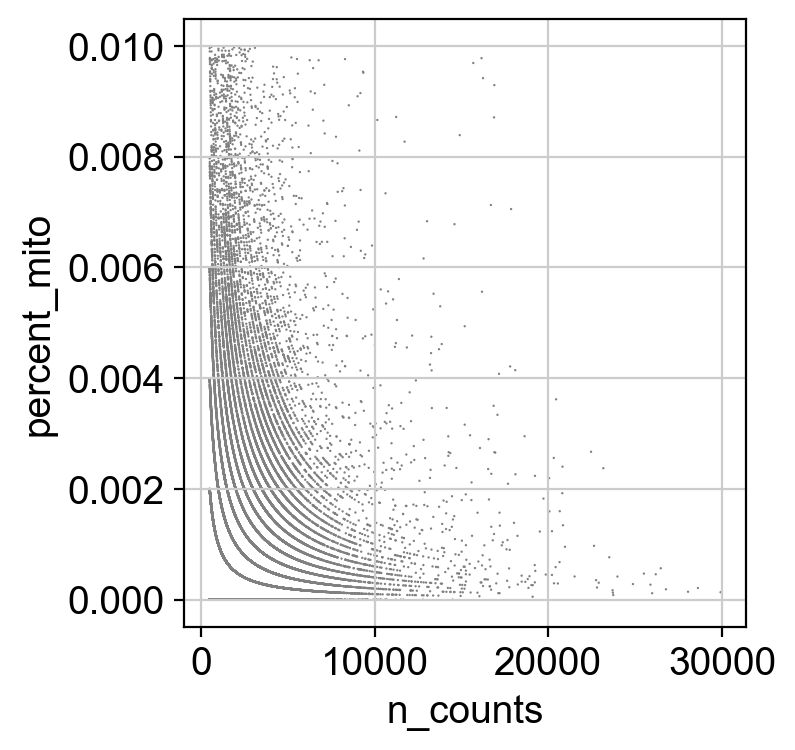

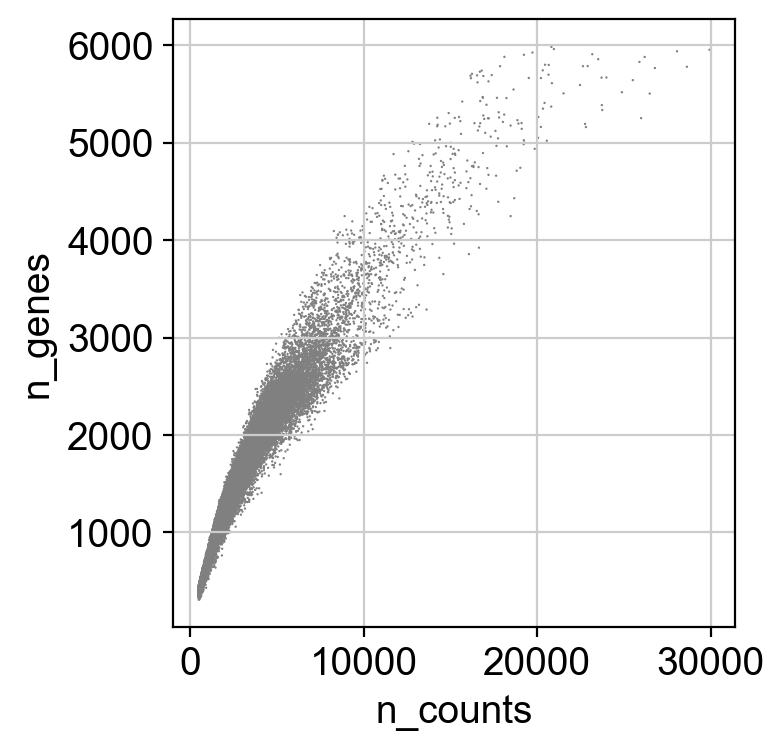

In [93]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [95]:
adata = adata[adata.obs['n_counts'] < 15000, :]

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [96]:
adata

View of AnnData object with n_obs × n_vars = 42150 × 24372
    obs: 'percent_mito', 'n_counts', 'Doublet', 'Doublet Score', 'batch', 'sample', 'n_genes'
    var: 'gene_ids', 'feature_types', 'n_cells'

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


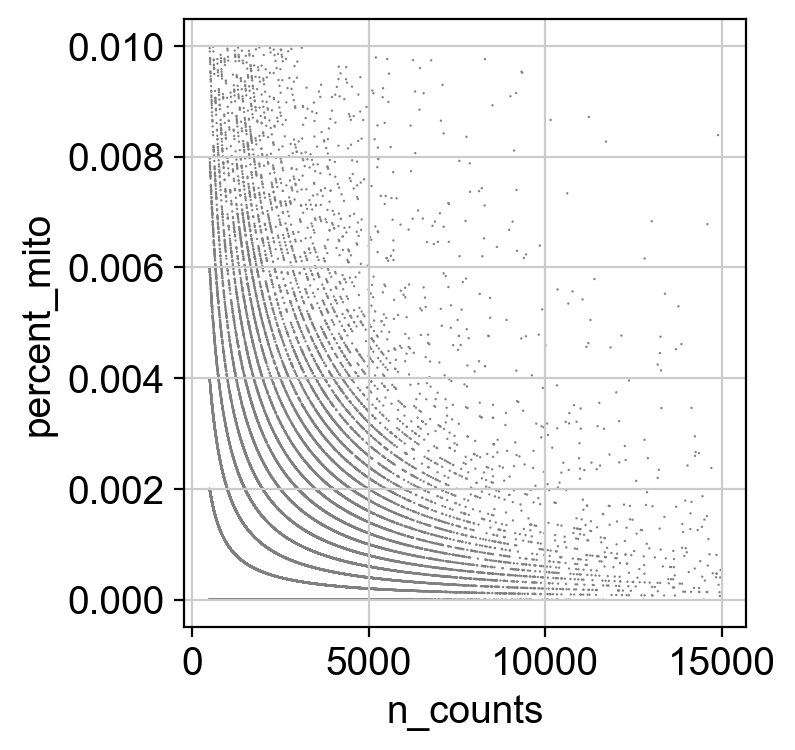

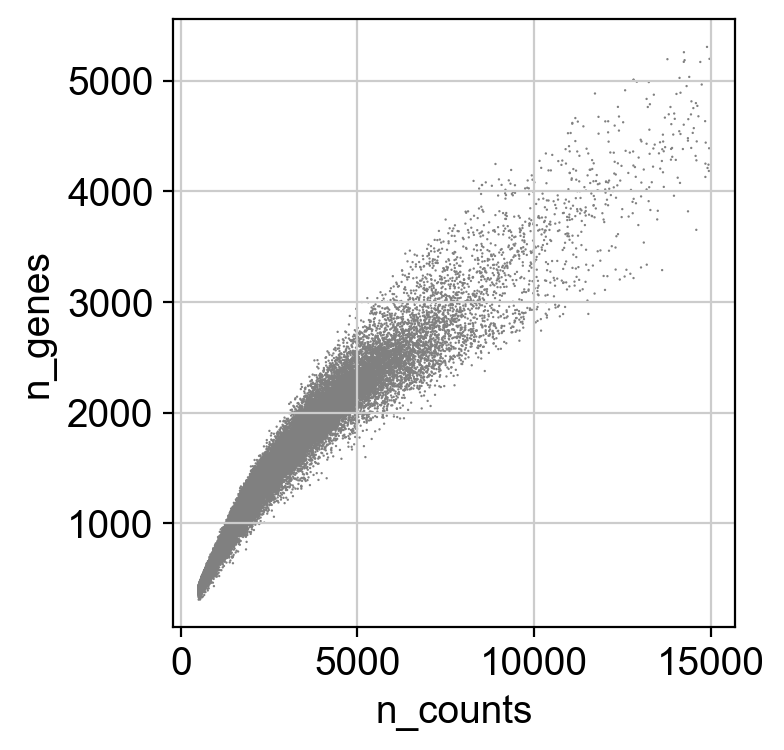

In [97]:
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

In [100]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [102]:
adata.raw = adata #store pre-scale counts

First analyze all ages collectively to establish `Class_broad` annotations and remove bad cells.

In [119]:
adata.X = adata.raw.X.A
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs

sc.pp.scale(adata, max_value=10) #scale
sc.tl.pca(adata, svd_solver='arpack') #run PCA

sc.pp.neighbors(adata, n_neighbors=25)
#bbknn(i, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
sc.tl.leiden(adata)
sc.tl.umap(adata)

extracting highly variable genes
    finished (0:00:13)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:17)
computing neighbors
    using 'X_pca' with n_pcs = 50


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:24)
running Leiden clustering
    finished: found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:42)


#remove 23, 7, 27, 25, 26 b/c doublets in terms of markers exp or no exp of any marker
#re-run analysis above after this removal
adata = adata[adata.obs.leiden!='23',:]
adata = adata[adata.obs.leiden!='7',:]
adata = adata[adata.obs.leiden!='27',:]
adata = adata[adata.obs.leiden!='25',:]
adata = adata[adata.obs.leiden!='26',:]
adata

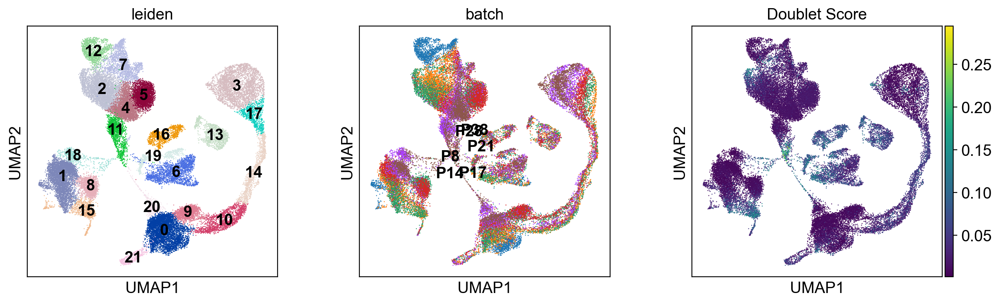

In [127]:
sc.pl.umap(adata, color=['leiden', 'batch', 'Doublet Score'], legend_loc='on data')

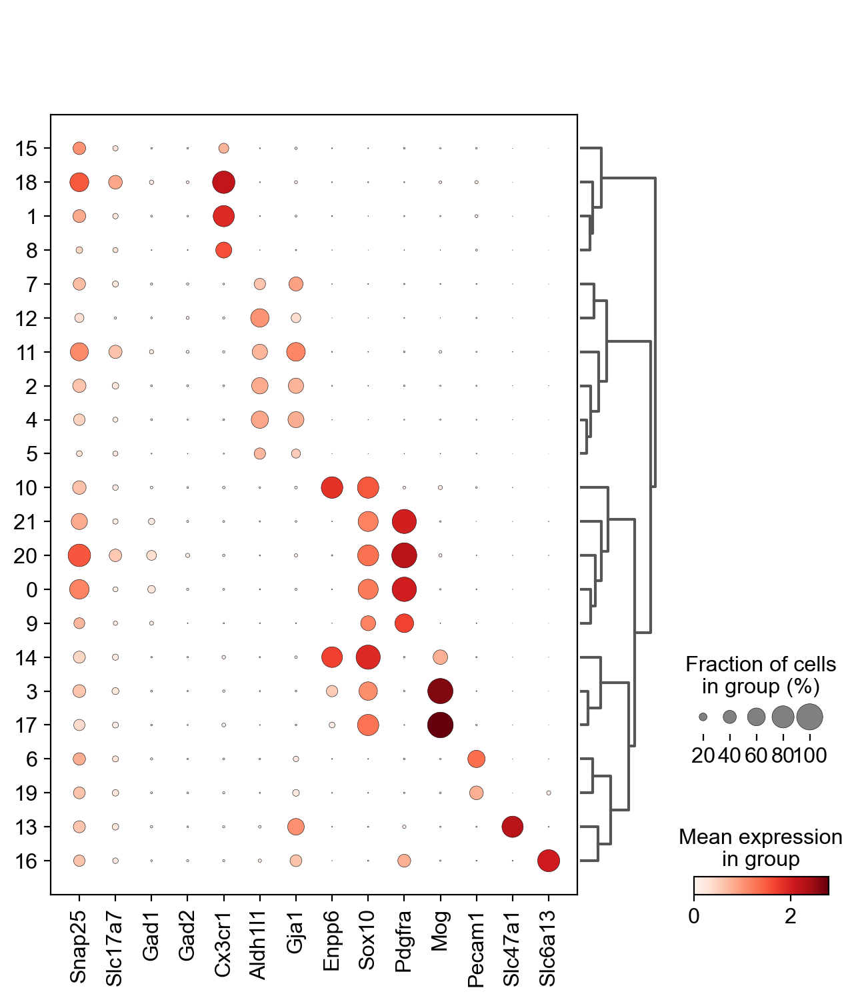

In [192]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2',
                  'Cx3cr1', 'Aldh1l1', 'Gja1', 'Enpp6','Sox10','Pdgfra', 
           'Mog', 'Pecam1', 'Slc47a1', 'Slc6a13']
#sc.tl.dendrogram(adata, groupby='leiden')
sc.pl.dotplot(adata, markers, groupby='leiden', dendrogram=True)

In [128]:
Class_broad = []
for i in range(adata.shape[0]):
    if (int(adata.obs['leiden'][i]) in (15, 18, 1, 8)): Class_broad.append('Microglia')
    elif (int(adata.obs['leiden'][i]) in (7, 12, 11, 2, 4, 5)): Class_broad.append('Astrocytes')
    elif (int(adata.obs['leiden'][i]) in (10, 14, 3, 17)): Class_broad.append('Oligodendrocytes')
    elif (int(adata.obs['leiden'][i]) in (21, 20, 0, 9)): Class_broad.append('OPCs')
    elif (int(adata.obs['leiden'][i]) in (6, 19)): Class_broad.append('Endothelial')
    elif (int(adata.obs['leiden'][i]) in (13, 16)): Class_broad.append('VLMCs')

In [129]:
adata.obs['Class_broad'] = adata.obs['leiden']
adata.obs['Class_broad'] = pd.Series(Class_broad, dtype='category').values

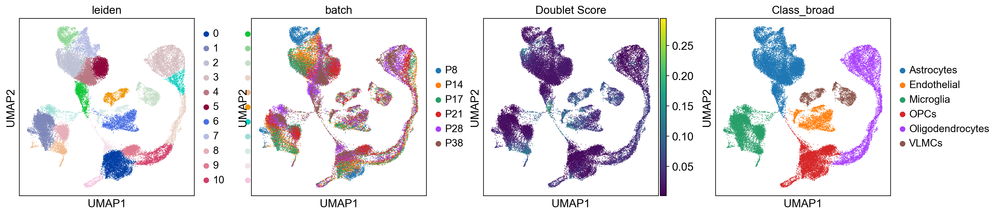

In [130]:
sc.pl.umap(adata, color=['leiden', 'batch', 'Doublet Score', 'Class_broad'])

# By age

Split up ages

In [141]:
P8 = adata[adata.obs.batch=='P8',:]
print(P8.shape)

P14 = adata[adata.obs.batch=='P14',:]
print(P14.shape)

P17 = adata[adata.obs.batch=='P17',:]
print(P17.shape)

P21 = adata[adata.obs.batch=='P21',:]
print(P21.shape)

P28 = adata[adata.obs.batch=='P28',:]
print(P28.shape)

P38 = adata[adata.obs.batch=='P38',:]
print(P38.shape)

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


(3116, 24372)
(8148, 24372)
(8745, 24372)
(7935, 24372)
(6525, 24372)
(5182, 24372)


Note that the numbers above change below once we discard bad clusters that don't express any markers.

Read in saved objects after kernel dies.

In [3]:

P8 = sc.read_h5ad(out_path + 'P8' + '_non_analyzed.h5ad')
P14 = sc.read_h5ad(out_path + 'P14' + '_non_analyzed.h5ad')
P17 = sc.read_h5ad(out_path + 'P17' + '_non_analyzed.h5ad')
P21 = sc.read_h5ad(out_path + 'P21' + '_non_analyzed.h5ad')
P28 = sc.read_h5ad(out_path + 'P28' + '_non_analyzed.h5ad')
P38 = sc.read_h5ad(out_path + 'P38' + '_non_analyzed.h5ad')

Analyze each age separately.

In [200]:
for i in [P8, P14, P17, P21, P28, P38]:

    del i.obsp
    del i.varm
    del i.obsm
    del i.uns


    i.X = i.raw.X
    sc.pp.highly_variable_genes(i, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs


    sc.pp.scale(i, max_value=10) #scale
    sc.tl.pca(i, svd_solver='arpack') #run PCA

    Z = harmonize(i.obsm['X_pca'], i.obs, batch_key = 'sample')
    i.obsm['X_harmony'] = Z

    sc.pp.neighbors(i, n_neighbors=25, use_rep='X_harmony')
    
    #sc.pp.neighbors(i, n_neighbors=25)
    #bbknn(i, batch_key='sample',neighbors_within_batch =6 ) #doesn't work
    sc.tl.leiden(i)
    sc.tl.umap(i)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 14 clust

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:05)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vecto

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:05)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
Reach convergence after 9 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:20)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:05)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
Reach convergence after 4 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:03)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
Reach convergence after 3 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with 

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:03)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
Reach convergence after 4 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


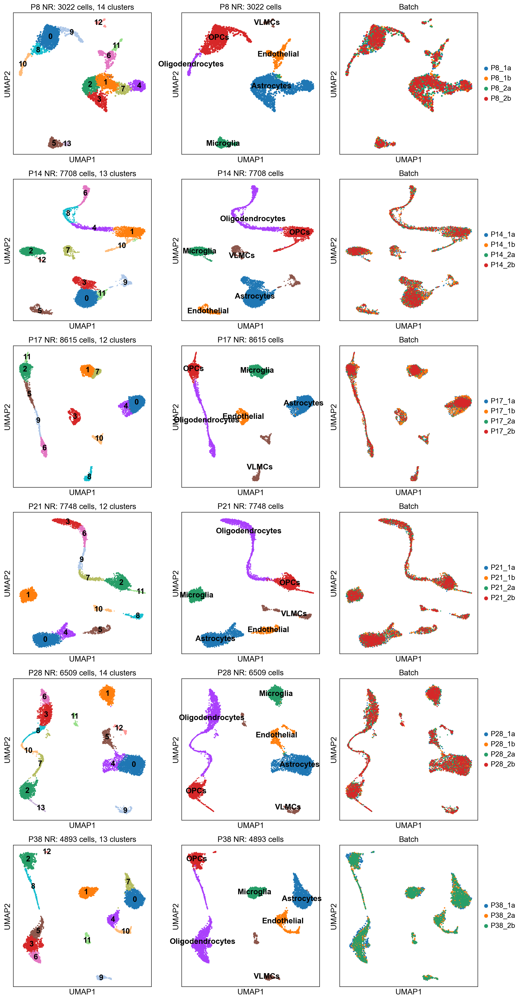

In [89]:
fig, axs = plt.subplots(6, 3, figsize = (13,25), constrained_layout=True)

age_idx = 0
column_idx = 0 
for obj in [P8, P14, P17, P21, P28, P38]:

    sc.pl.umap(obj, color='leiden', ax=axs[age_idx,column_idx], show=False, 
               title= str(obj.obs.batch[0]) + ' NR: ' + str(obj.shape[0]) + ' cells, ' + str(len(obj.obs.leiden.values.categories)) + ' clusters', 
               legend_loc='on data')
    column_idx = column_idx + 1
    
    sc.pl.umap(obj, color='Class_broad', ax=axs[age_idx,column_idx], show=False, 
               title= str(obj.obs.batch[0]) + ' NR: ' + str(obj.shape[0]) + ' cells', legend_loc='on data')
    column_idx = column_idx + 1

    sc.pl.umap(obj, color='sample', ax=axs[age_idx,column_idx], show=False, title='Batch')

    column_idx = column_idx + 1

    if (column_idx>=2): 
        age_idx = age_idx + 1
        column_idx = 0


## P8

P8 = P8[P8.obs.leiden!='13',:]

P8 = P8[P8.obs.leiden!='10',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


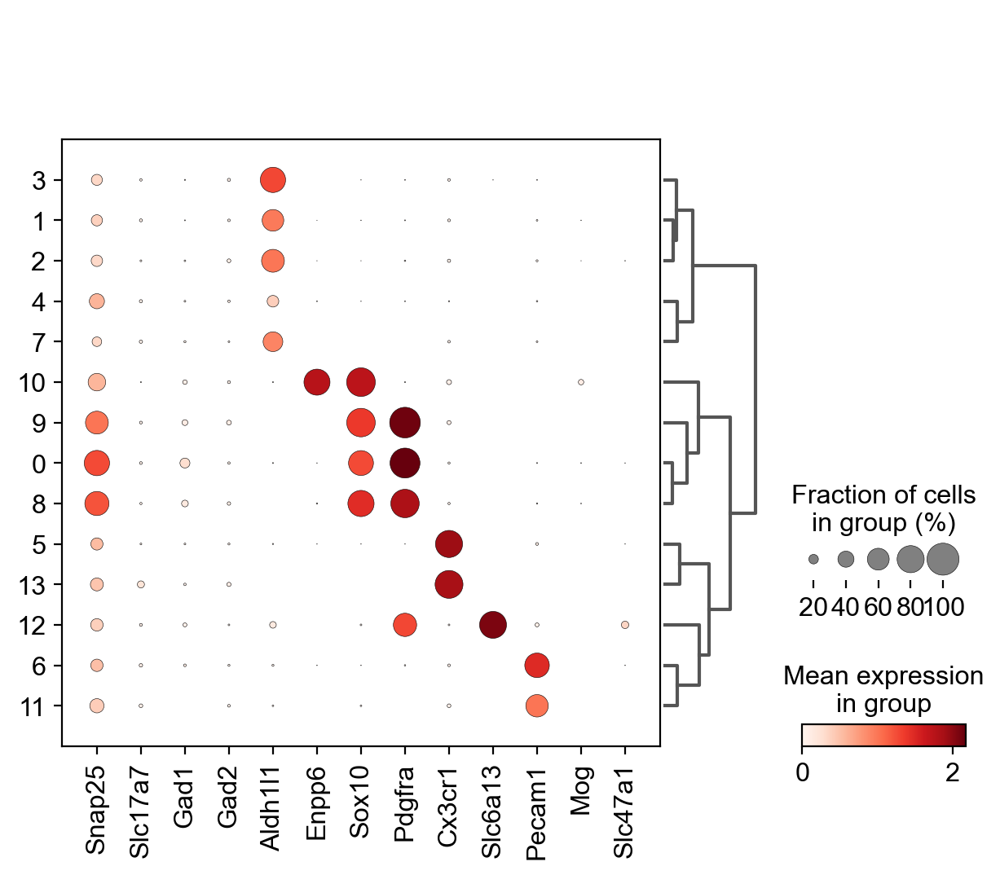

In [202]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2',
                  'Aldh1l1', 
                  'Enpp6',  
                  'Sox10', 'Pdgfra', 
                  'Cx3cr1',
                   'Slc6a13',
                  'Pecam1', 'Mog', 'Slc47a1',]
sc.tl.dendrogram(P8, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P8, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


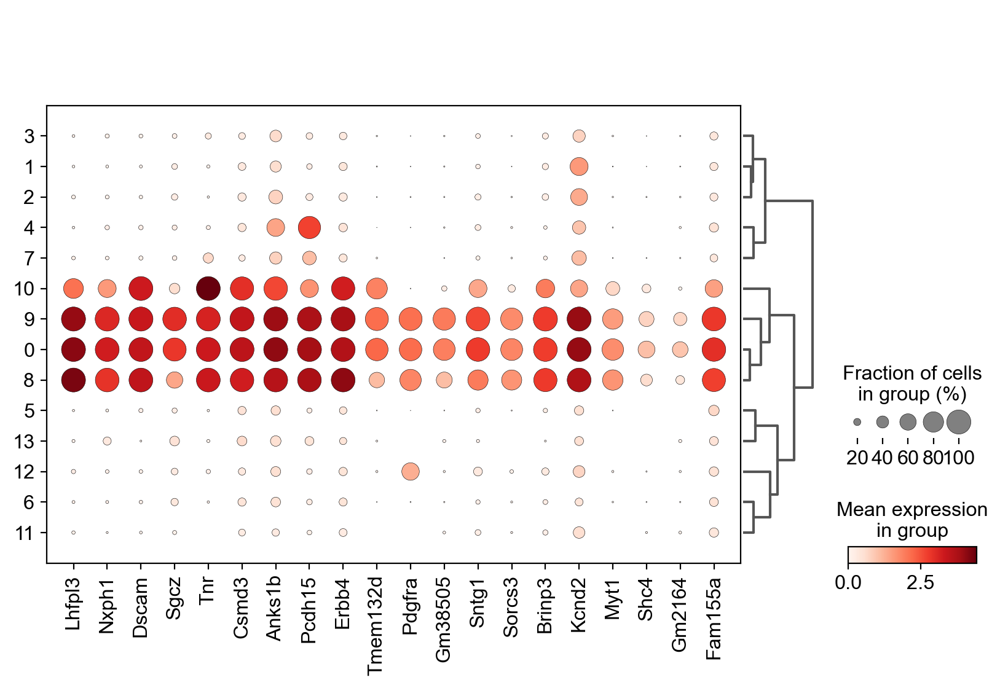

['Lhfpl3', 'Nxph1', 'Dscam', 'Sgcz', 'Tnr', 'Csmd3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


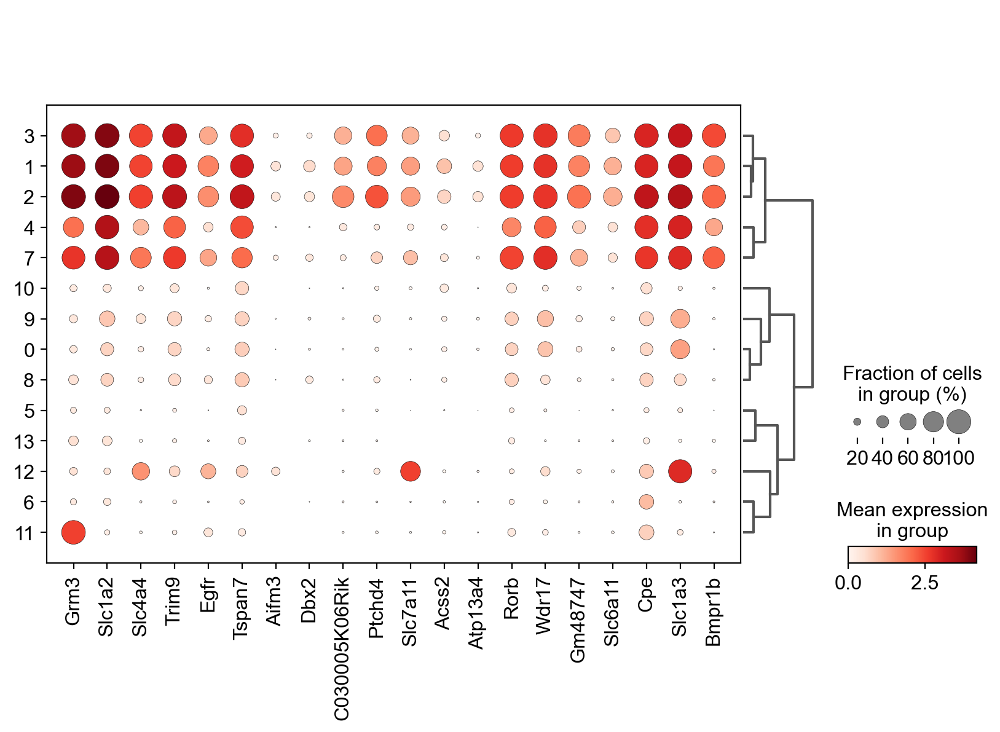

['Grm3', 'Slc1a2', 'Slc4a4', 'Trim9', 'Egfr', 'Tspan7']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


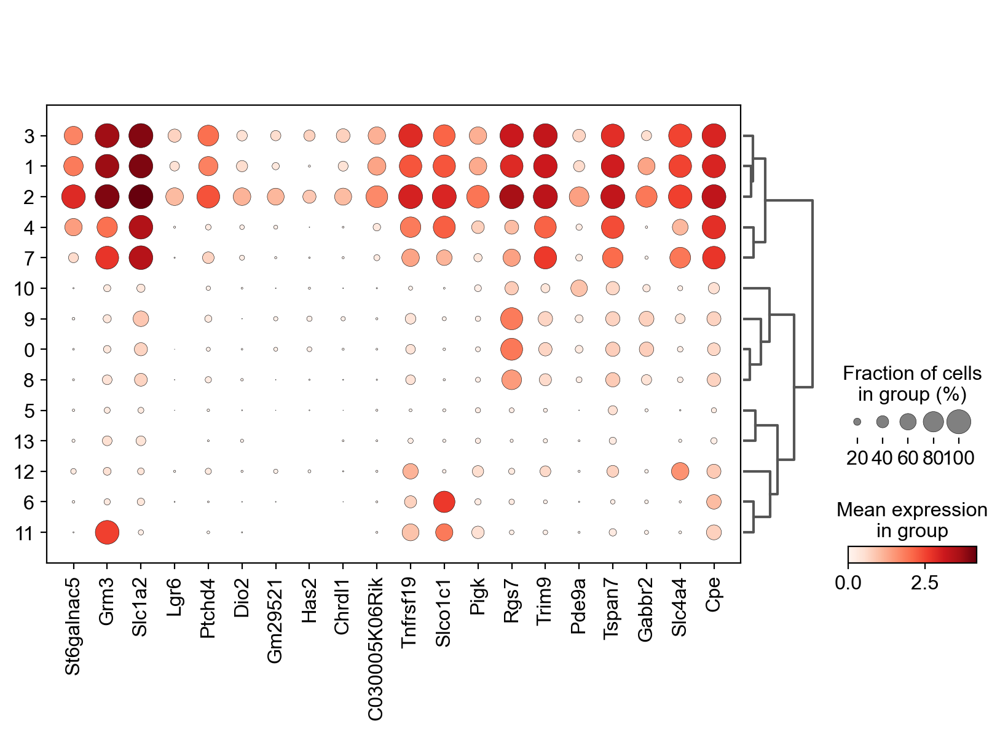

['St6galnac5', 'Grm3', 'Slc1a2', 'Lgr6', 'Ptchd4', 'Dio2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


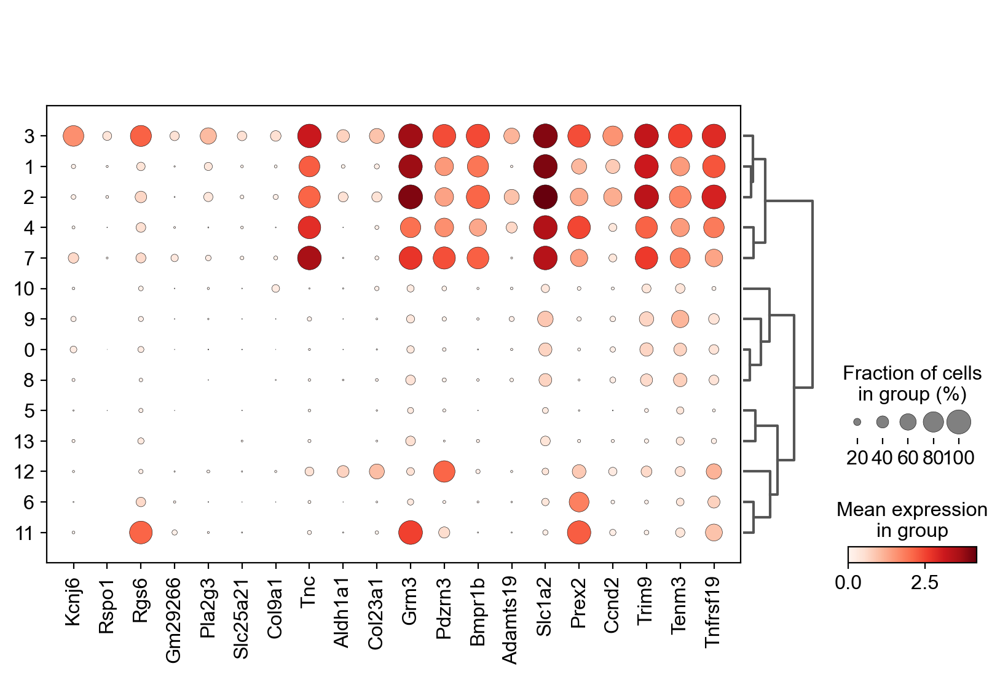

['Kcnj6', 'Rspo1', 'Rgs6', 'Gm29266', 'Pla2g3', 'Slc25a21']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


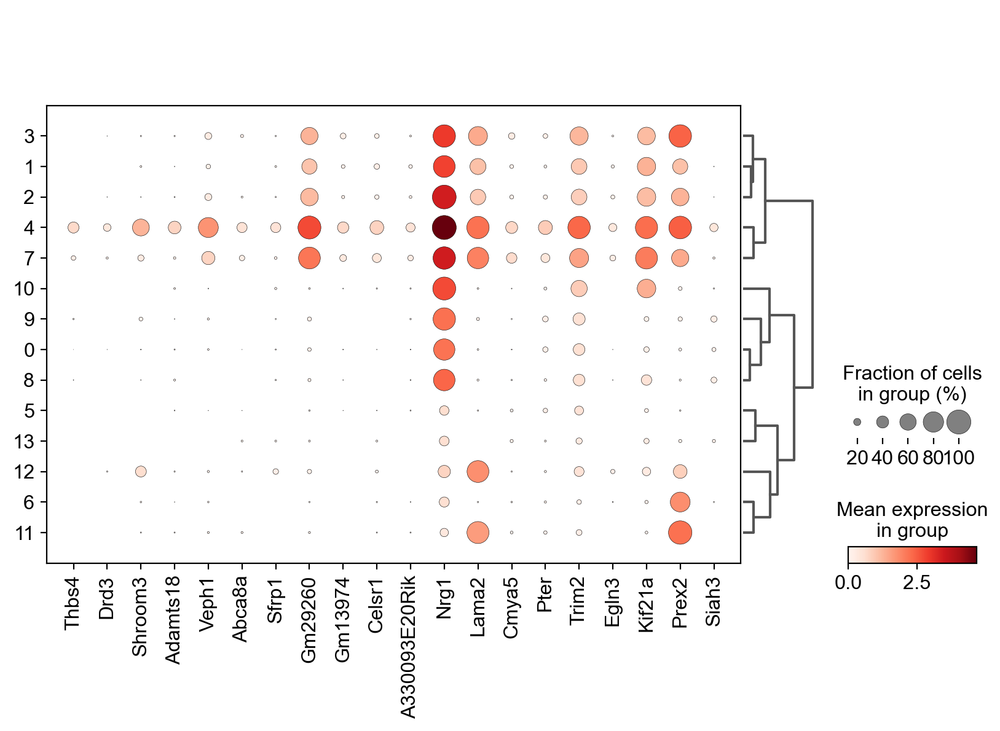

['Thbs4', 'Drd3', 'Shroom3', 'Adamts18', 'Veph1', 'Abca8a']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


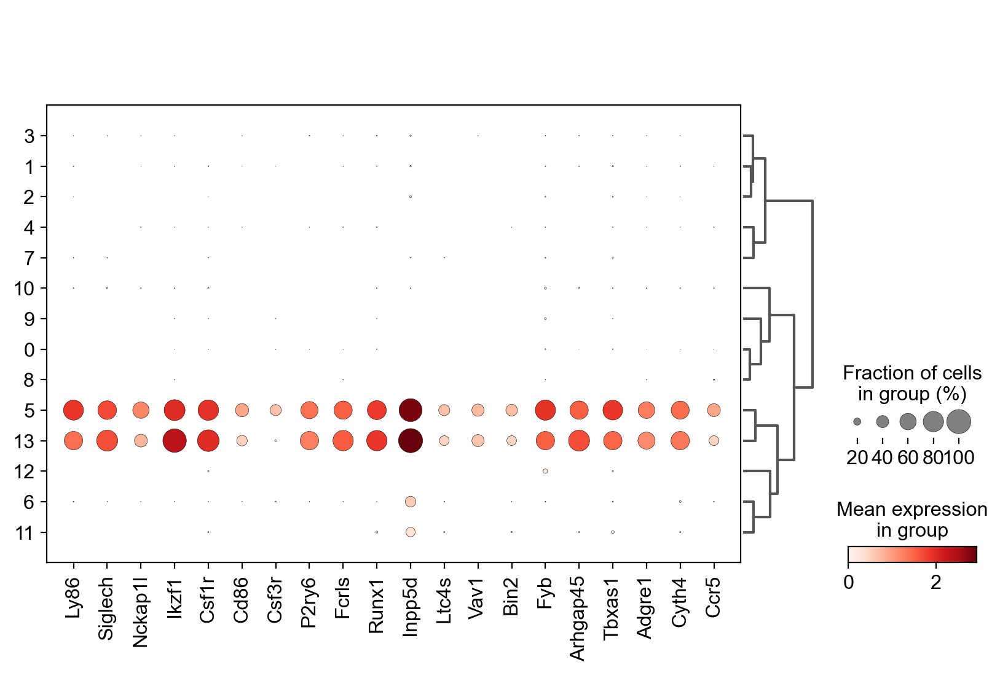

['Ly86', 'Siglech', 'Nckap1l', 'Ikzf1', 'Csf1r', 'Cd86']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


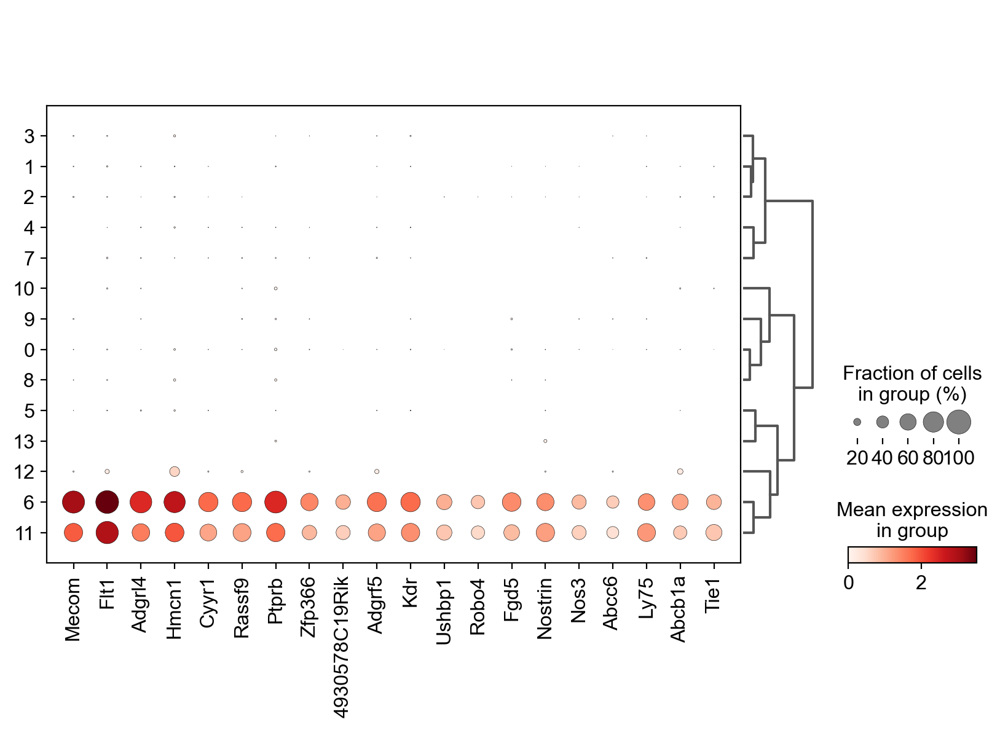

['Mecom', 'Flt1', 'Adgrl4', 'Hmcn1', 'Cyyr1', 'Rassf9']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


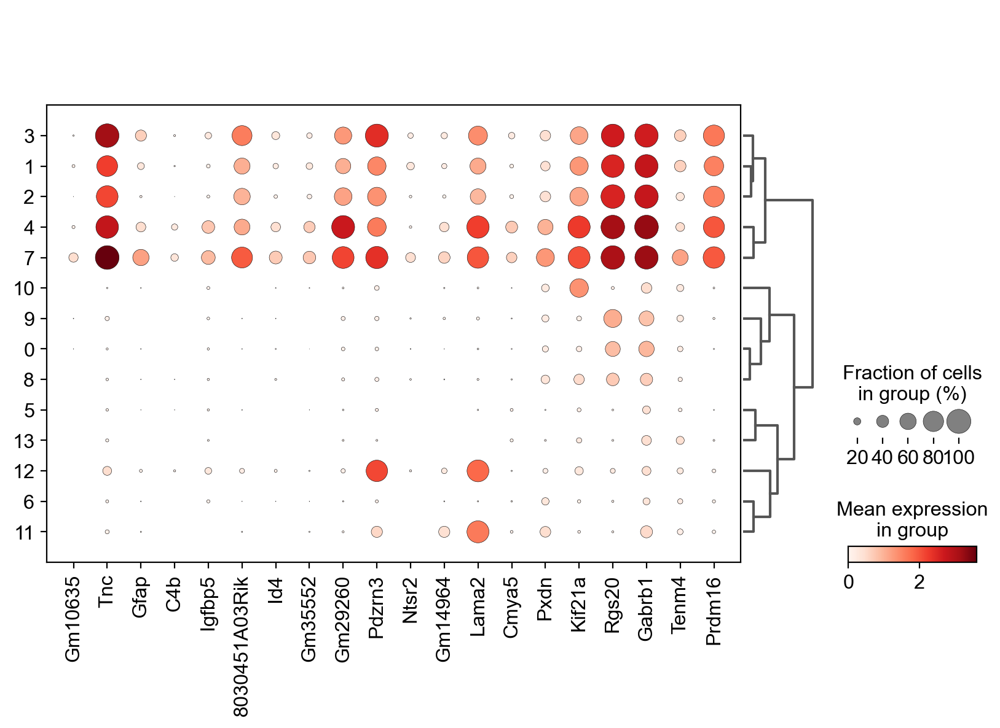

['Gm10635', 'Tnc', 'Gfap', 'C4b', 'Igfbp5', '8030451A03Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


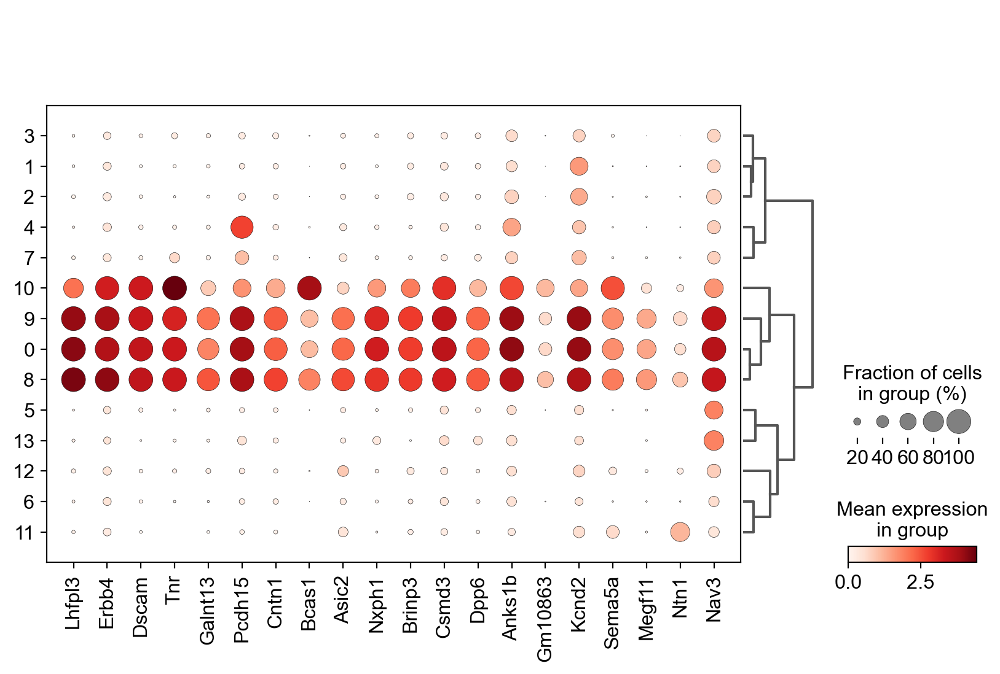

['Lhfpl3', 'Erbb4', 'Dscam', 'Tnr', 'Galnt13', 'Pcdh15']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


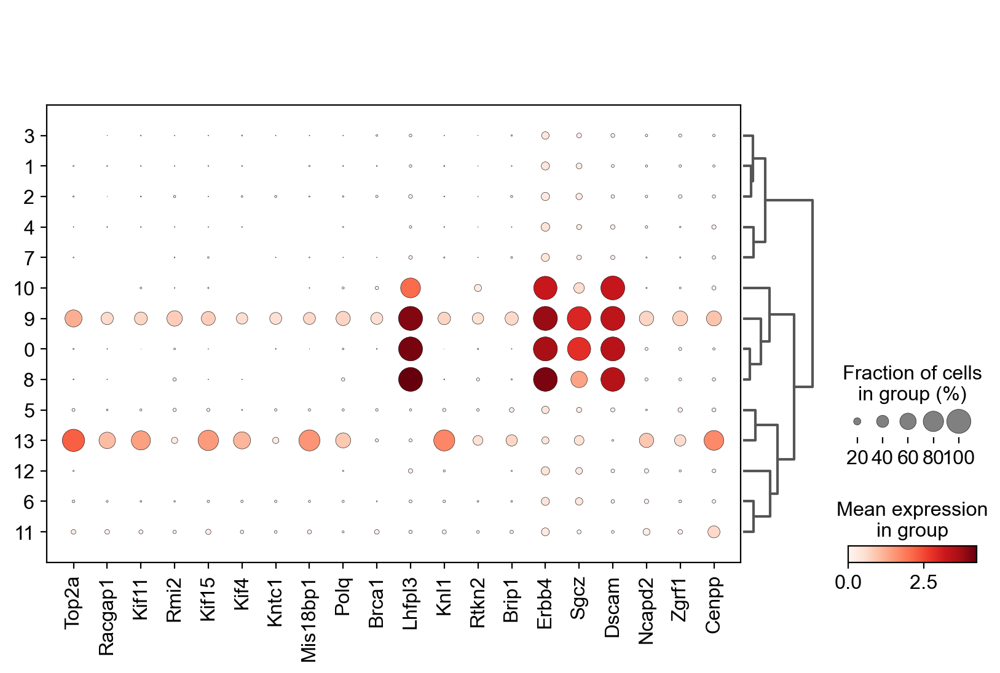

['Top2a', 'Racgap1', 'Kif11', 'Rmi2', 'Kif15', 'Kif4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


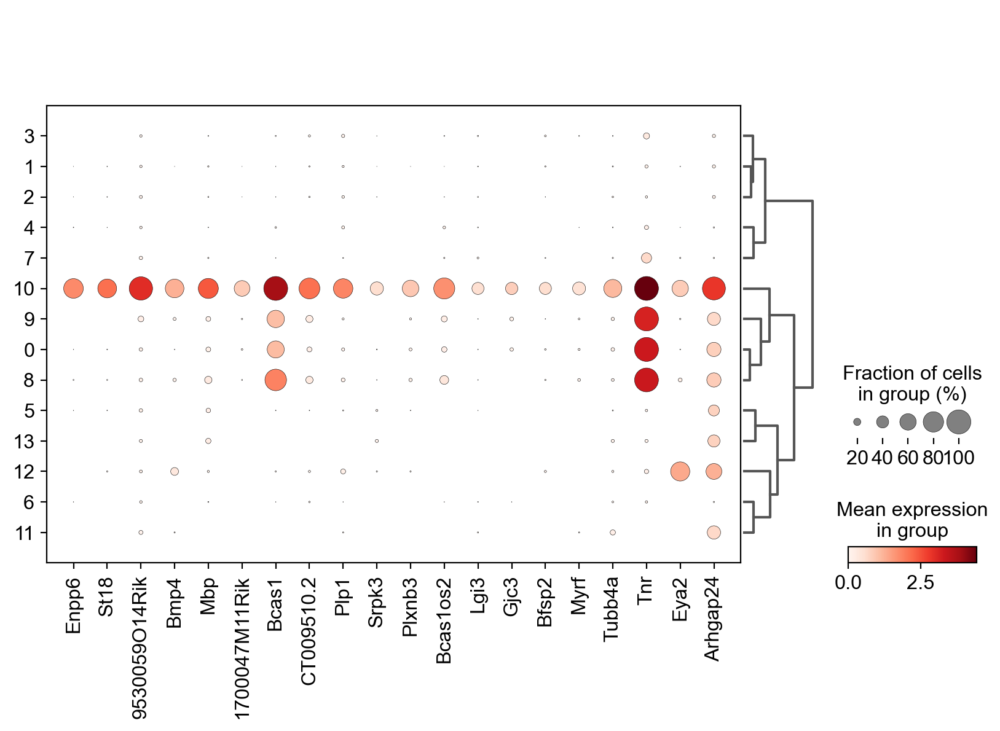

['Enpp6', 'St18', '9530059O14Rik', 'Bmp4', 'Mbp', '1700047M11Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


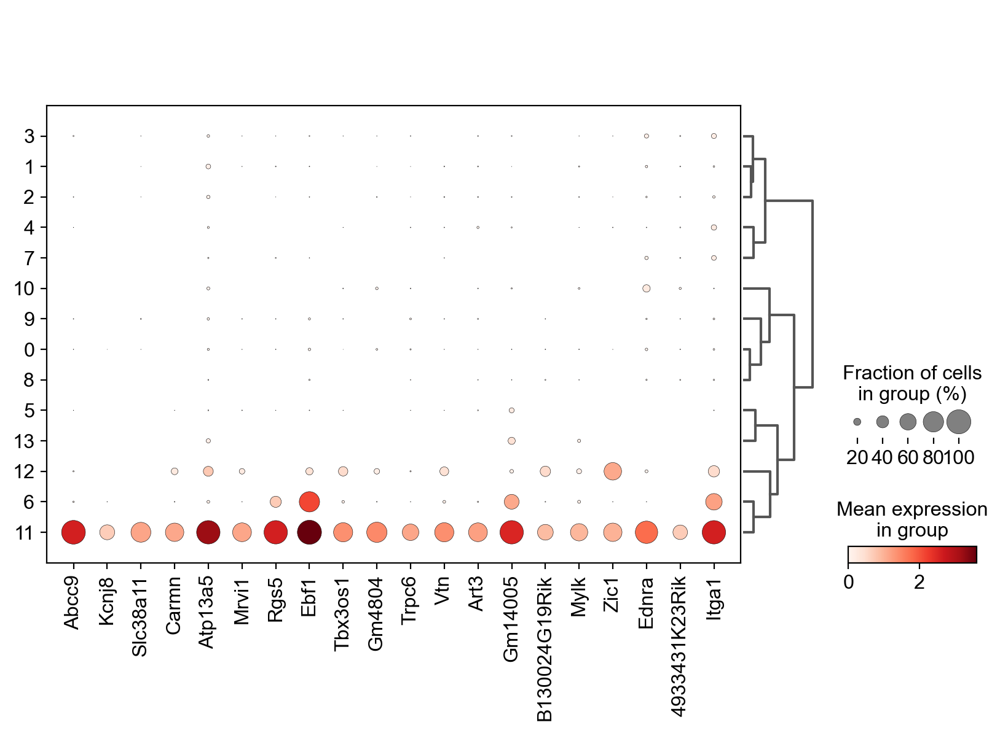

['Abcc9', 'Kcnj8', 'Slc38a11', 'Carmn', 'Atp13a5', 'Mrvi1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


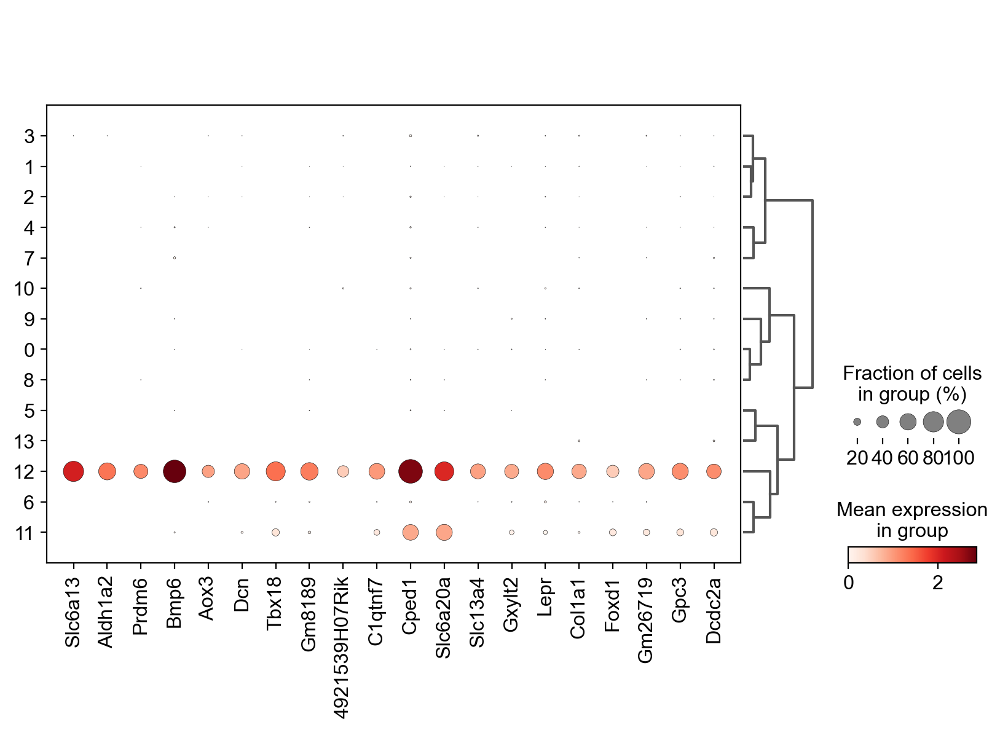

['Slc6a13', 'Aldh1a2', 'Prdm6', 'Bmp6', 'Aox3', 'Dcn']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


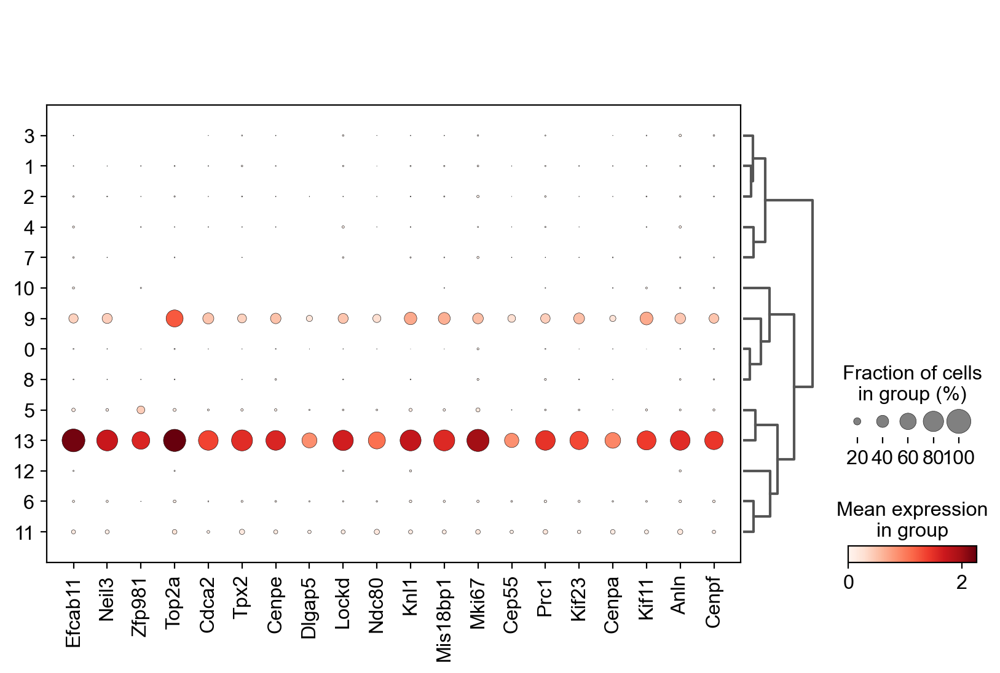

['Efcab11', 'Neil3', 'Zfp981', 'Top2a', 'Cdca2', 'Tpx2']


In [213]:
for i in P8.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P8, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P8.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P8.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P8.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P8.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P8, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

## P14

P14 = P14[P14.obs.leiden!='13',:]
P14 = P14[P14.obs.leiden!='6',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


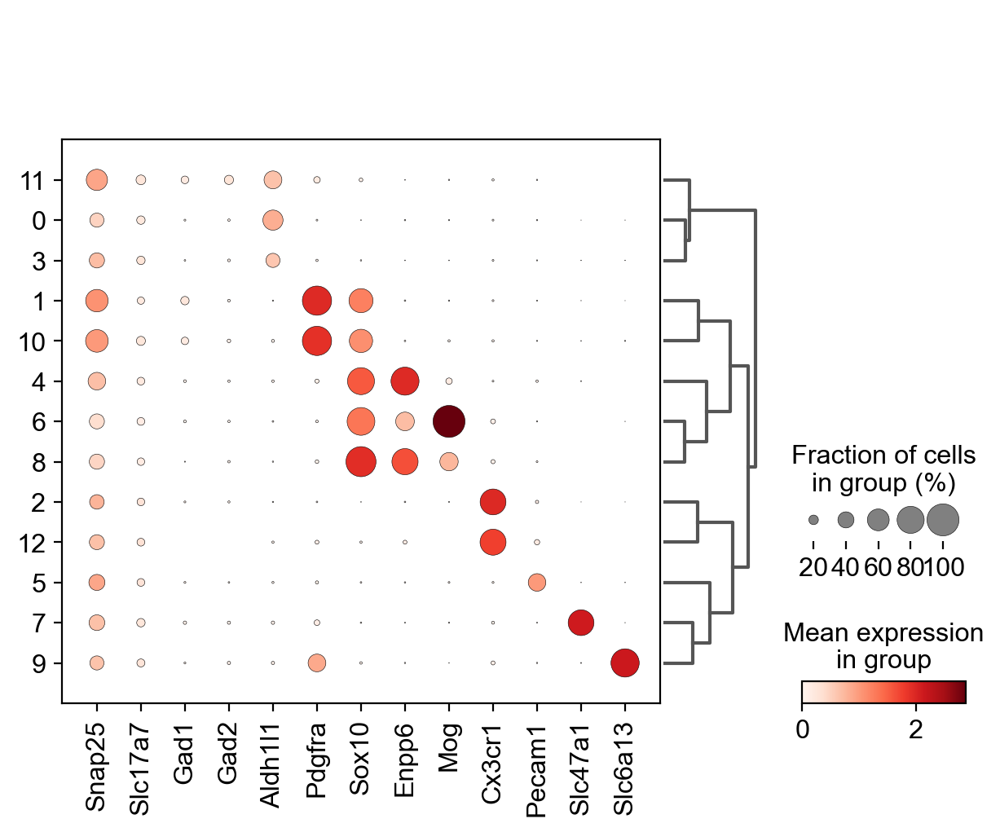

In [209]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2',
                  'Aldh1l1',  'Pdgfra', 'Sox10', 
                   'Enpp6','Mog',
            'Cx3cr1',
                   'Pecam1', 
                  'Slc47a1', 'Slc6a13' ]

sc.tl.dendrogram(P14, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P14, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


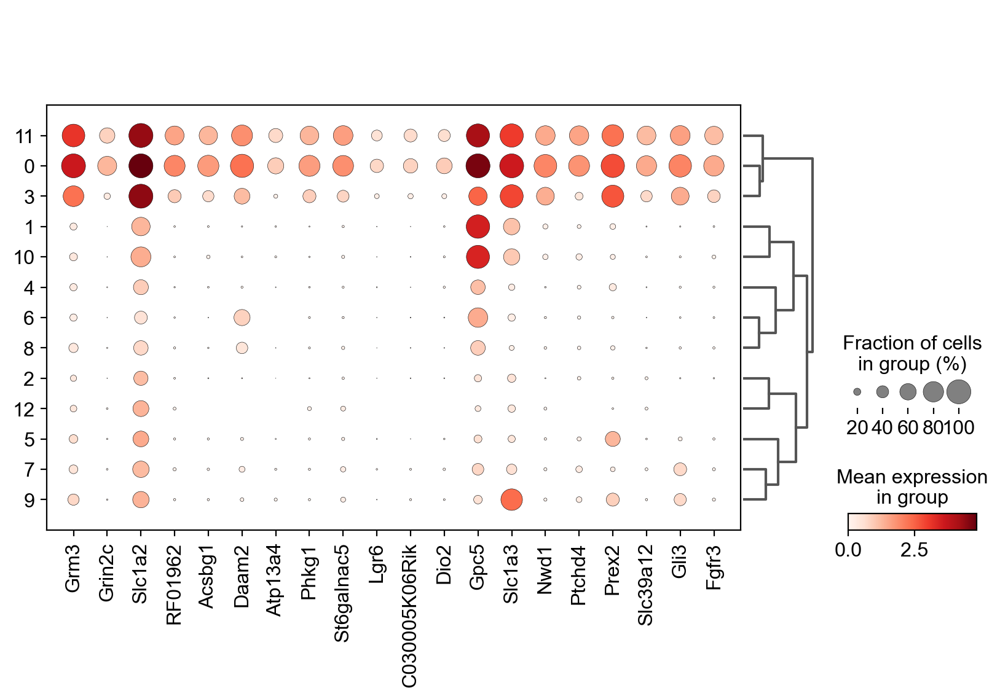

['Grm3', 'Grin2c', 'Slc1a2', 'RF01962', 'Acsbg1', 'Daam2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


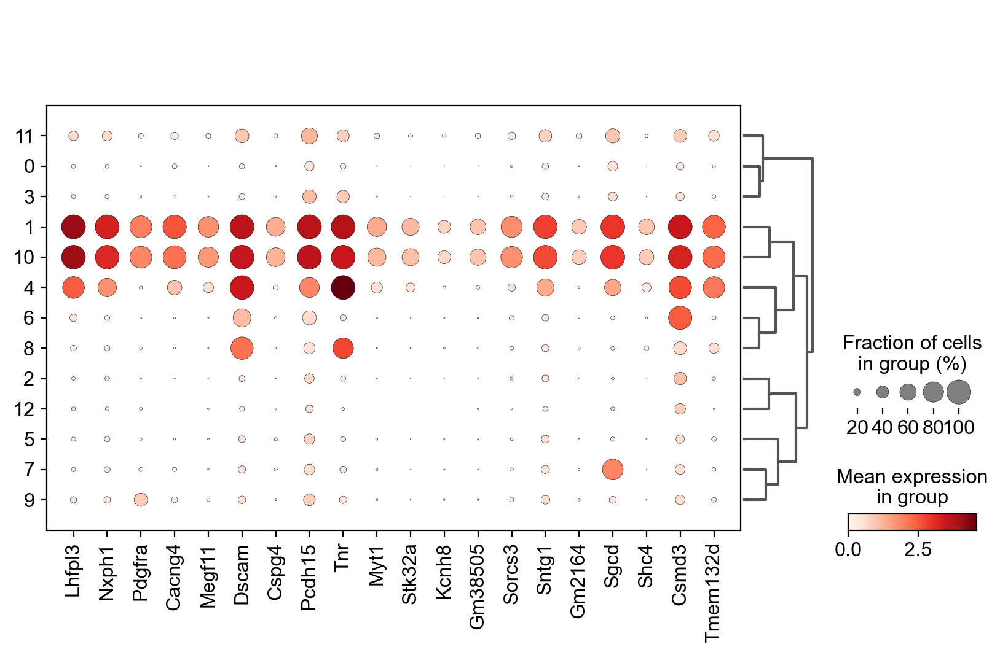

['Lhfpl3', 'Nxph1', 'Pdgfra', 'Cacng4', 'Megf11', 'Dscam']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


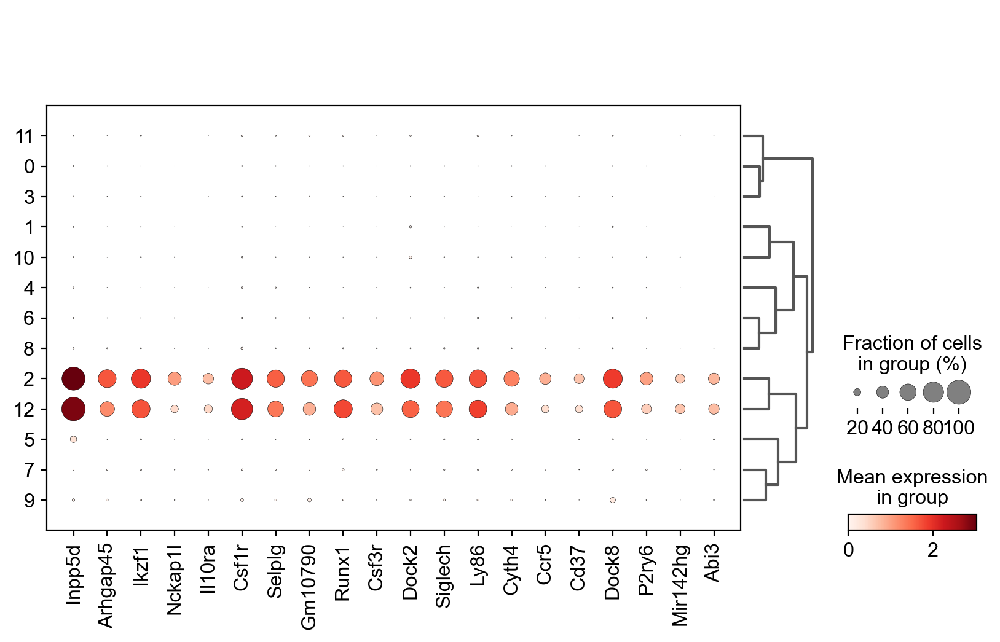

['Inpp5d', 'Arhgap45', 'Ikzf1', 'Nckap1l', 'Il10ra', 'Csf1r']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


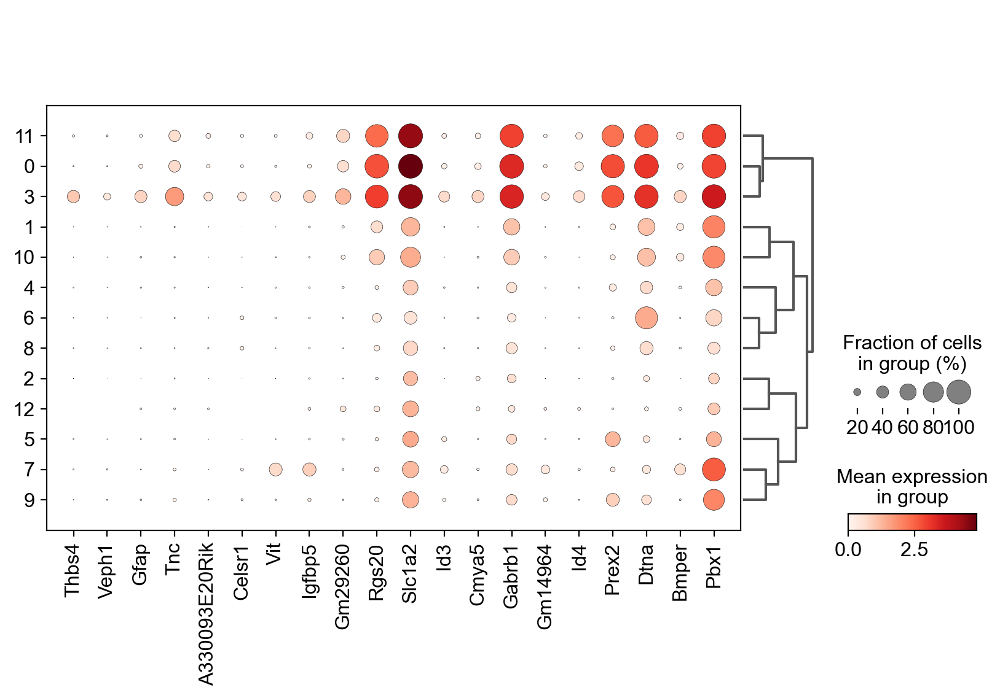

['Thbs4', 'Veph1', 'Gfap', 'Tnc', 'A330093E20Rik', 'Celsr1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


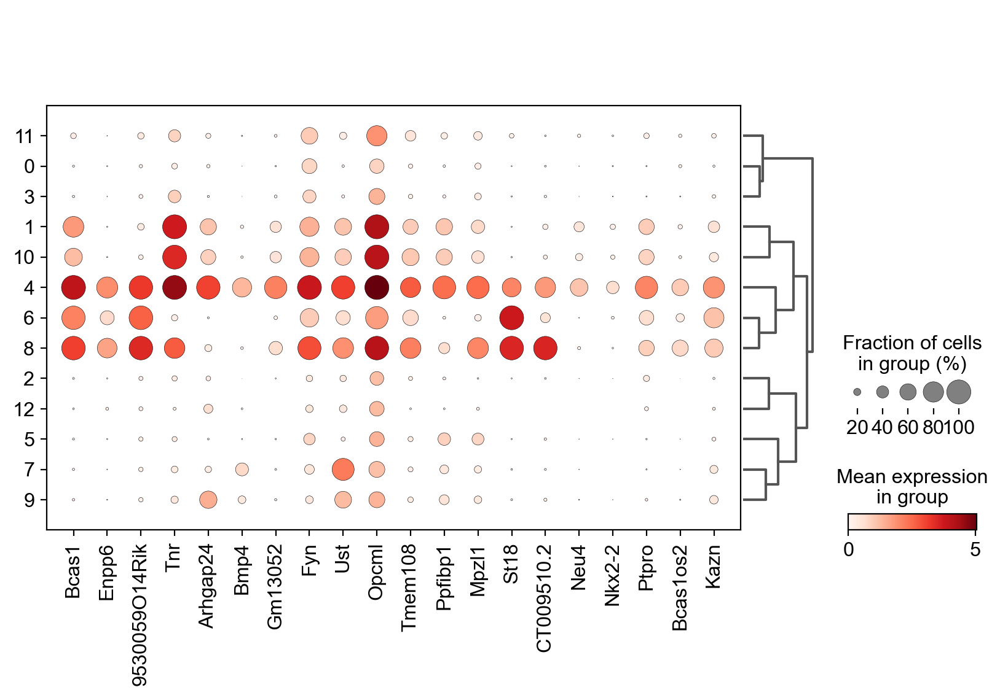

['Bcas1', 'Enpp6', '9530059O14Rik', 'Tnr', 'Arhgap24', 'Bmp4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


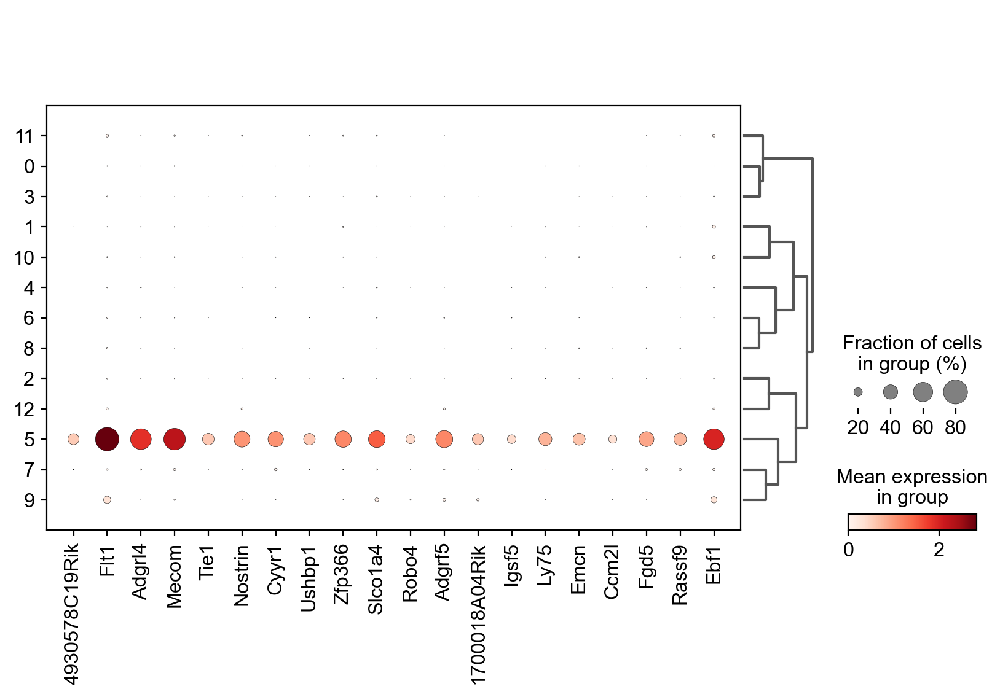

['4930578C19Rik', 'Flt1', 'Adgrl4', 'Mecom', 'Tie1', 'Nostrin']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


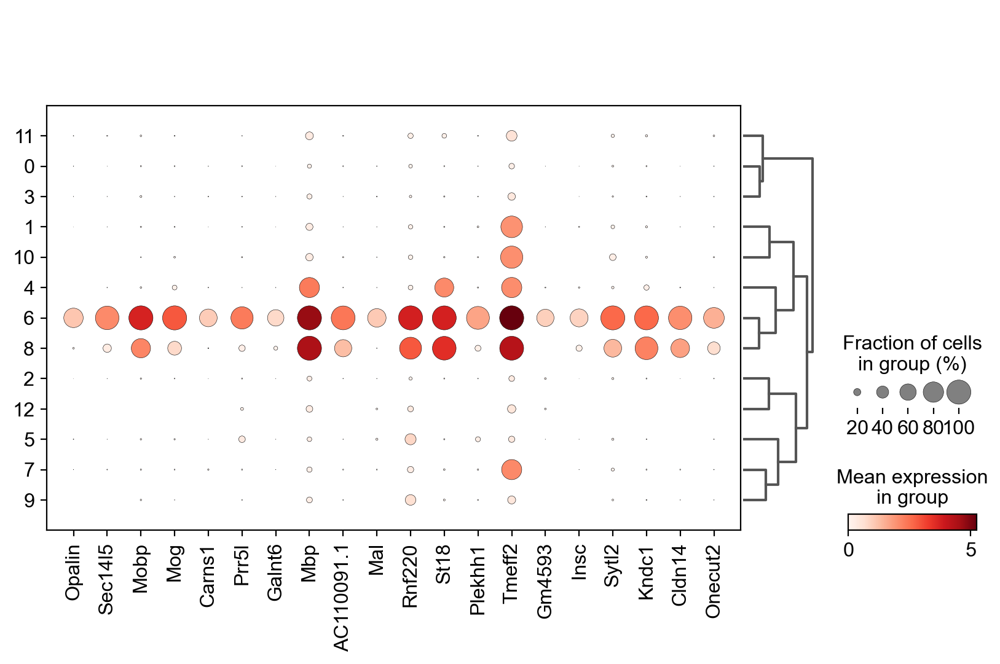

['Opalin', 'Sec14l5', 'Mobp', 'Mog', 'Carns1', 'Prr5l']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


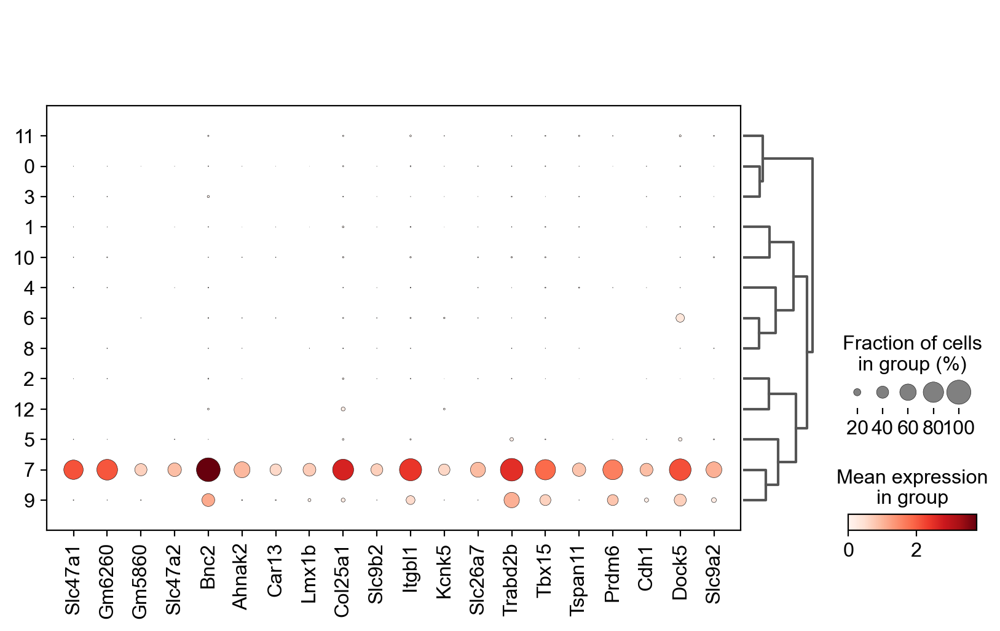

['Slc47a1', 'Gm6260', 'Gm5860', 'Slc47a2', 'Bnc2', 'Ahnak2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


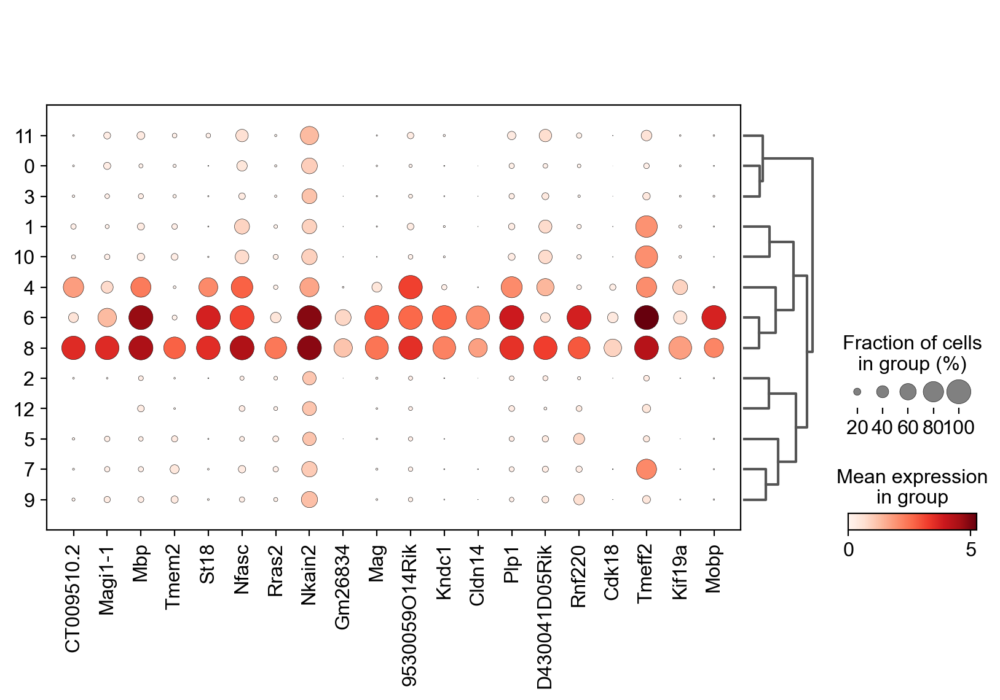

['CT009510.2', 'Magi1-1', 'Mbp', 'Tmem2', 'St18', 'Nfasc']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


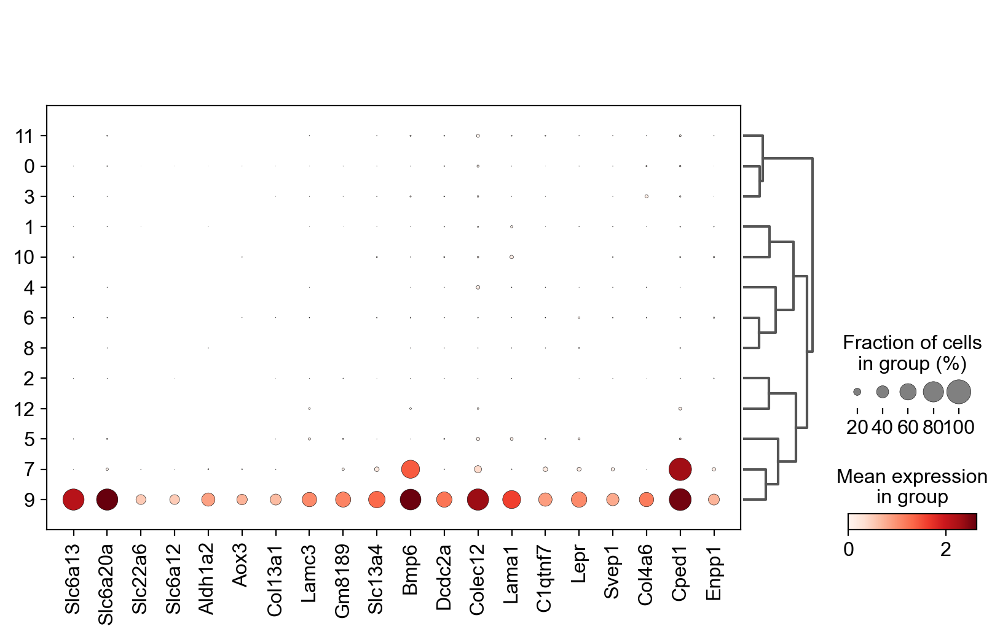

['Slc6a13', 'Slc6a20a', 'Slc22a6', 'Slc6a12', 'Aldh1a2', 'Aox3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


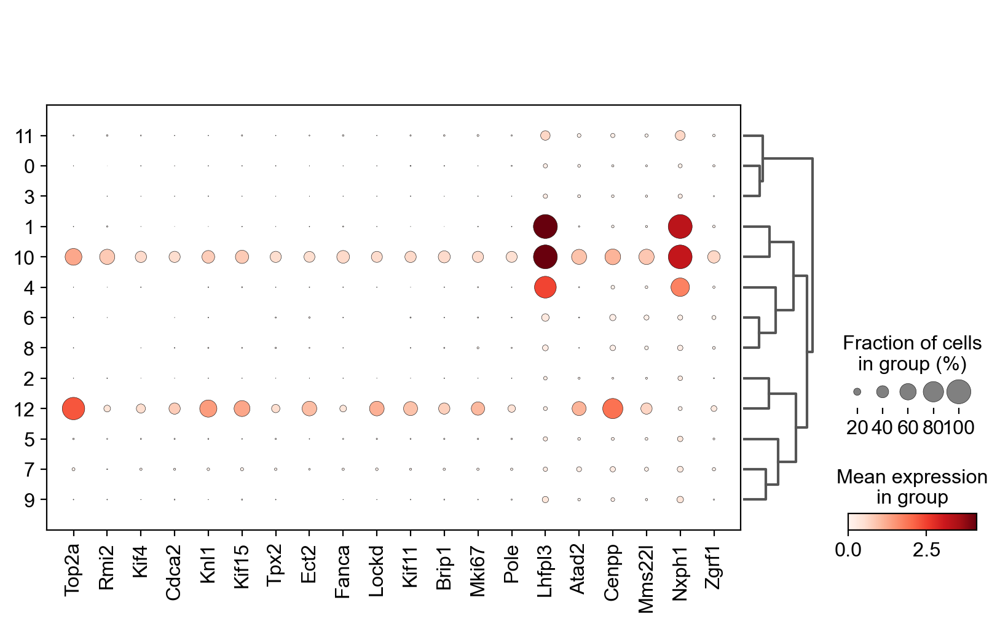

['Top2a', 'Rmi2', 'Kif4', 'Cdca2', 'Knl1', 'Kif15']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


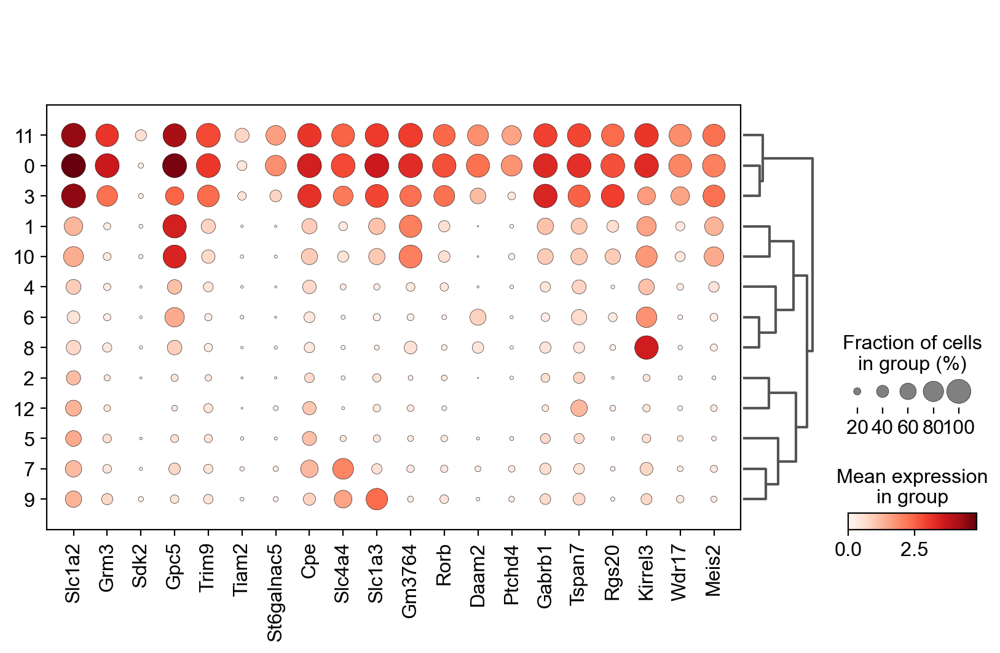

['Slc1a2', 'Grm3', 'Sdk2', 'Gpc5', 'Trim9', 'Tiam2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


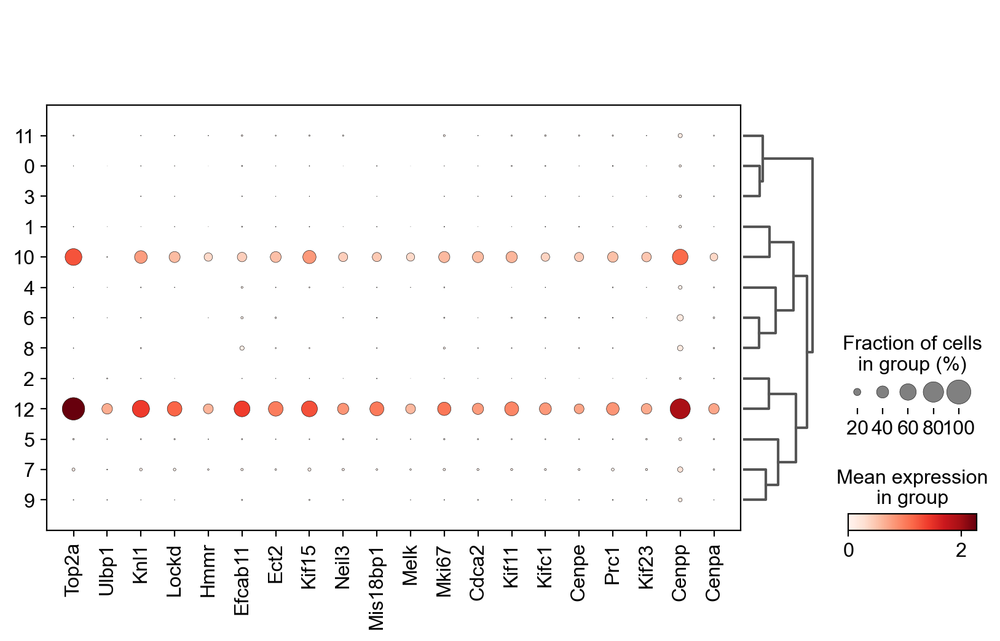

['Top2a', 'Ulbp1', 'Knl1', 'Lockd', 'Hmmr', 'Efcab11']


In [214]:
for i in P14.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P14, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P14.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P14.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P14.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P14.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P14, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

## P17

P17 = P17[P17.obs.leiden!='13',:]
P17 = P17[P17.obs.leiden!='11',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


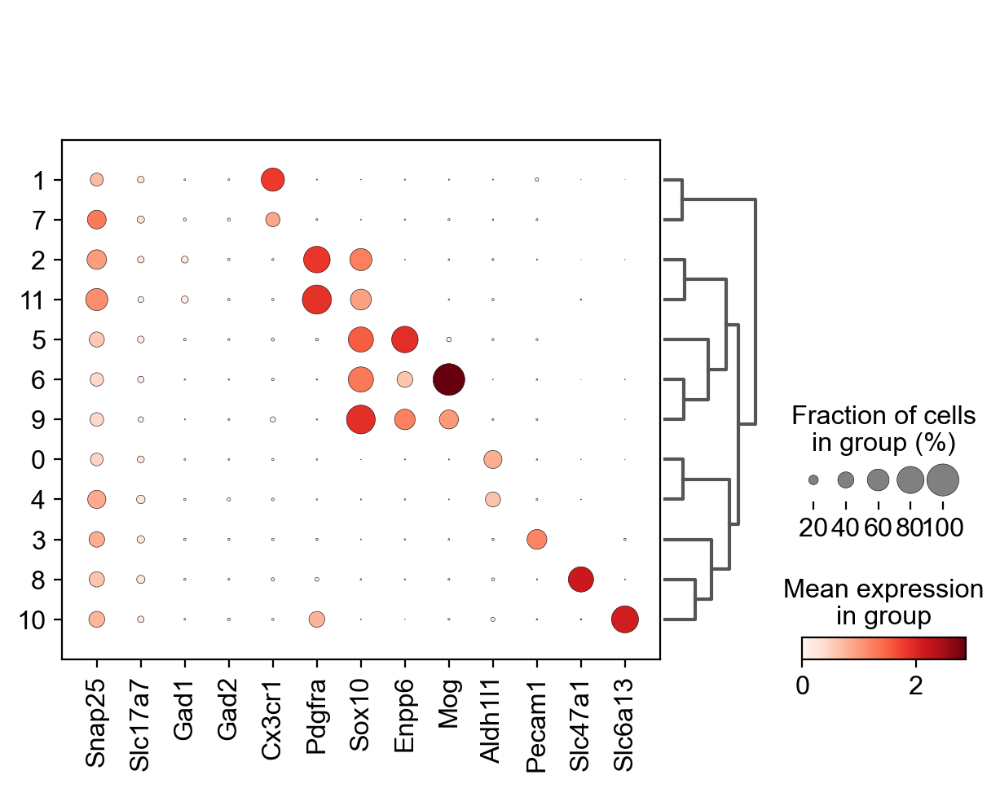

In [210]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2',
                  
                  'Cx3cr1', 
                   'Pdgfra', 'Sox10', 
                  'Enpp6', 'Mog', 'Aldh1l1', 'Pecam1', 'Slc47a1', 'Slc6a13',
                  ]
sc.tl.dendrogram(P17, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P17, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


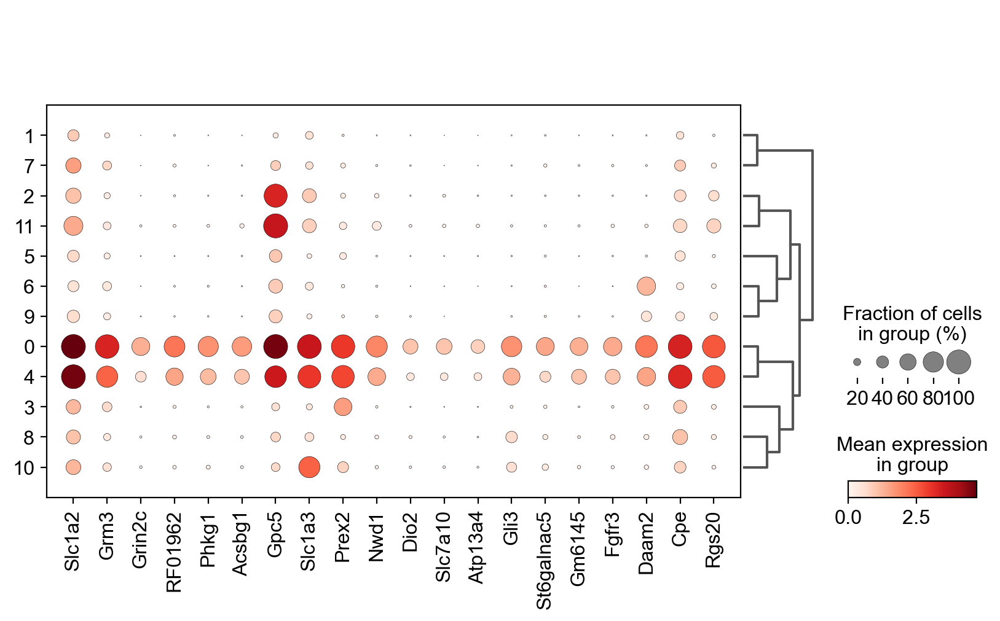

['Slc1a2', 'Grm3', 'Grin2c', 'RF01962', 'Phkg1', 'Acsbg1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


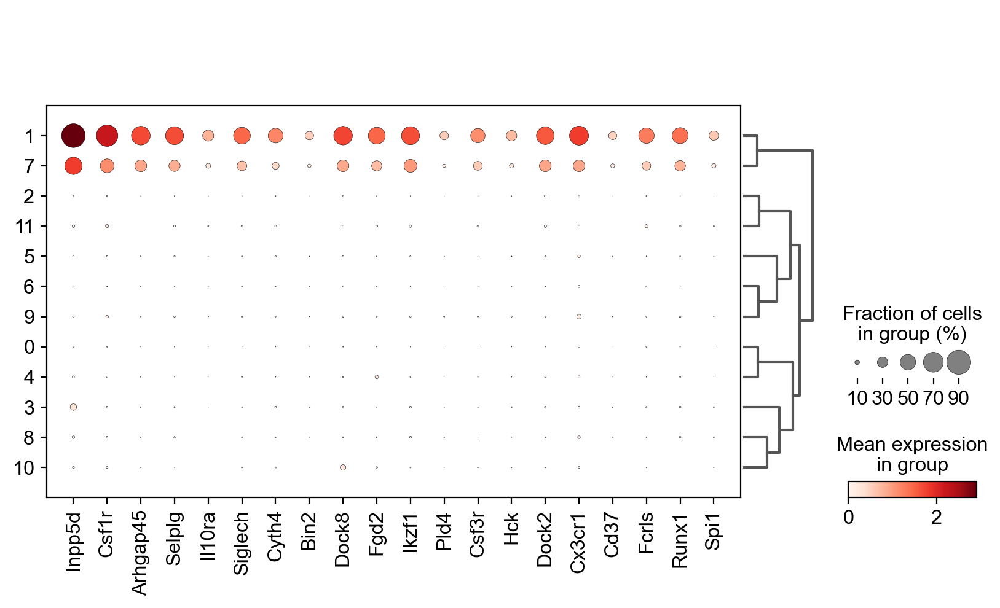

['Inpp5d', 'Csf1r', 'Arhgap45', 'Selplg', 'Il10ra', 'Siglech']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


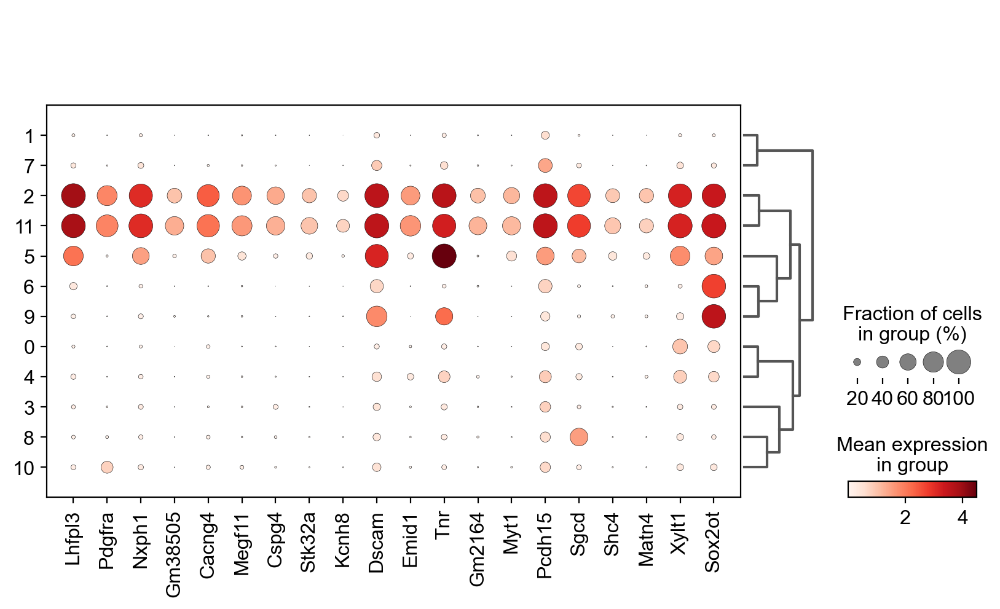

['Lhfpl3', 'Pdgfra', 'Nxph1', 'Gm38505', 'Cacng4', 'Megf11']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


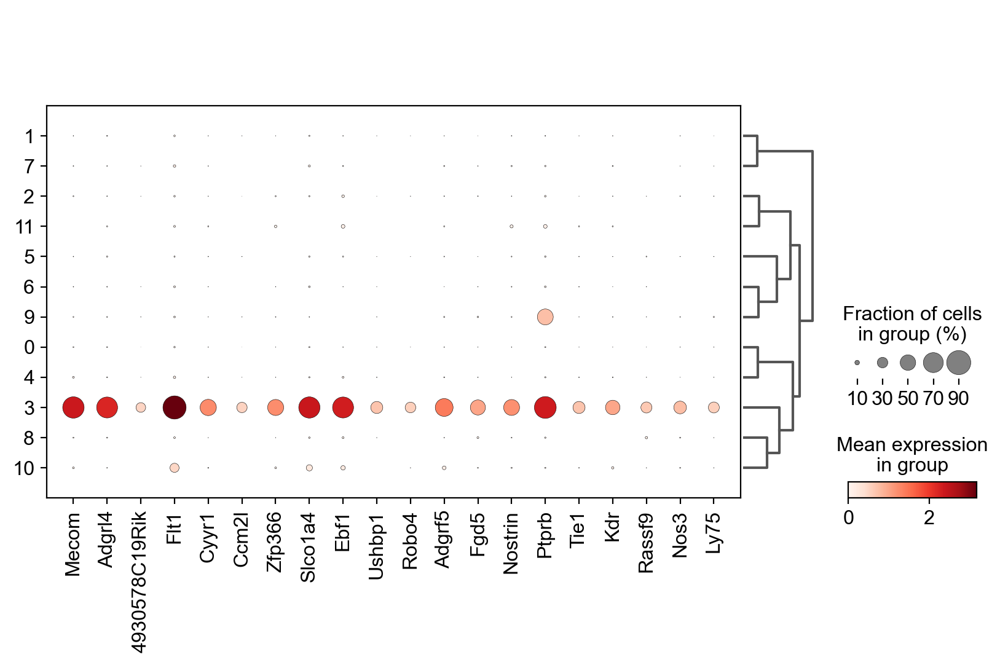

['Mecom', 'Adgrl4', '4930578C19Rik', 'Flt1', 'Cyyr1', 'Ccm2l']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


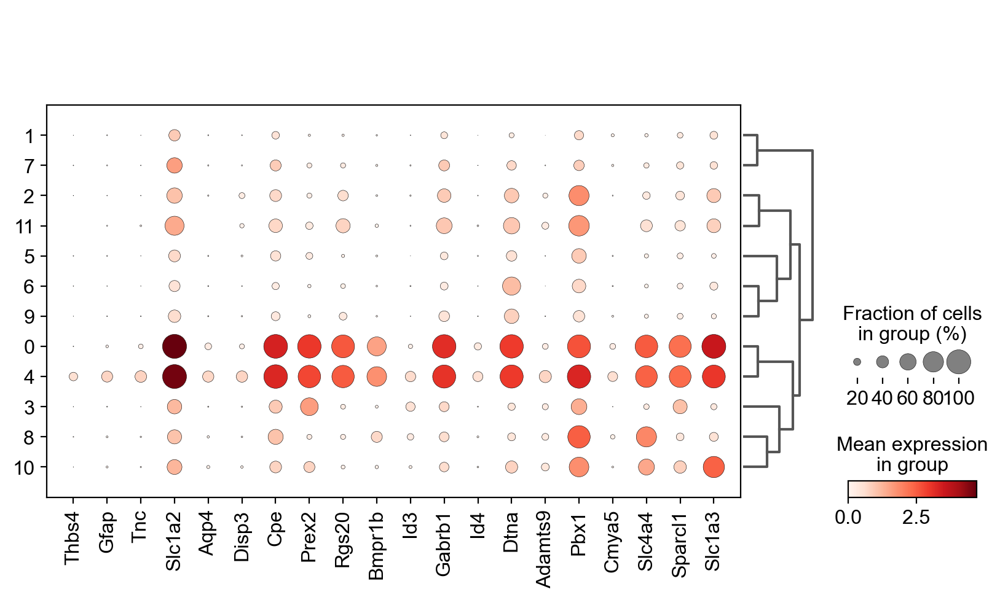

['Thbs4', 'Gfap', 'Tnc', 'Slc1a2', 'Aqp4', 'Disp3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


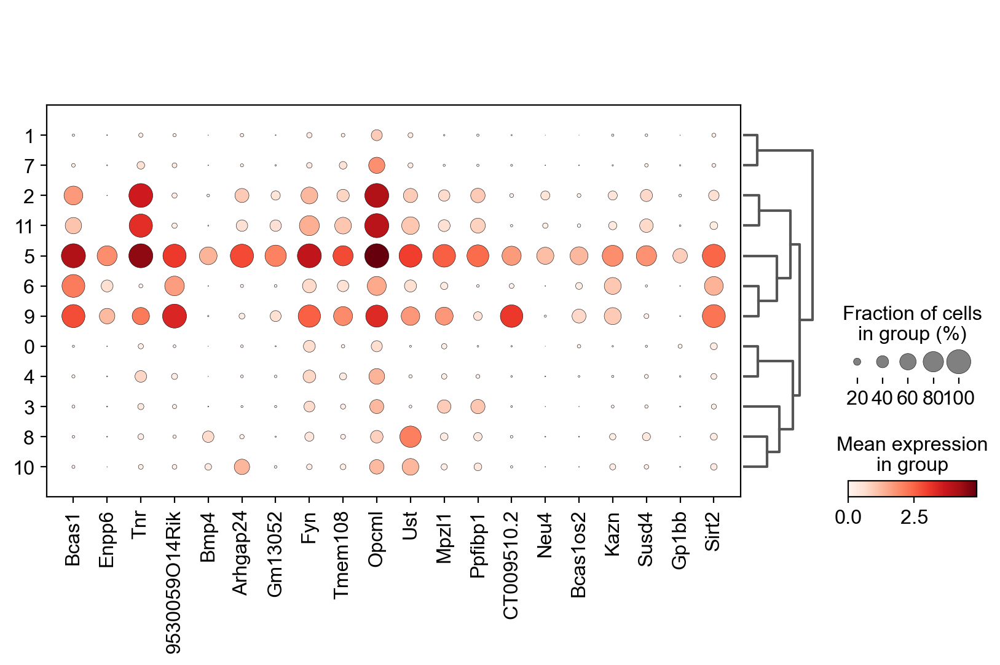

['Bcas1', 'Enpp6', 'Tnr', '9530059O14Rik', 'Bmp4', 'Arhgap24']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


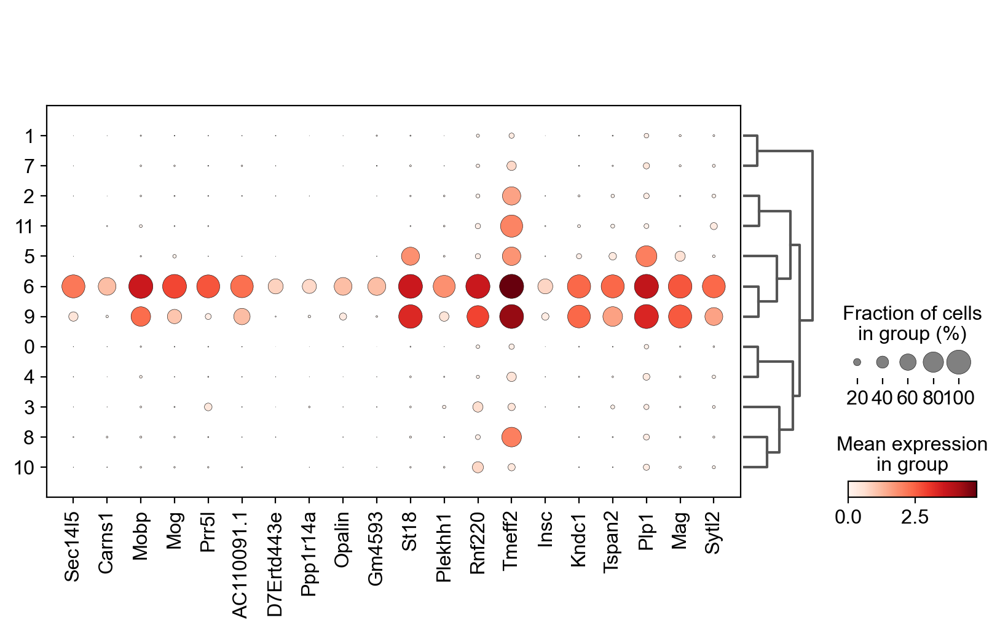

['Sec14l5', 'Carns1', 'Mobp', 'Mog', 'Prr5l', 'AC110091.1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


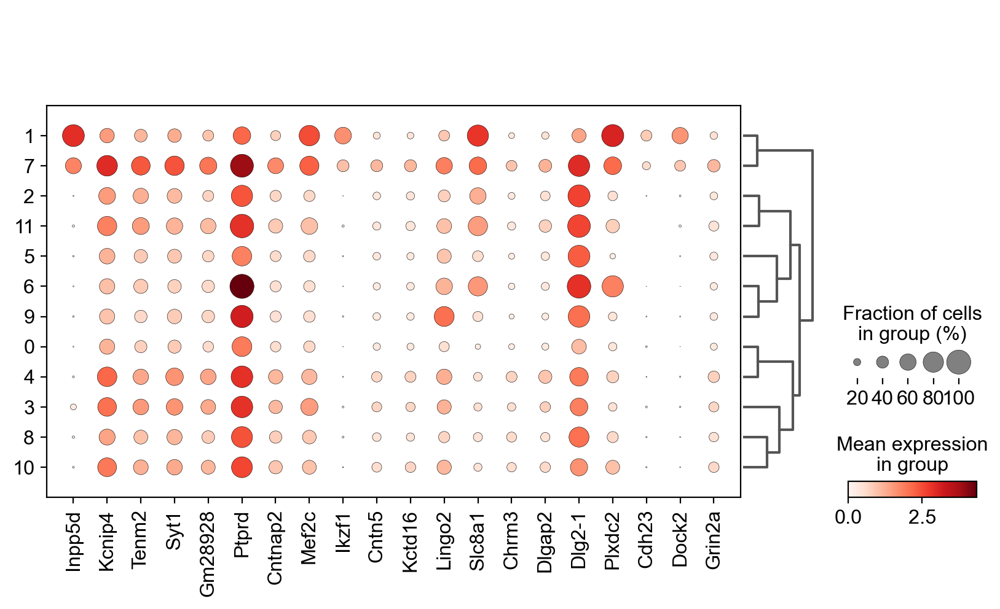

['Inpp5d', 'Kcnip4', 'Tenm2', 'Syt1', 'Gm28928', 'Ptprd']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


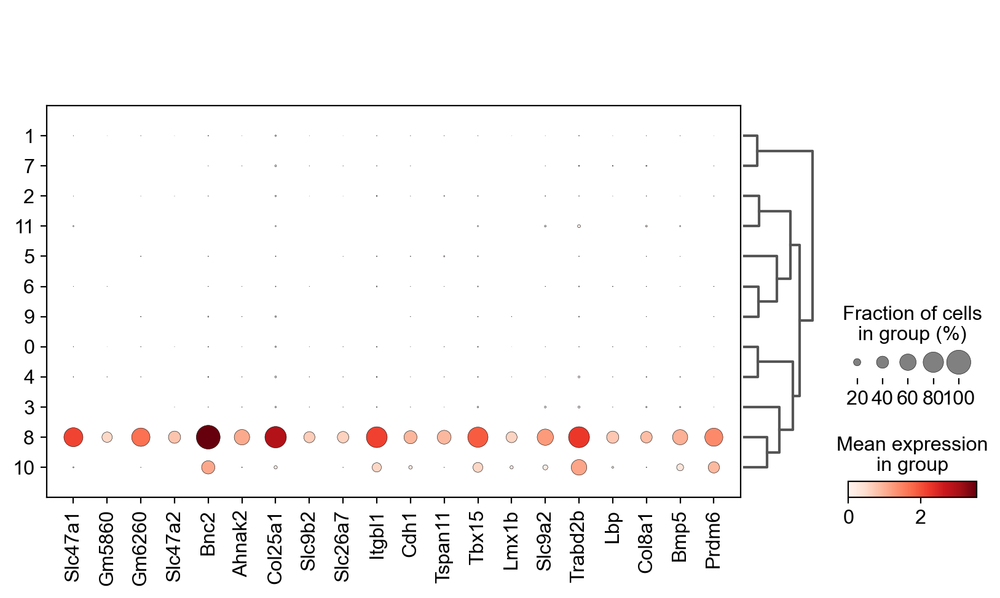

['Slc47a1', 'Gm5860', 'Gm6260', 'Slc47a2', 'Bnc2', 'Ahnak2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


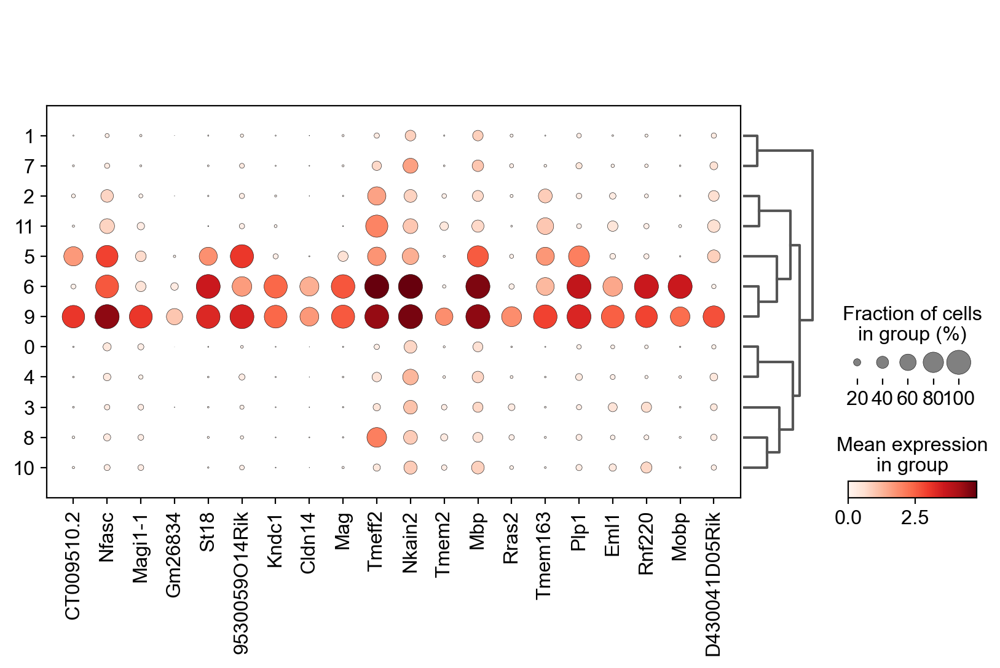

['CT009510.2', 'Nfasc', 'Magi1-1', 'Gm26834', 'St18', '9530059O14Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


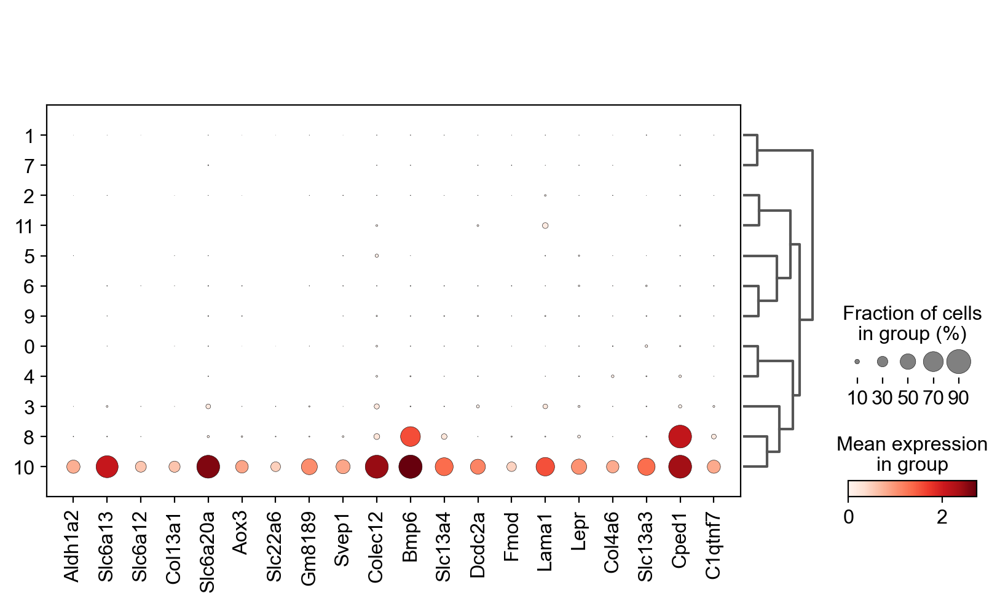

['Aldh1a2', 'Slc6a13', 'Slc6a12', 'Col13a1', 'Slc6a20a', 'Aox3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


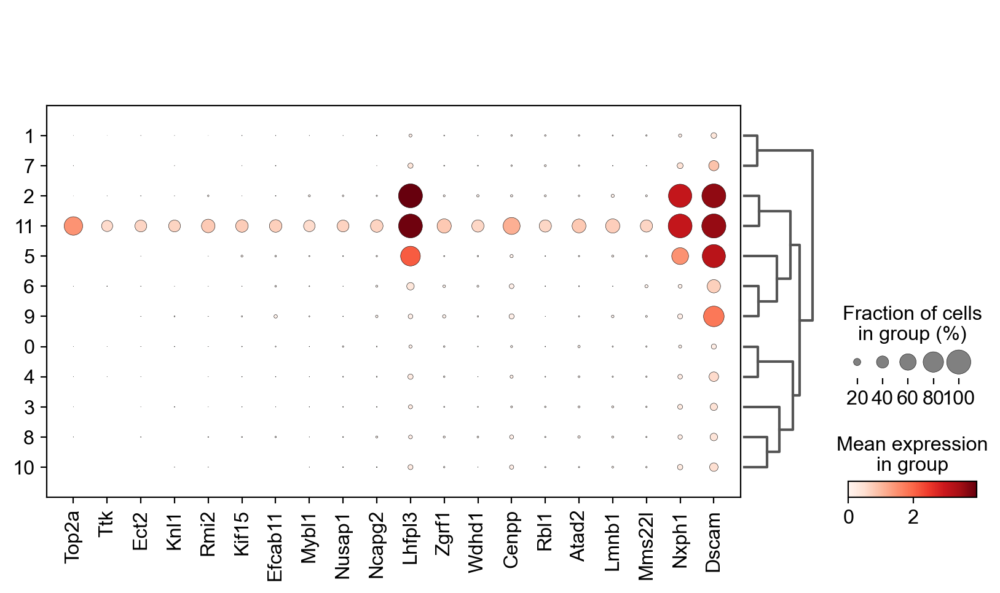

['Top2a', 'Ttk', 'Ect2', 'Knl1', 'Rmi2', 'Kif15']


In [215]:
for i in P17.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P17, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P17.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P17.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P17.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P17.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P17, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

P17 = P17[P17.obs.leiden!='12',:]
P17.shape

## P21

P21 = P21[P21.obs.leiden!='13',:]
P21 = P21[P21.obs.leiden!='11',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


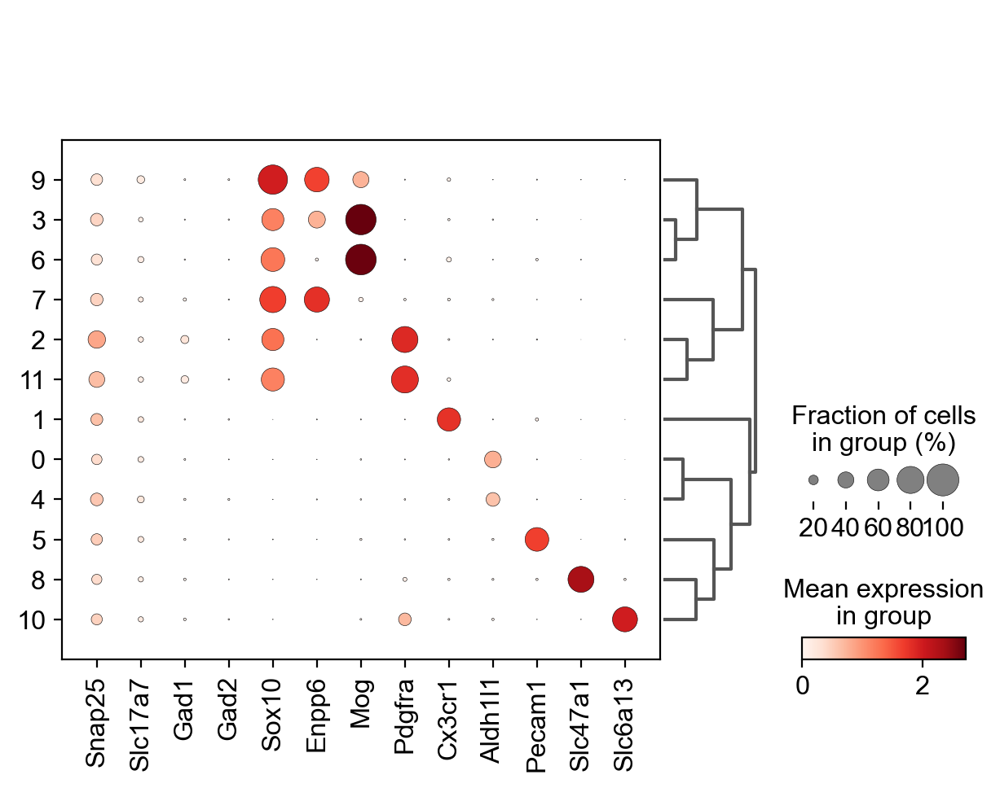

In [212]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2',
                  'Sox10',   'Enpp6', 'Mog', 'Pdgfra', 'Cx3cr1',  'Aldh1l1',
                  'Pecam1', 'Slc47a1', 'Slc6a13' ]

sc.tl.dendrogram(P21, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P21, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


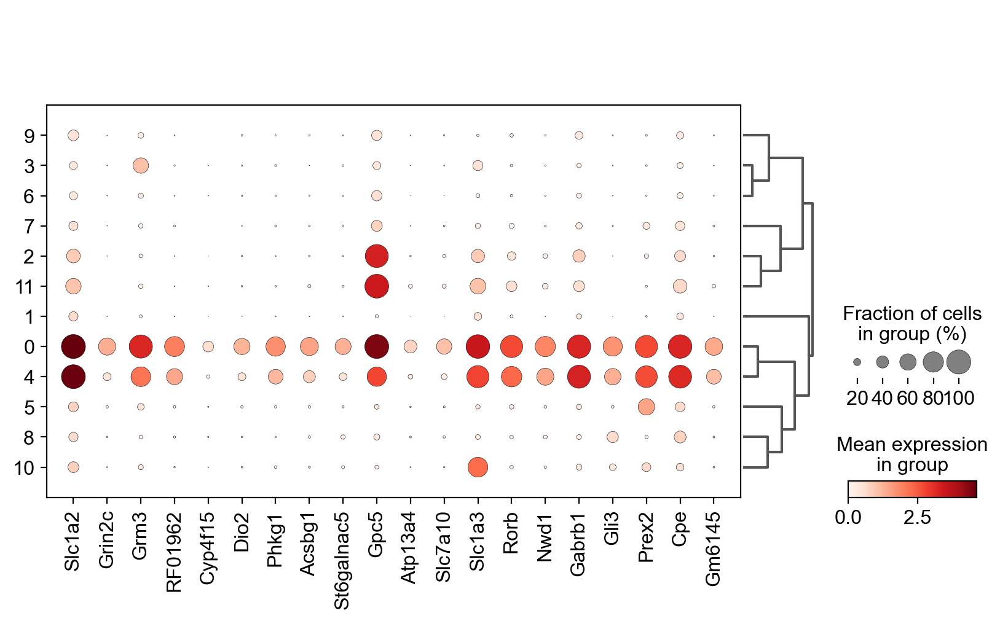

['Slc1a2', 'Grin2c', 'Grm3', 'RF01962', 'Cyp4f15', 'Dio2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


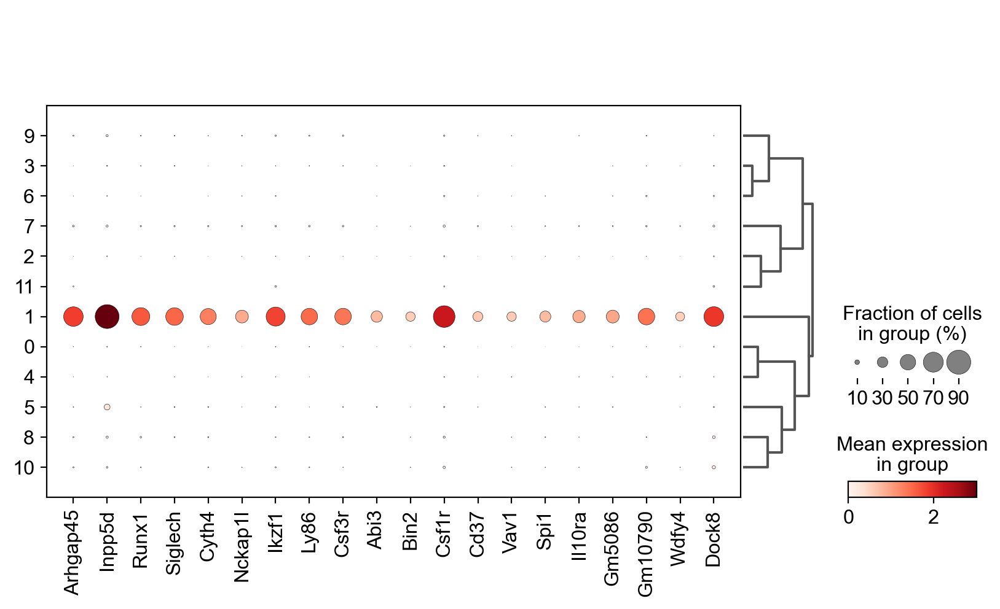

['Arhgap45', 'Inpp5d', 'Runx1', 'Siglech', 'Cyth4', 'Nckap1l']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


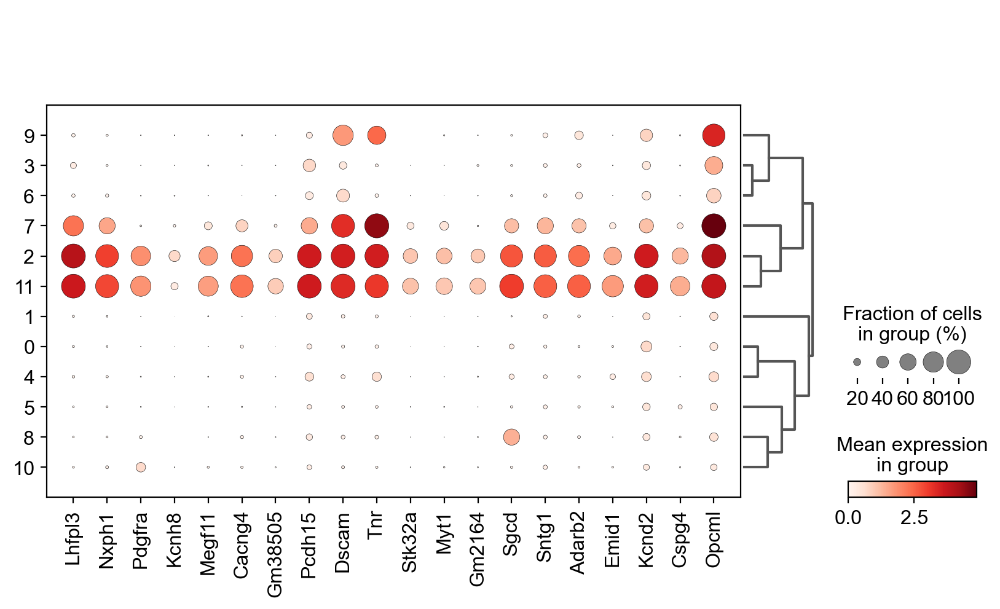

['Lhfpl3', 'Nxph1', 'Pdgfra', 'Kcnh8', 'Megf11', 'Cacng4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


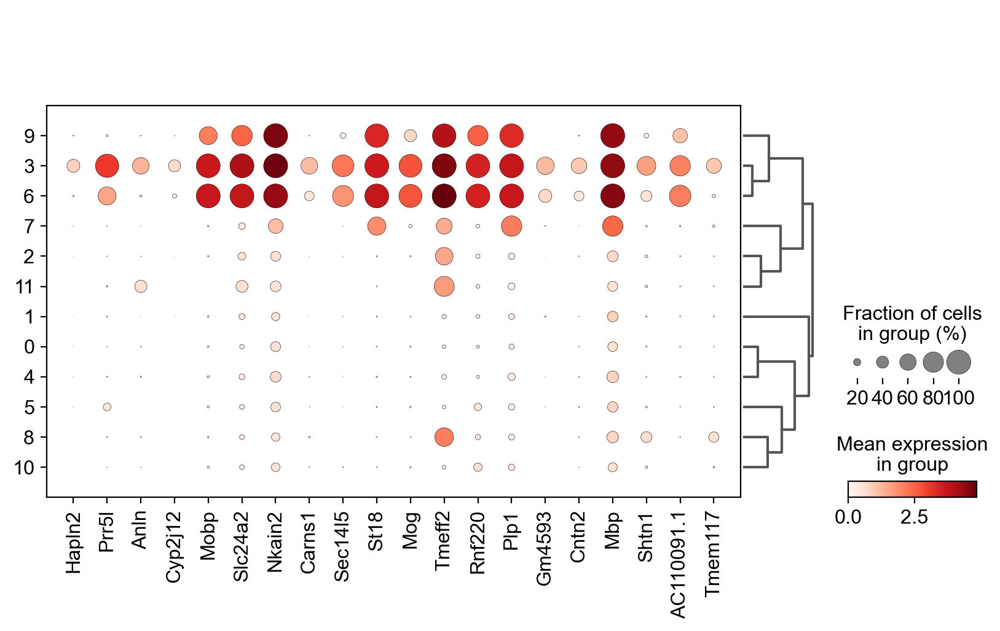

['Hapln2', 'Prr5l', 'Anln', 'Cyp2j12', 'Mobp', 'Slc24a2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


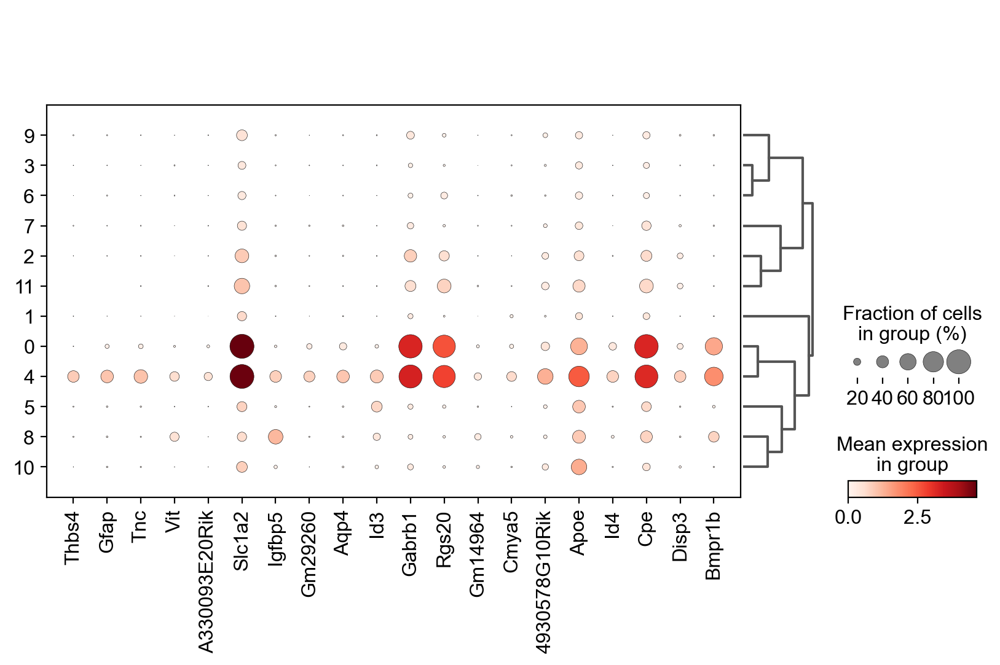

['Thbs4', 'Gfap', 'Tnc', 'Vit', 'A330093E20Rik', 'Slc1a2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


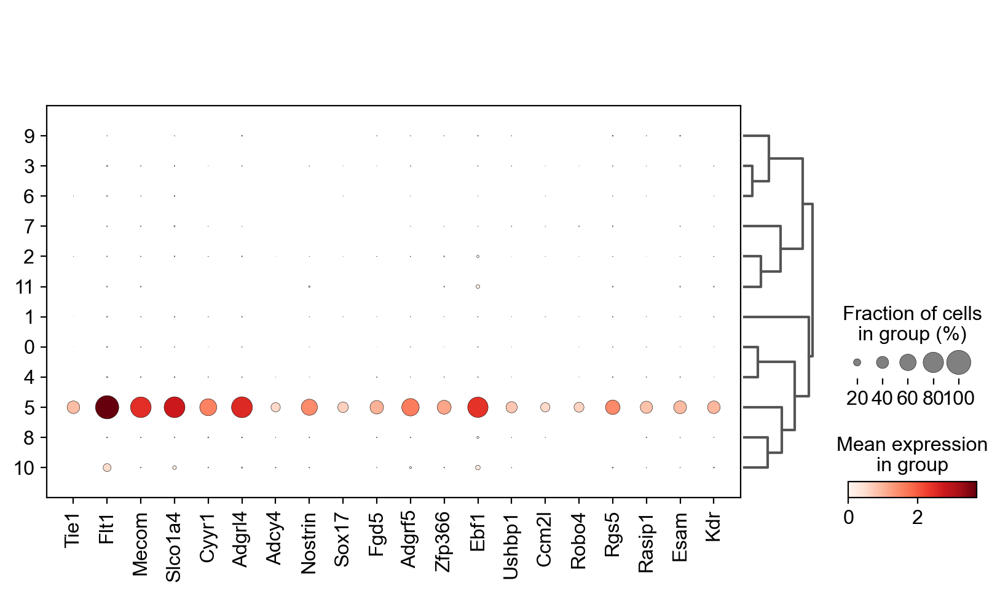

['Tie1', 'Flt1', 'Mecom', 'Slco1a4', 'Cyyr1', 'Adgrl4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


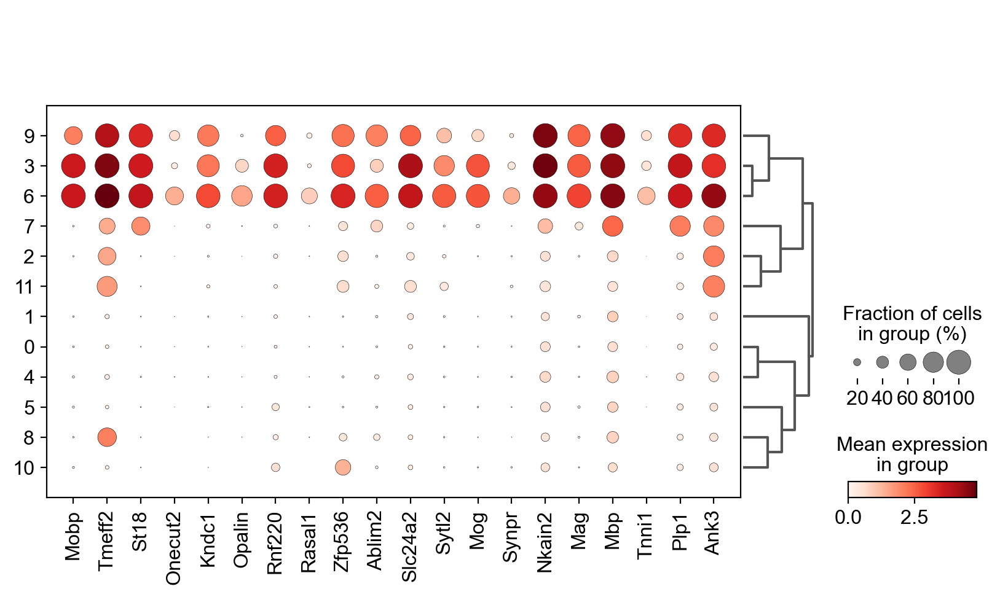

['Mobp', 'Tmeff2', 'St18', 'Onecut2', 'Kndc1', 'Opalin']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


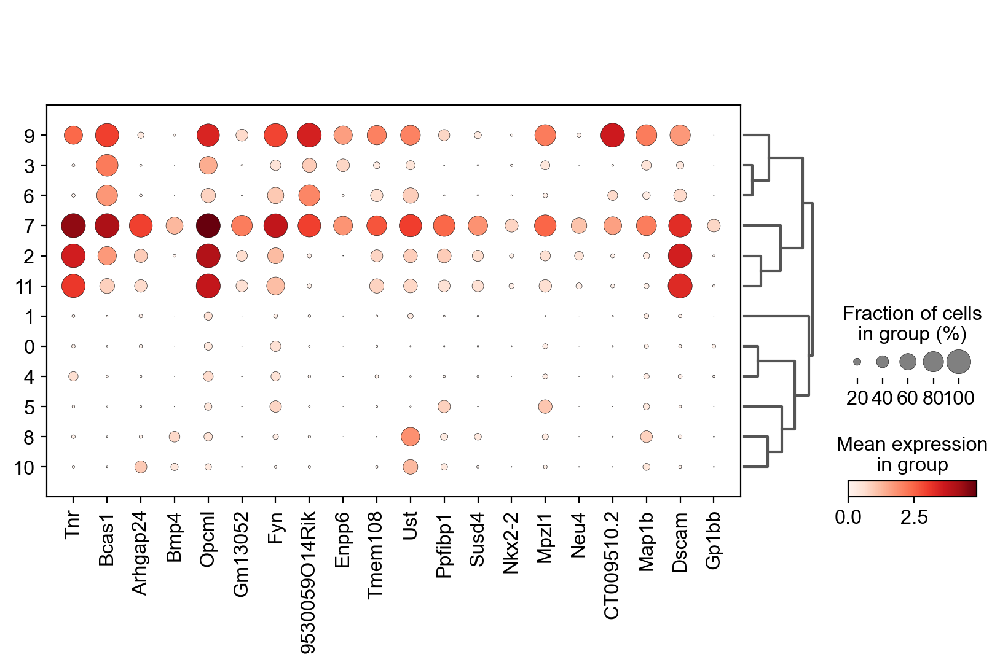

['Tnr', 'Bcas1', 'Arhgap24', 'Bmp4', 'Opcml', 'Gm13052']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


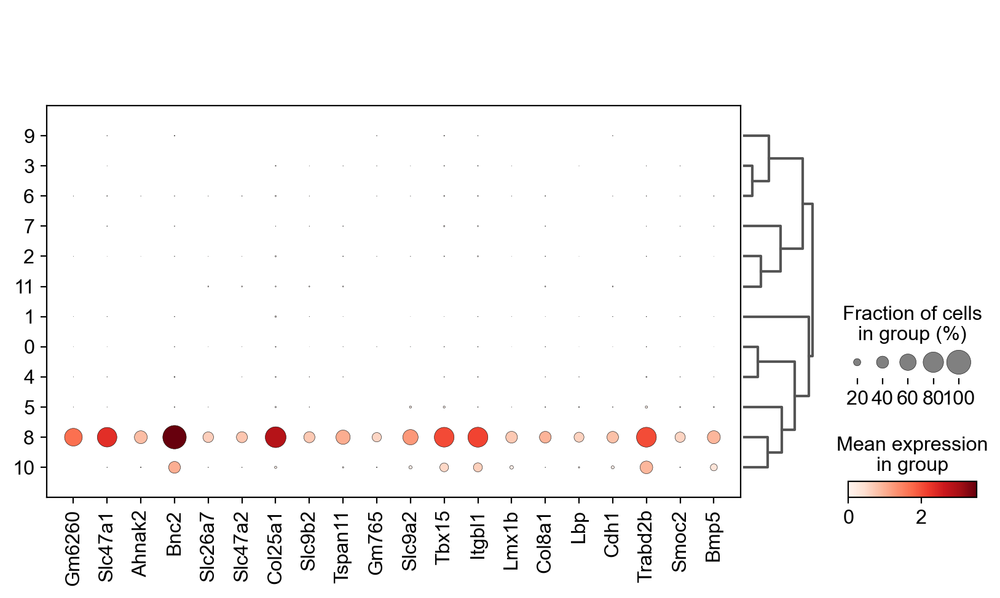

['Gm6260', 'Slc47a1', 'Ahnak2', 'Bnc2', 'Slc26a7', 'Slc47a2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


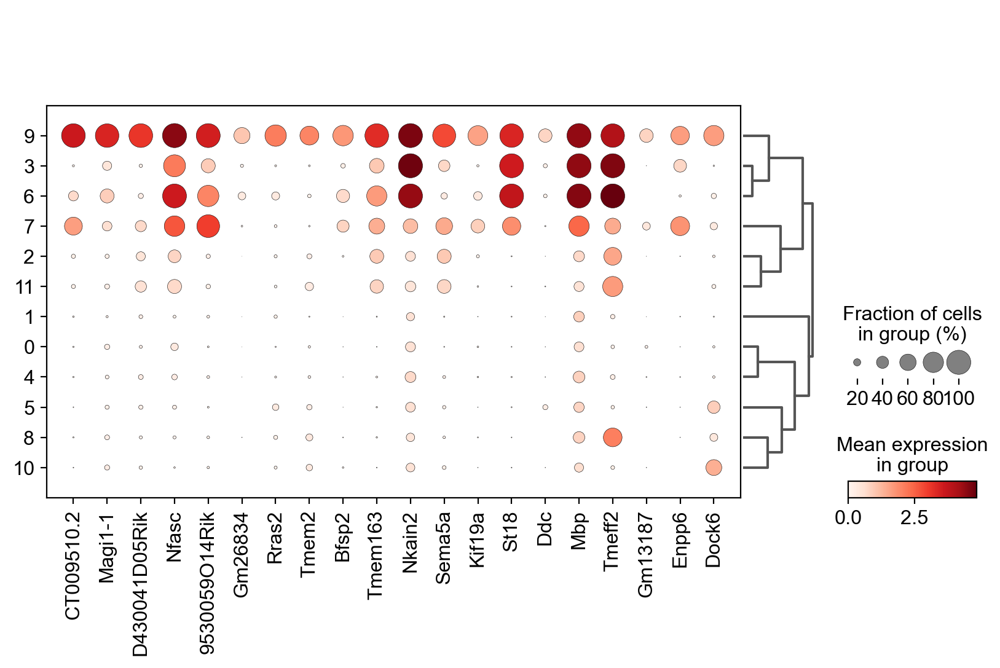

['CT009510.2', 'Magi1-1', 'D430041D05Rik', 'Nfasc', '9530059O14Rik', 'Gm26834']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


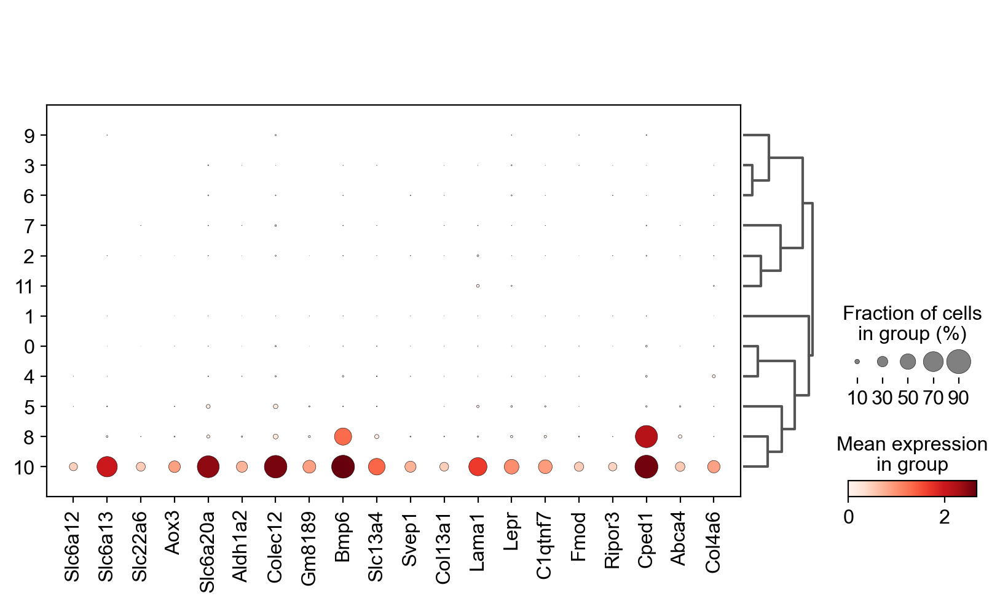

['Slc6a12', 'Slc6a13', 'Slc22a6', 'Aox3', 'Slc6a20a', 'Aldh1a2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


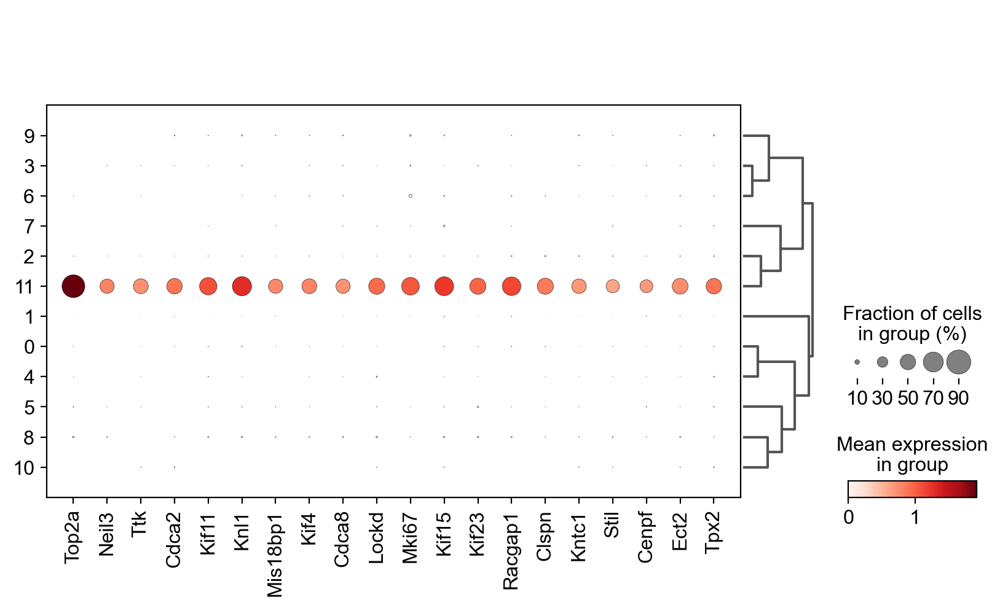

['Top2a', 'Neil3', 'Ttk', 'Cdca2', 'Kif11', 'Knl1']


In [216]:
for i in P21.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P21, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P21.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P21.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P21.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P21.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P21, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

## P28

remove doublets

P28 = P28[P28.obs.leiden!='15',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


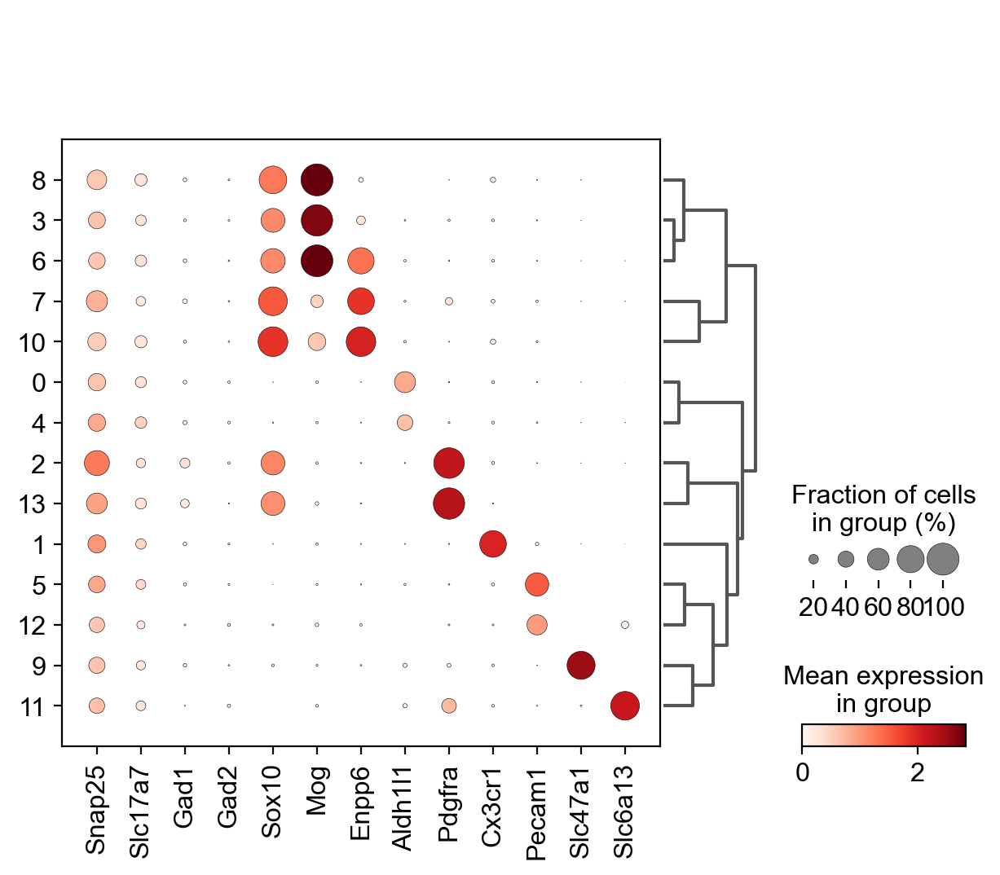

In [229]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2', 
                 
           'Sox10', 'Mog', 'Enpp6', 'Aldh1l1', 'Pdgfra',
                  'Cx3cr1', 'Pecam1', 'Slc47a1', 'Slc6a13']

sc.tl.dendrogram(P28, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P28, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


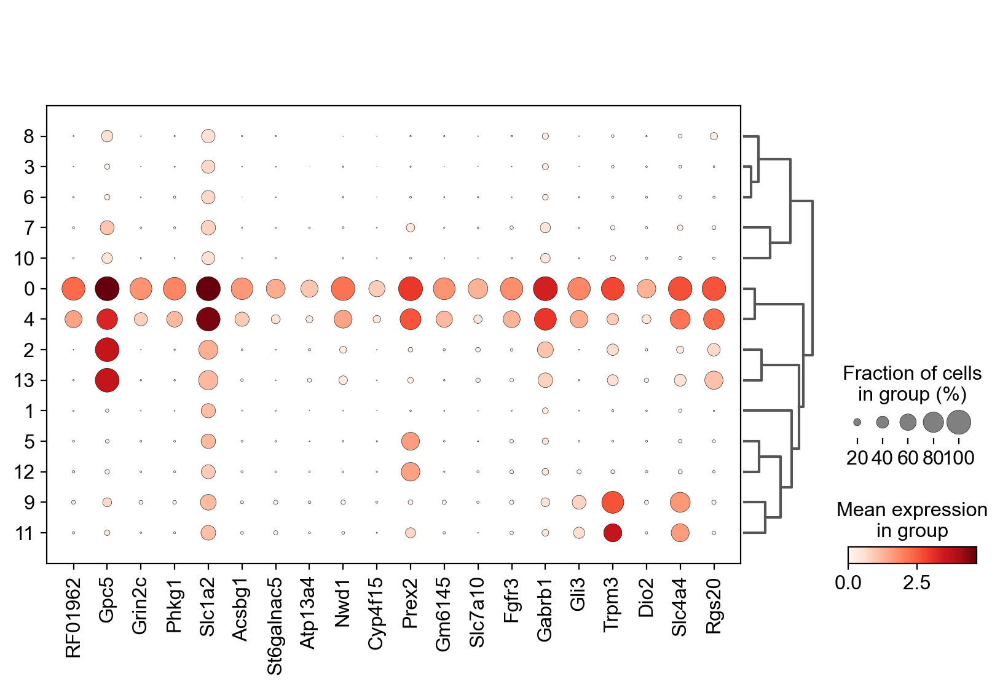

['RF01962', 'Gpc5', 'Grin2c', 'Phkg1', 'Slc1a2', 'Acsbg1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


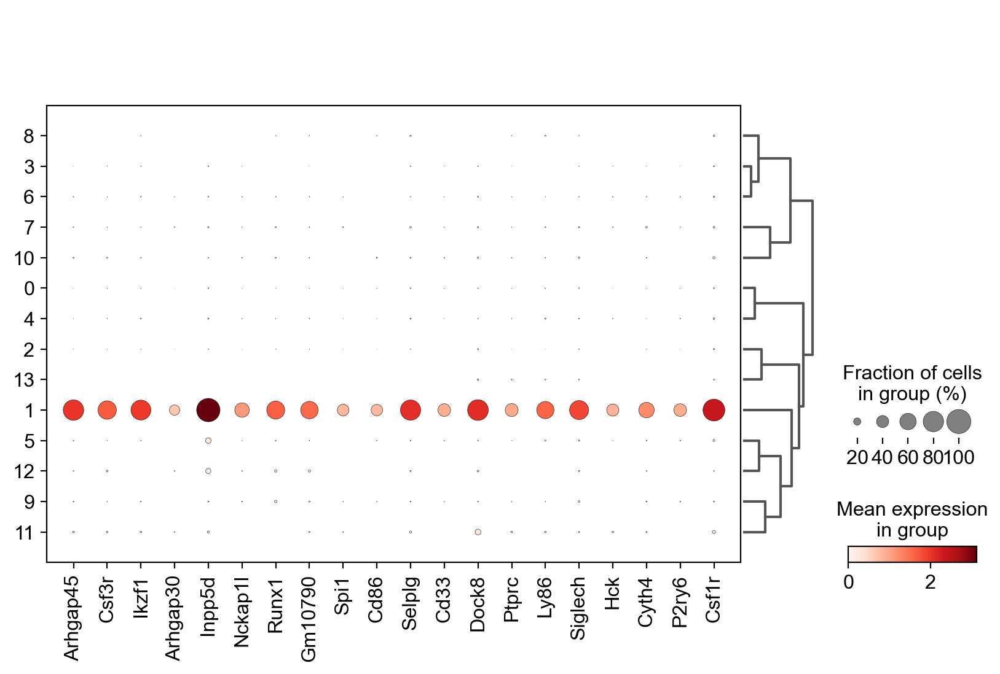

['Arhgap45', 'Csf3r', 'Ikzf1', 'Arhgap30', 'Inpp5d', 'Nckap1l']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


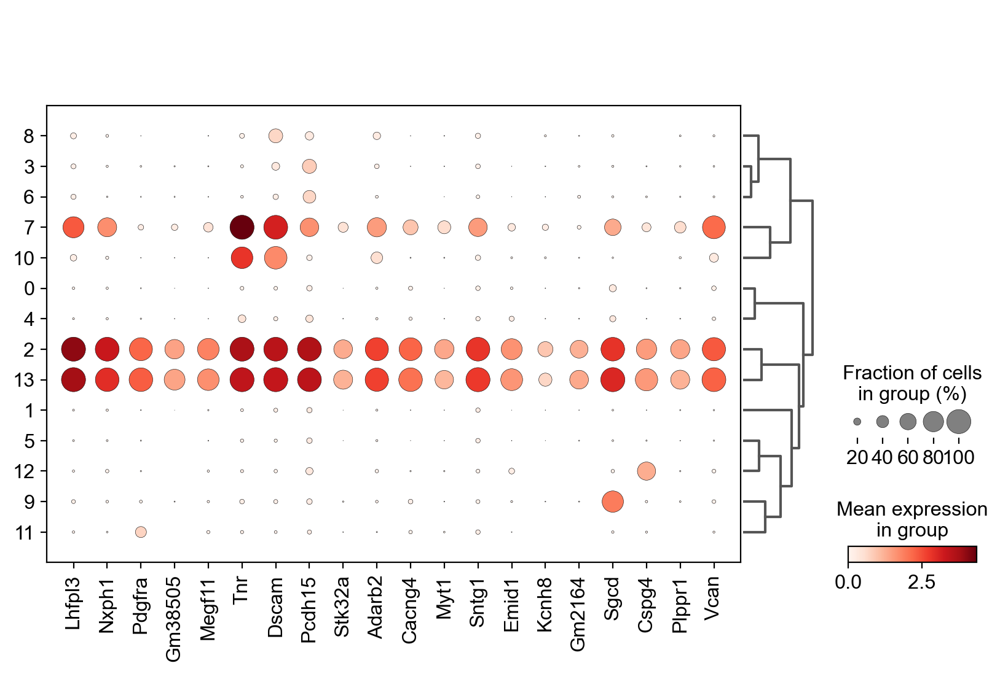

['Lhfpl3', 'Nxph1', 'Pdgfra', 'Gm38505', 'Megf11', 'Tnr']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


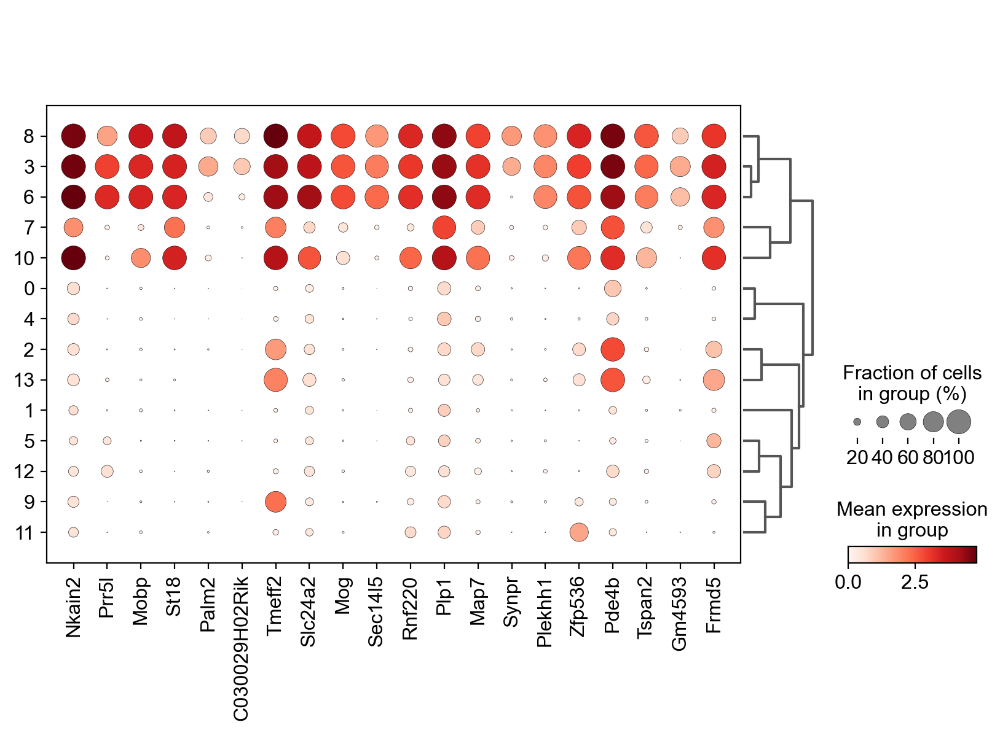

['Nkain2', 'Prr5l', 'Mobp', 'St18', 'Palm2', 'C030029H02Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


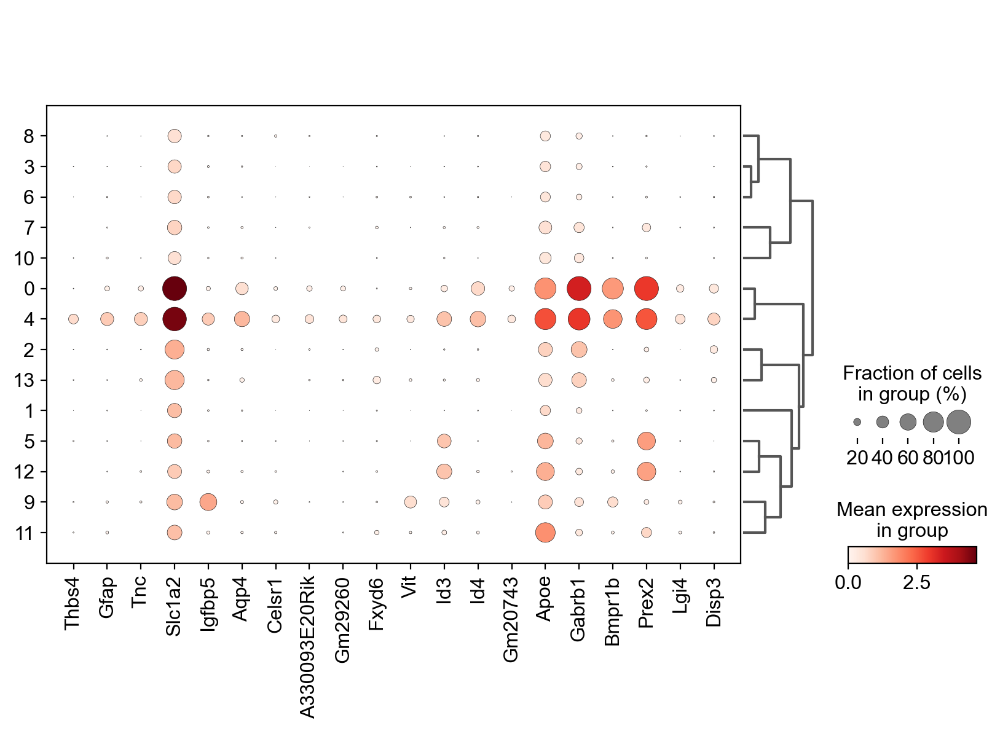

['Thbs4', 'Gfap', 'Tnc', 'Slc1a2', 'Igfbp5', 'Aqp4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


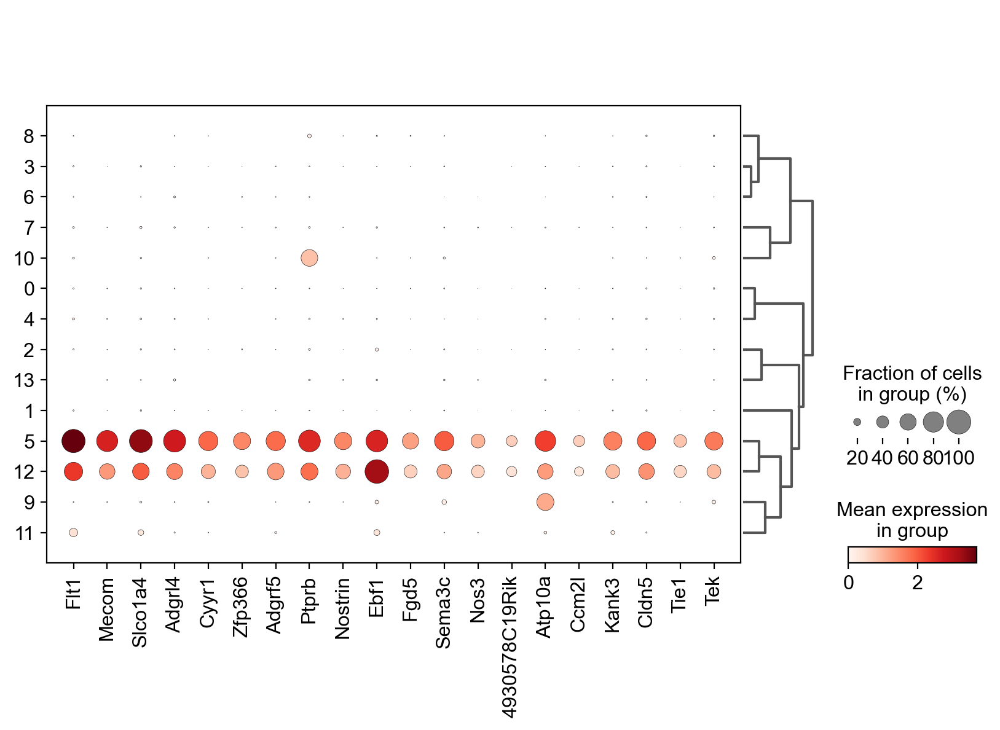

['Flt1', 'Mecom', 'Slco1a4', 'Adgrl4', 'Cyyr1', 'Zfp366']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


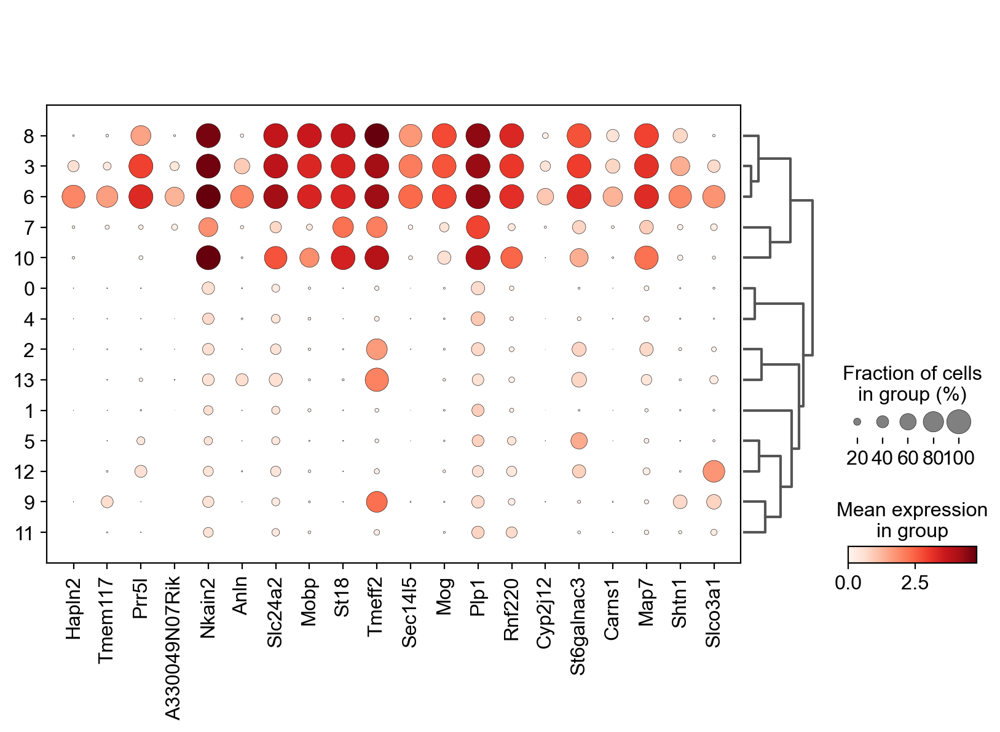

['Hapln2', 'Tmem117', 'Prr5l', 'A330049N07Rik', 'Nkain2', 'Anln']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


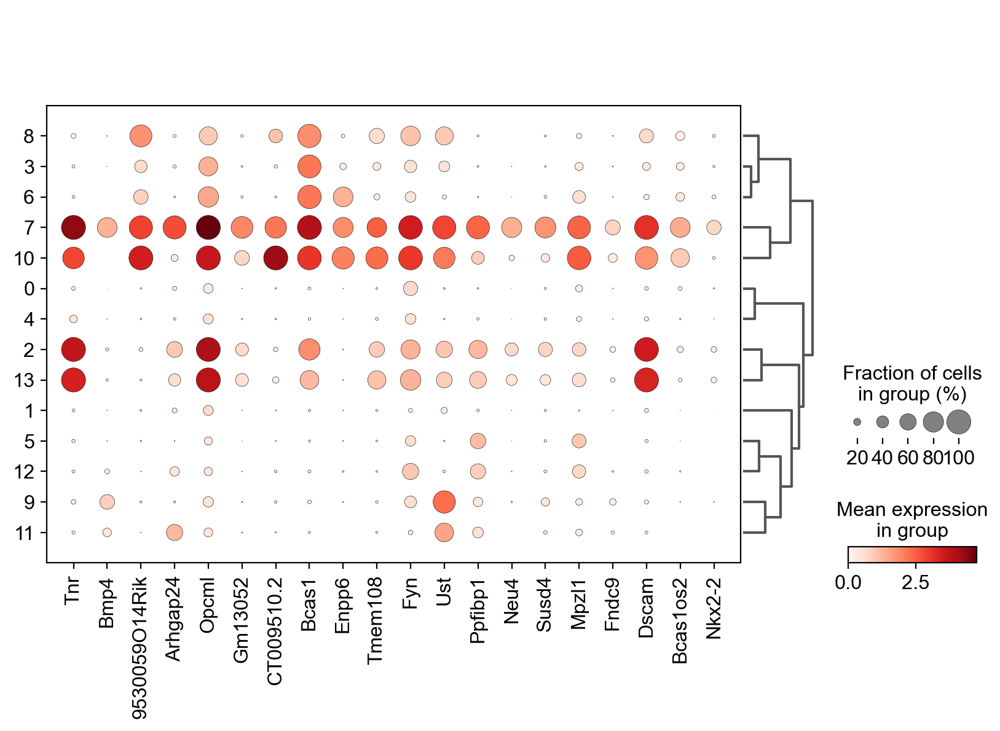

['Tnr', 'Bmp4', '9530059O14Rik', 'Arhgap24', 'Opcml', 'Gm13052']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


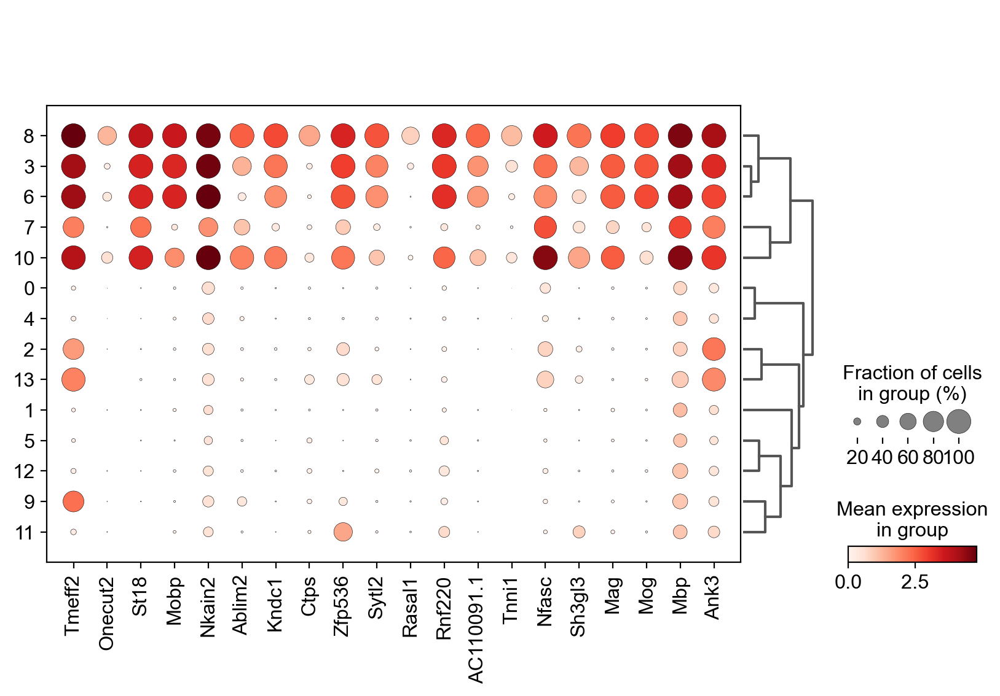

['Tmeff2', 'Onecut2', 'St18', 'Mobp', 'Nkain2', 'Ablim2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


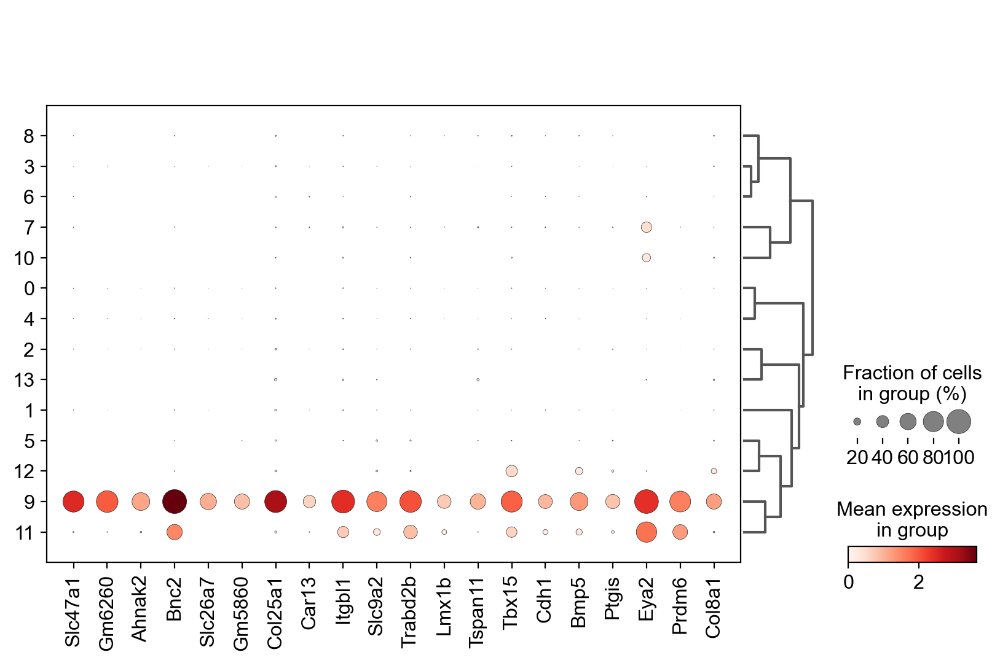

['Slc47a1', 'Gm6260', 'Ahnak2', 'Bnc2', 'Slc26a7', 'Gm5860']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


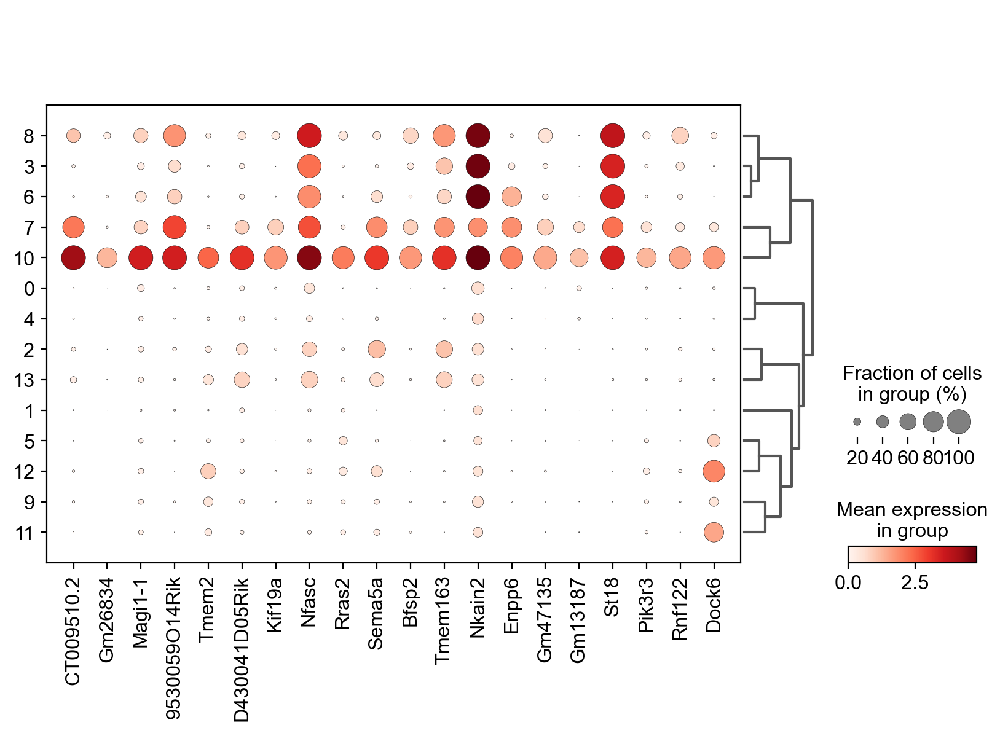

['CT009510.2', 'Gm26834', 'Magi1-1', '9530059O14Rik', 'Tmem2', 'D430041D05Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


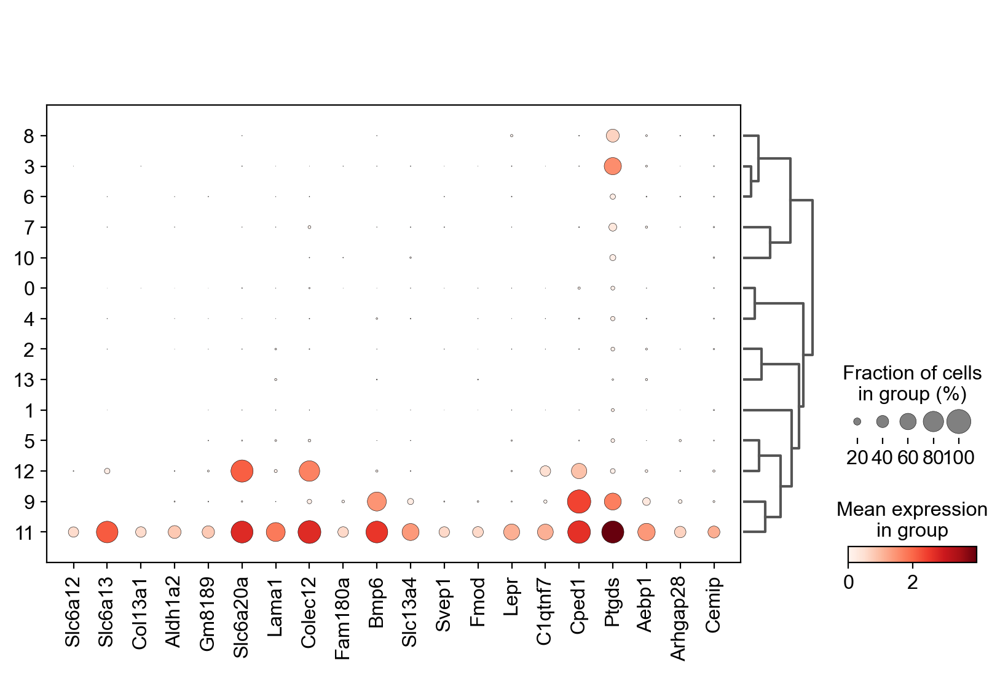

['Slc6a12', 'Slc6a13', 'Col13a1', 'Aldh1a2', 'Gm8189', 'Slc6a20a']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


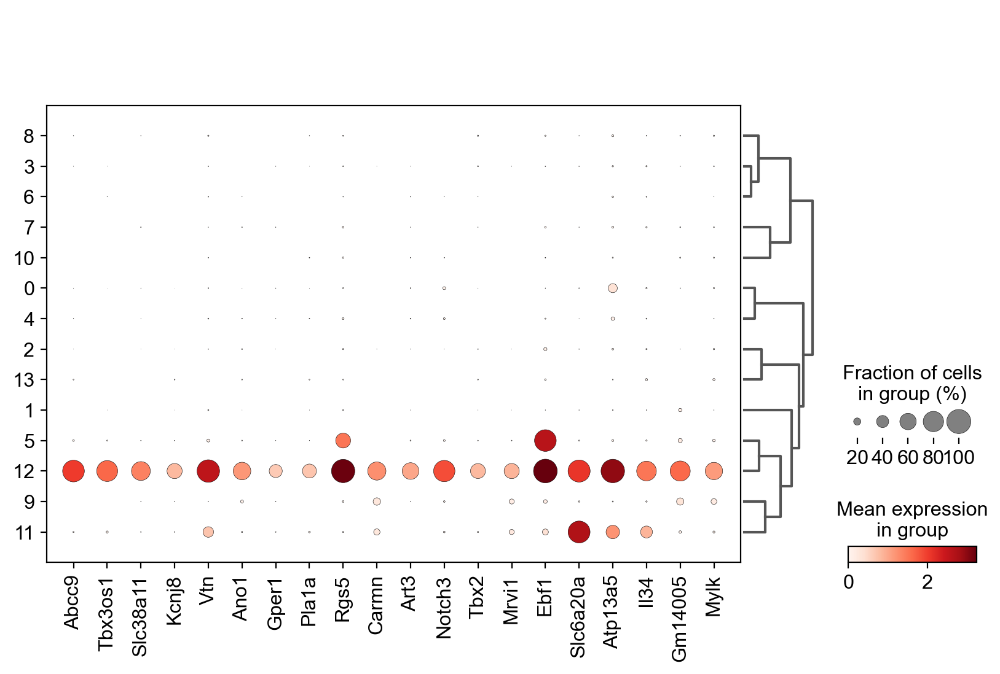

['Abcc9', 'Tbx3os1', 'Slc38a11', 'Kcnj8', 'Vtn', 'Ano1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


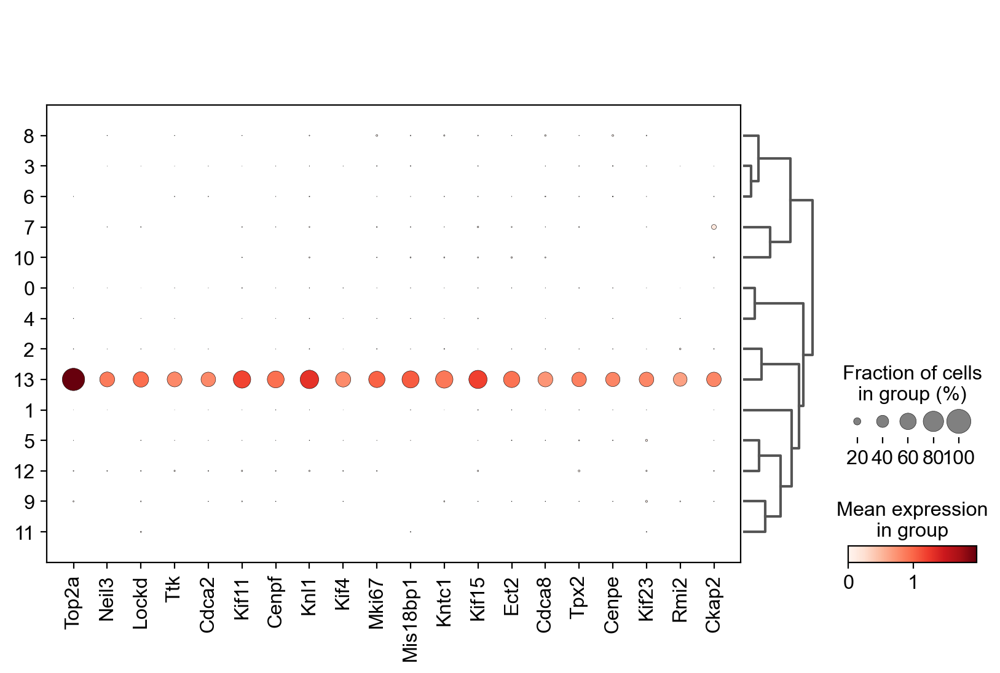

['Top2a', 'Neil3', 'Lockd', 'Ttk', 'Cdca2', 'Kif11']


In [217]:
for i in P28.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P28, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P28.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P28.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P28.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P28.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P28, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

## P38

P38 = P38[P38.obs.leiden!='6',:]

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


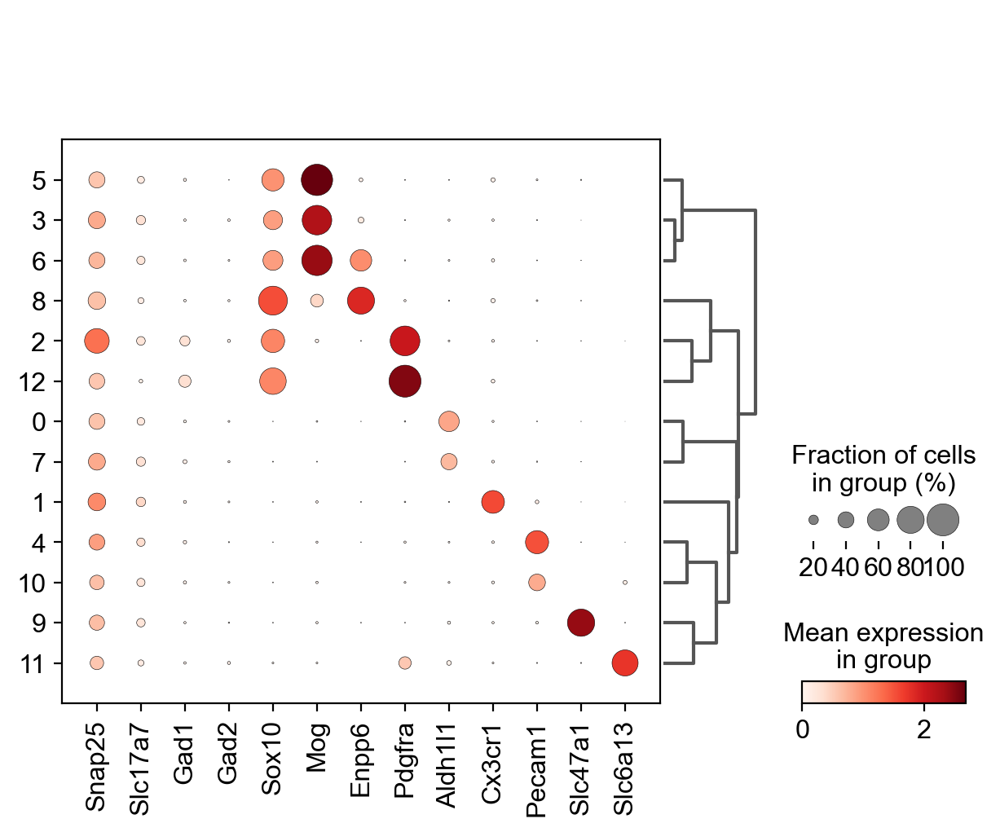

In [236]:
markers = ['Snap25', 'Slc17a7', 'Gad1', 'Gad2', 
                 'Sox10', 'Mog',  
            'Enpp6',   
                  'Pdgfra', 'Aldh1l1', 'Cx3cr1',
                   'Pecam1', 'Slc47a1', 'Slc6a13', ]

sc.tl.dendrogram(P38, groupby='leiden', use_rep='X_harmony')
sc.pl.dotplot(P38, markers, groupby='leiden', dendrogram=True)

ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


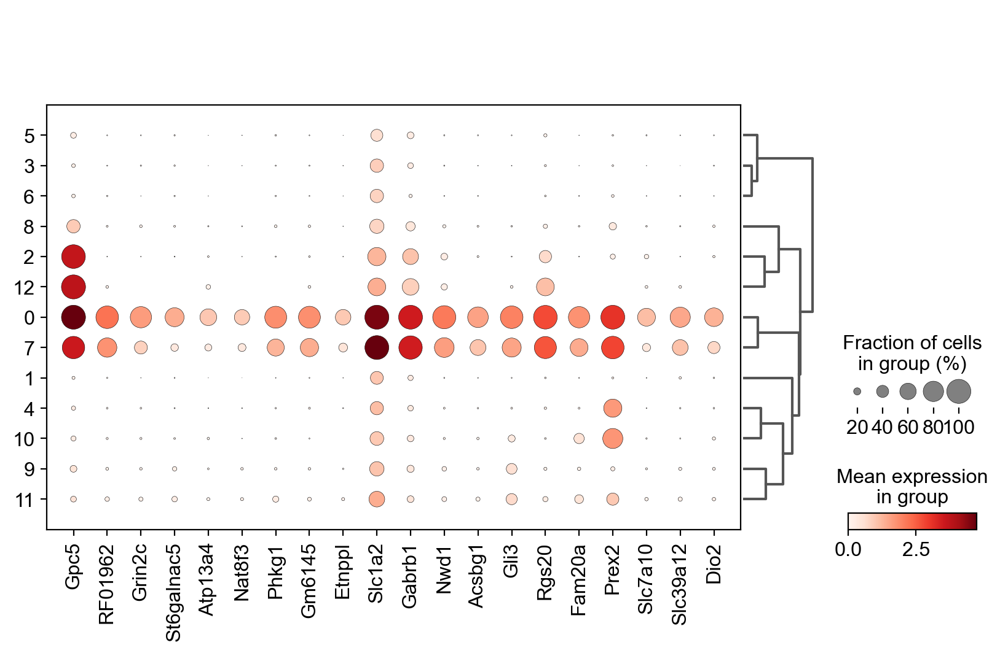

['Gpc5', 'RF01962', 'Grin2c', 'St6galnac5', 'Atp13a4', 'Nat8f3']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


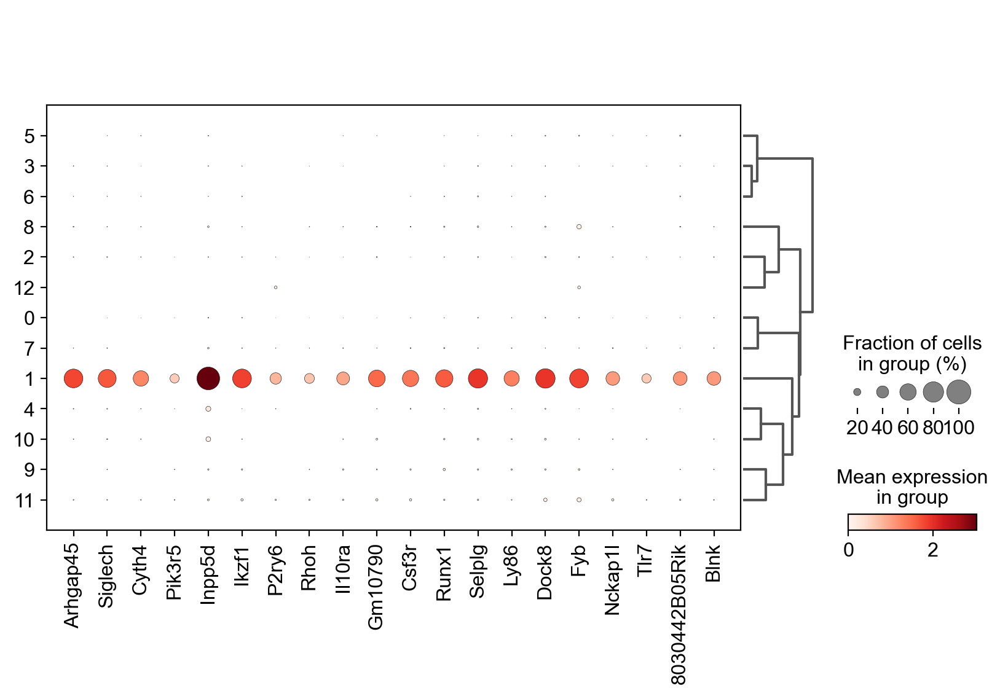

['Arhgap45', 'Siglech', 'Cyth4', 'Pik3r5', 'Inpp5d', 'Ikzf1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


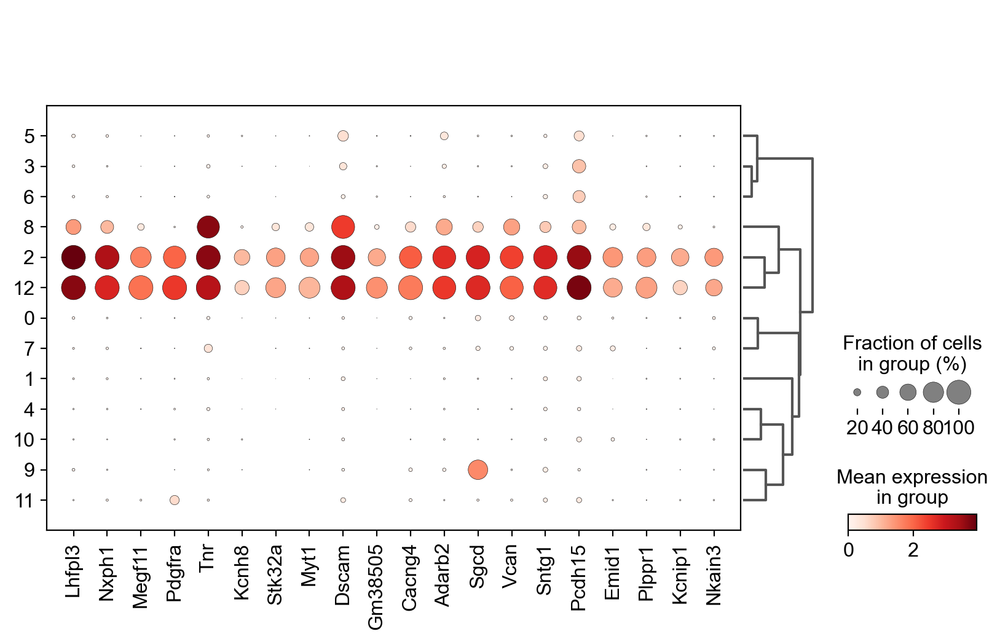

['Lhfpl3', 'Nxph1', 'Megf11', 'Pdgfra', 'Tnr', 'Kcnh8']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


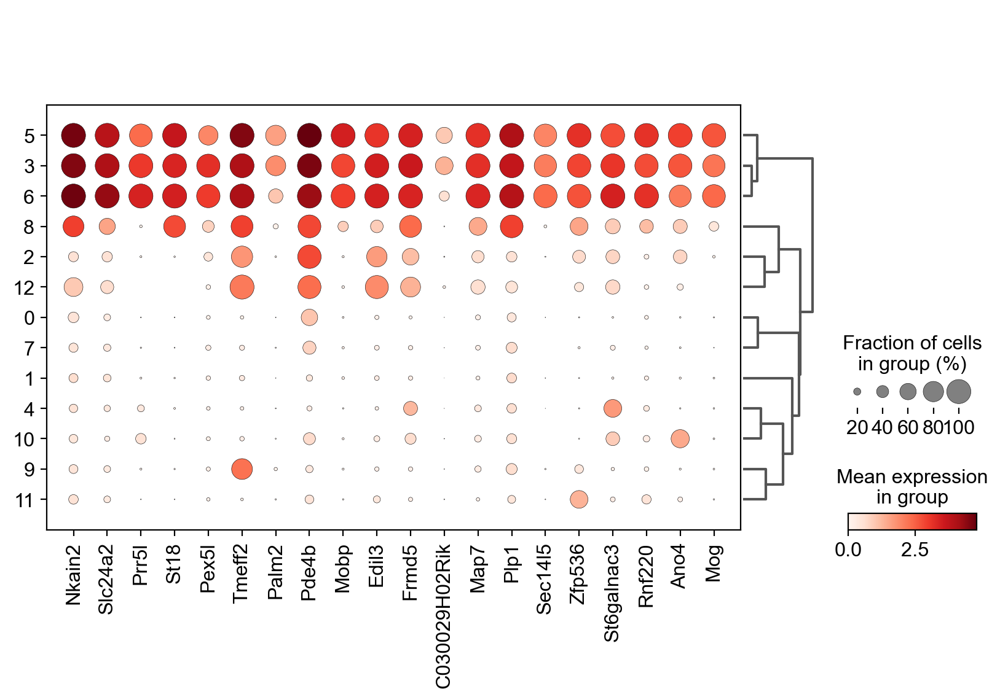

['Nkain2', 'Slc24a2', 'Prr5l', 'St18', 'Pex5l', 'Tmeff2']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


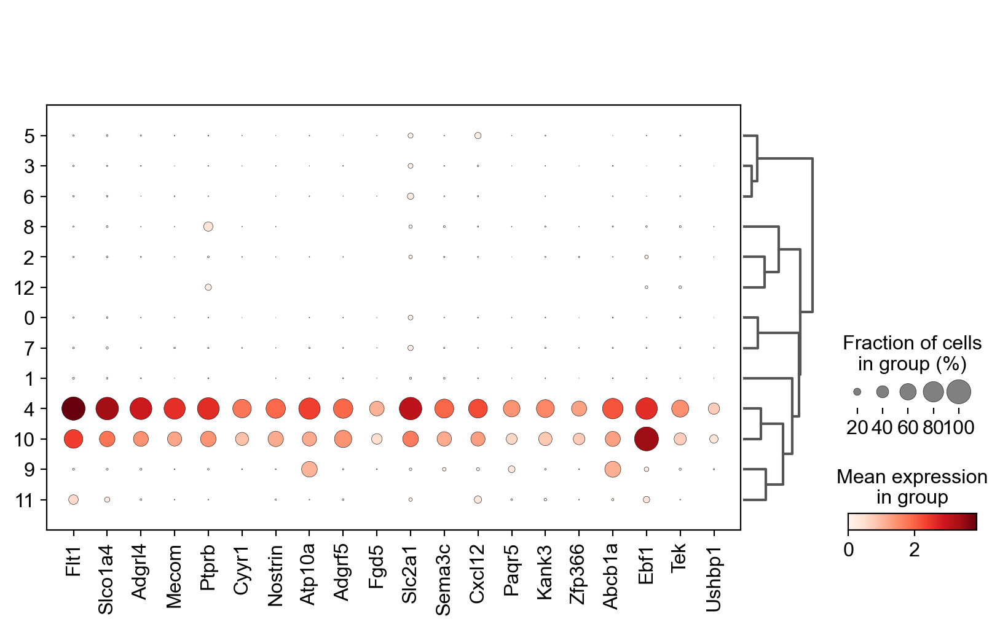

['Flt1', 'Slco1a4', 'Adgrl4', 'Mecom', 'Ptprb', 'Cyyr1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


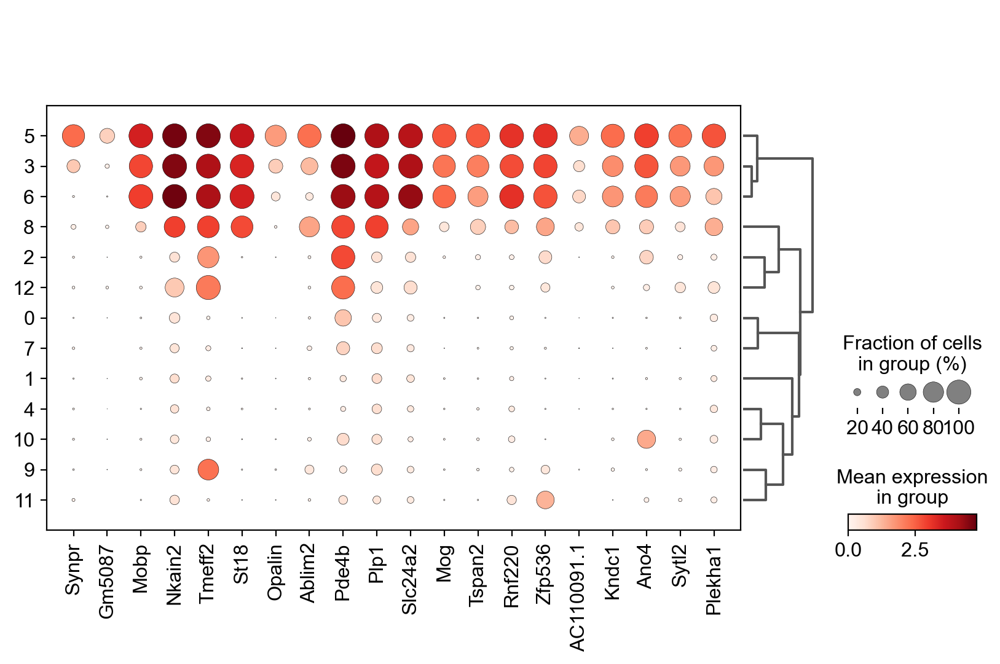

['Synpr', 'Gm5087', 'Mobp', 'Nkain2', 'Tmeff2', 'St18']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


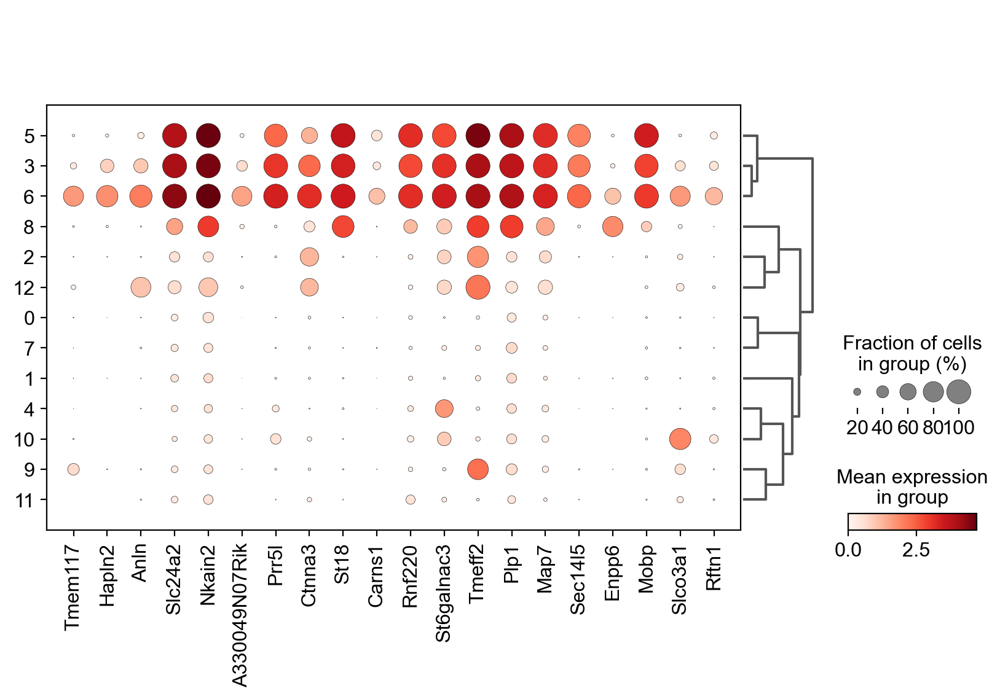

['Tmem117', 'Hapln2', 'Anln', 'Slc24a2', 'Nkain2', 'A330049N07Rik']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


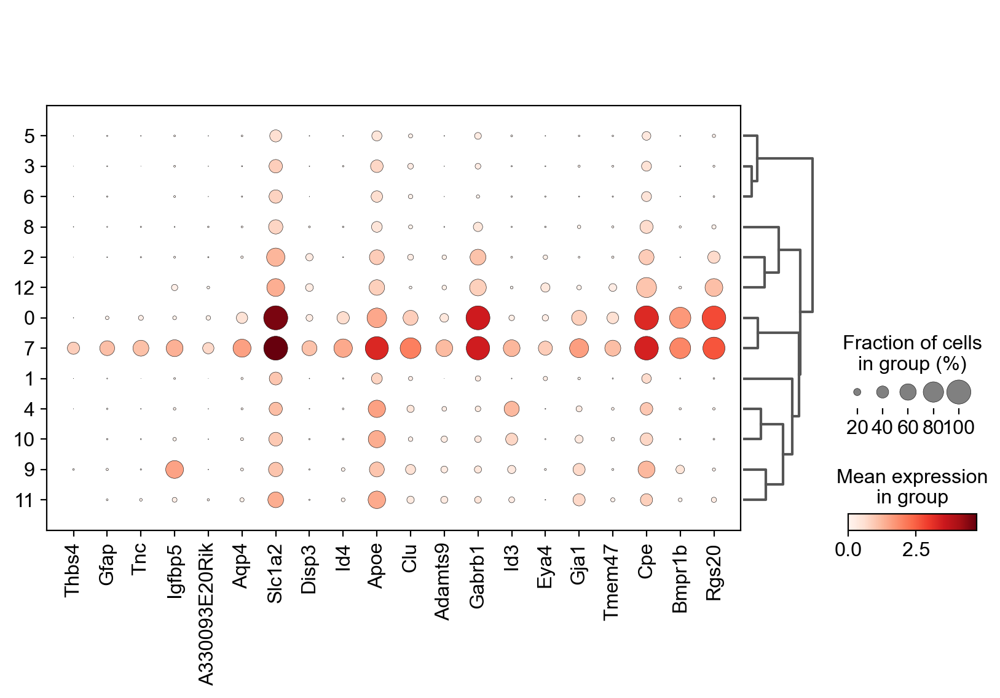

['Thbs4', 'Gfap', 'Tnc', 'Igfbp5', 'A330093E20Rik', 'Aqp4']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


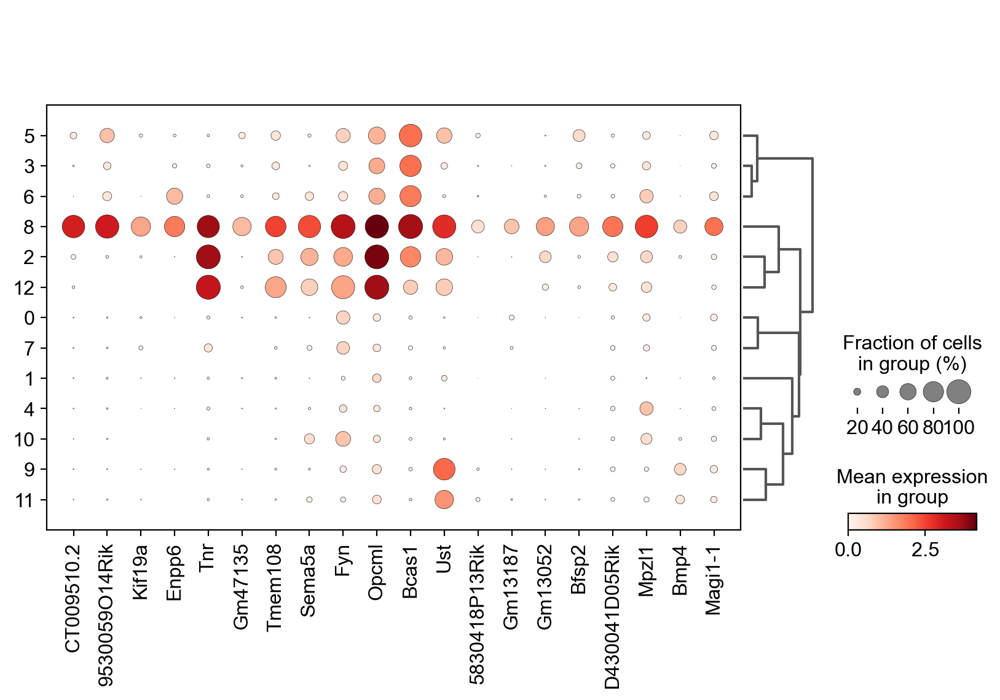

['CT009510.2', '9530059O14Rik', 'Kif19a', 'Enpp6', 'Tnr', 'Gm47135']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


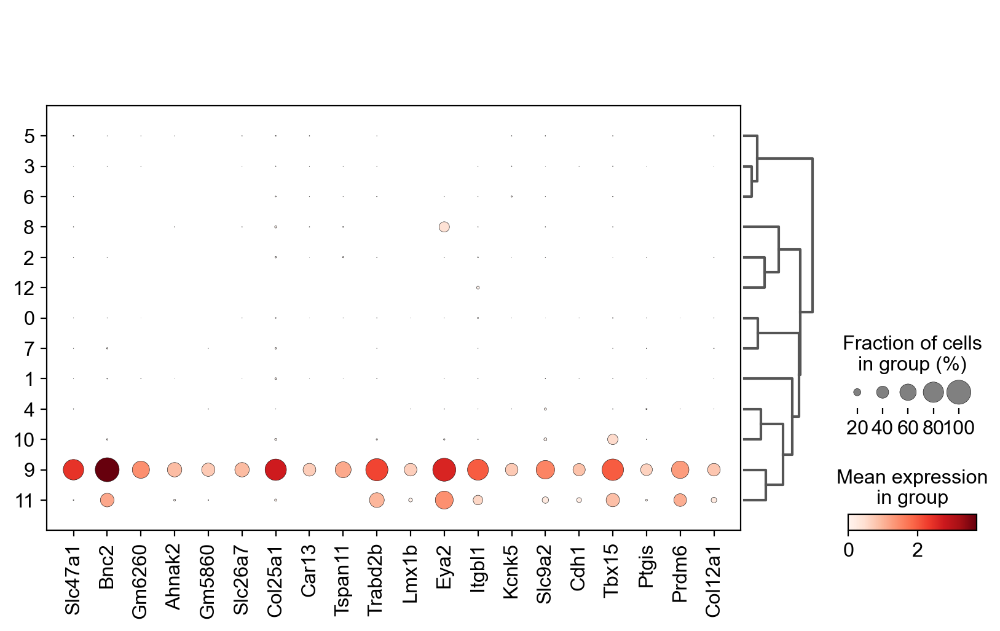

['Slc47a1', 'Bnc2', 'Gm6260', 'Ahnak2', 'Gm5860', 'Slc26a7']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


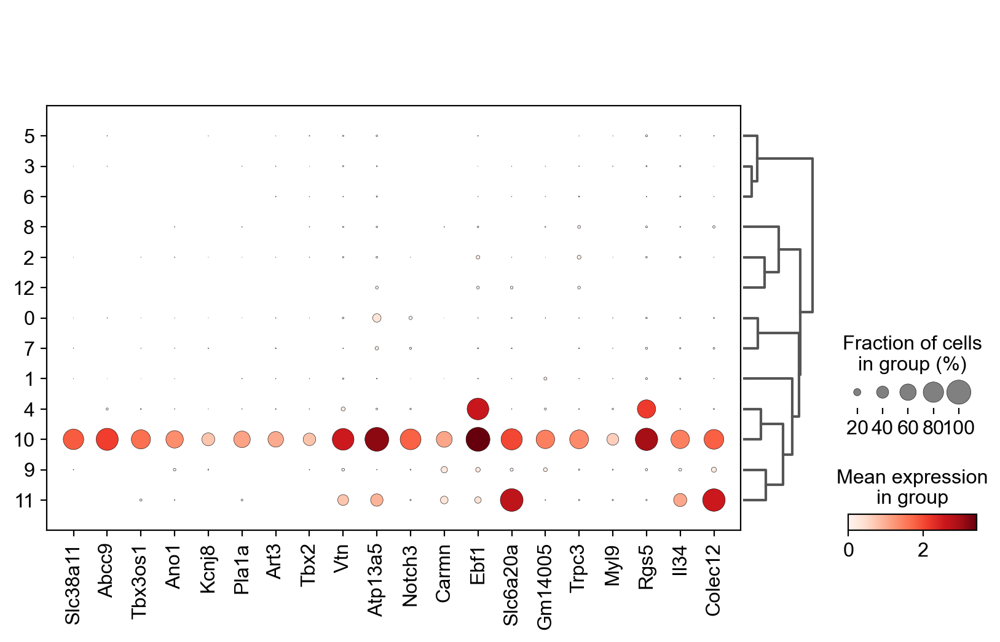

['Slc38a11', 'Abcc9', 'Tbx3os1', 'Ano1', 'Kcnj8', 'Pla1a']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


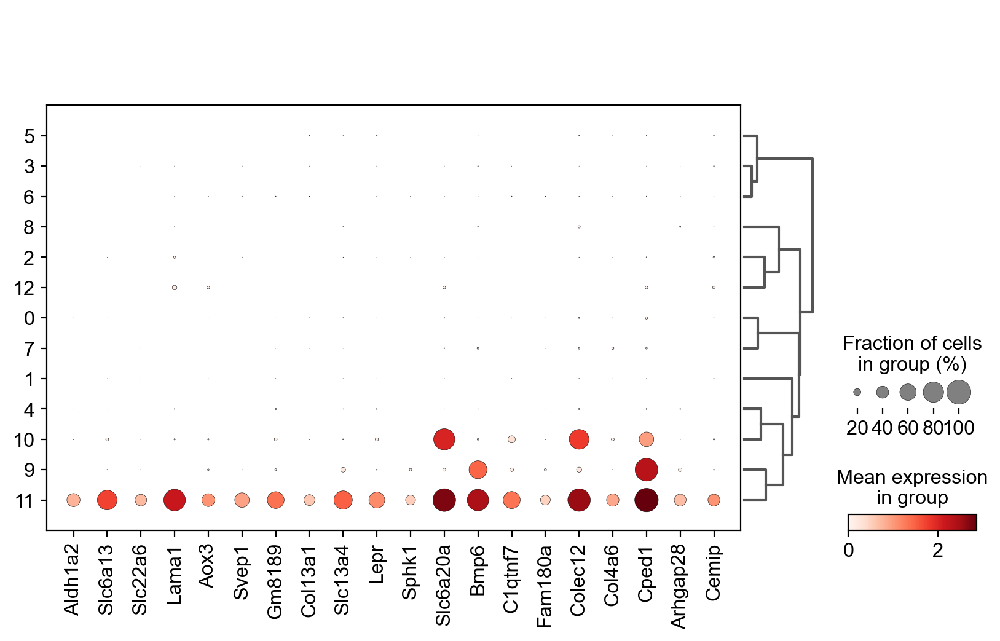

['Aldh1a2', 'Slc6a13', 'Slc22a6', 'Lama1', 'Aox3', 'Svep1']
ranking genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


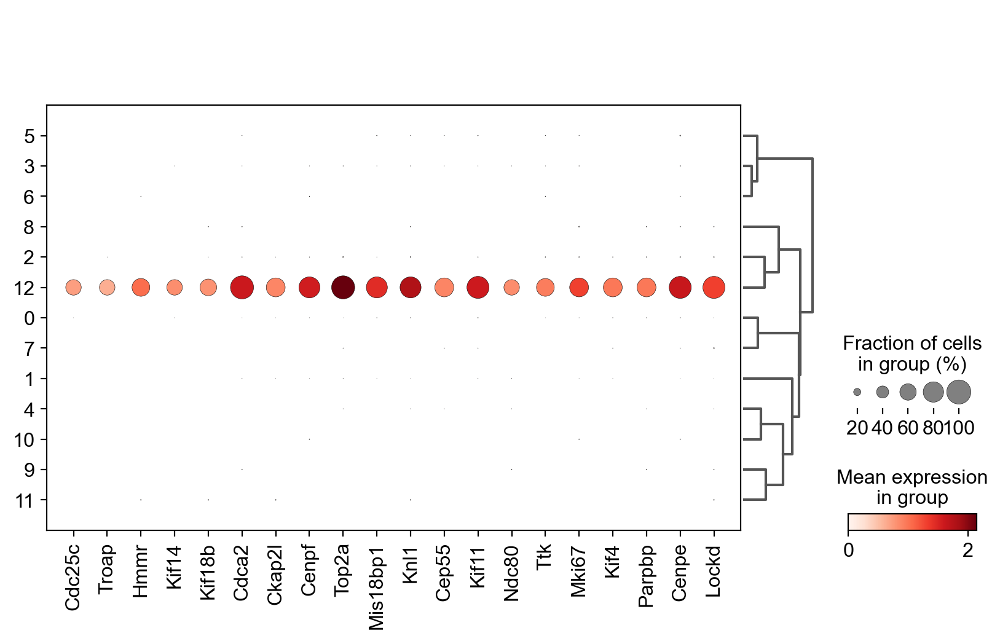

['Cdc25c', 'Troap', 'Hmmr', 'Kif14', 'Kif18b', 'Cdca2']


In [218]:
for i in P38.obs.leiden.values.categories:
    leiden = i
    sc.tl.rank_genes_groups(P38, groupby='leiden', groups=[leiden], reference='rest', method='wilcoxon', n_genes=250)
    #wilcGenes23vRest = list(P38.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    #if ('Malat1' in wilcGenes23vRest): del wilcGenes23vRest[wilcGenes23vRest.index('Malat1')]

    wilcLF8v14 = P38.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #log fold changes ordered by score

    wilcGenes8v14_s = list(P38.uns['rank_genes_groups']['names'].astype([(leiden, '<U50')]).view('<U50'))  #list of genes ordered by wilc score
    wilcLF8v14_s = P38.uns['rank_genes_groups']['logfoldchanges'].astype([(leiden, '<f8')]).view('<f8') #numpy array of logfoldchnages to be ordered lowest to highest
    wilcLF8v14_s.sort() #log fold changes from lowest to highest
    wilcGenes8v14 = [] #list of genes ordered by logfold change: low to high
    for i in wilcLF8v14_s:
        gene_idx = np.where(wilcLF8v14 == i)[0][0]
        wilcGenes8v14.append(wilcGenes8v14_s[gene_idx])
    wilcGenes8v14_correct = []
    for i in reversed(wilcGenes8v14):
        wilcGenes8v14_correct.append(i) # #list of genes ordered by logfold change high to low

    sc.pl.dotplot(P38, wilcGenes8v14_correct[0:20], groupby='leiden', dendrogram=True)
    print(wilcGenes8v14_correct[0:6])

# Output objects for temporal mapping

this initial round of mapping is to find any clusters to potentially discard if they don't track well over time

In [278]:

for i in [P8, P14, P17, P21, P28, P38]: i.write_h5ad(out_path + i.obs.batch[0] + '_non_analyzed.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
